In [14]:
import osmnx as ox

In [55]:
Boston_G = ox.graph_from_place('Boston, MA, USA', network_type='walk')

In [239]:
len(Boston_G)

24586

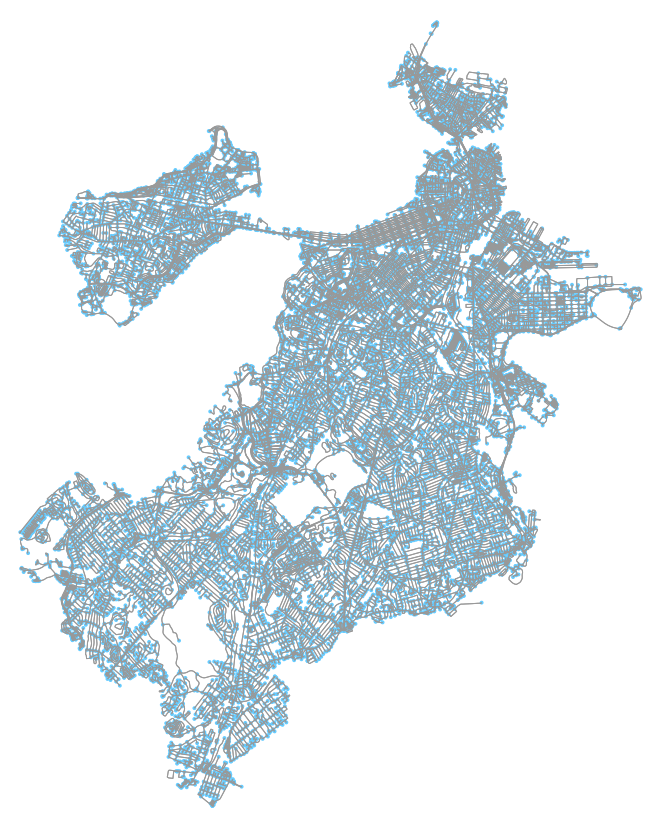

(<Figure size 1080x1080 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1a56aabb00>)

In [187]:
ox.plot_graph(Boston_G, fig_height=15, fig_width=15)

In [9]:
import pandas as pd
import geopandas as gpd
from geopandas import GeoDataFrame
from shapely.geometry import Point

pd_StreetLights = pd.read_csv('streetlight-locations.csv')
pd_StreetLights.columns
geo_StreetLights = gpd.GeoDataFrame(pd_StreetLights.drop(['the_geom', 'Lat', 'Long'], axis=1),
                             crs={'init': 'epsg:4326'}, # need to assign a CRS for CSV, CSV by default does not carry it
                             geometry=[Point(xy) for xy in zip(pd_StreetLights.Long, pd_StreetLights.Lat)])
geo_StreetLights.crs
geo_StreetLights_crs = geo_StreetLights.to_crs(epsg=3857)

In [ ]:
#!!!!!!!!!!! streetlight counting !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
#!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
geo_StreetLights = geo_StreetLights.to_crs(epsg=4327)
from multiprocessing import Pool
#Define a worker — a function which will be executed in parallel

output = {}
output[0] = {}
output[1] = {}
output[2] = {}
output[3] = {}

arg = [[0, output[0]], [1, output[1]], [2, output[2]], [3, output[3]]]

def worker(input):
    for idx in range(18516*input[0], 18516*(input[0]+1)):
        if idx%1000 == 0:
            print(idx)
        x = geo_StreetLights['geometry'][idx].coords.xy[0]
        y = geo_StreetLights['geometry'][idx].coords.xy[1]
        nearestedge = ox.get_nearest_edge(Boston_G, (y[0], x[0]))
        u, v = nearestedge[1], nearestedge[2]
        if (u,v) in input[1]:
            input[1][(u,v)]+=1
        else:
            input[1][(u,v)]=1
    return input[1]


#Assuming you want to use 3 processors
num_processors = 4

#Create a pool of processors
p=Pool(processes = num_processors)
#get them to work in parallel
out = p.map(worker, arg)
print(out)

0
56000
19000
38000
1000
57000
20000
39000
2000
58000
21000
40000
3000
59000
22000
41000
4000
60000
23000
42000
5000


In [56]:
import pickle
pfile0 = open('file0_ped_crash.pkl','rb')
pfile1 = open('file1_ped_crash.pkl','rb')
pfile2 = open('file2_ped_crash.pkl','rb')
pfile3 = open('file3_ped_crash.pkl','rb')

pedCrash0 = pickle.load(pfile0)
pedCrash1 = pickle.load(pfile1)
pedCrash2 = pickle.load(pfile2)
pedCrash3 = pickle.load(pfile3)

crashList = [pedCrash0, pedCrash1, pedCrash2, pedCrash3]

In [70]:
for u, v, d in Boston_G.edges(data=True):
    d['PED_Acci']=0
pd.set_option('display.max_rows', 100)

In [71]:
error_counter = 0
for outdata in crashList:
    for key in outdata.keys():
        print(key, outdata[key])
        u, v = key[0], key[1]
        try:
            prev_count = Boston_G[u][v][0]['PED_Acci']    
        except:
            print("No such node : ", u, v)
            error_counter+=1
            continue
        if prev_count != 0:
            Boston_G[u][v][0]['PED_Acci'] = prev_count + outdata[key]
        else:
            Boston_G[u][v][0]['PED_Acci'] = outdata[key]
print("error counter : ",error_counter)
# for u, v, d in Boston_G.edges(data=True):
#     print(u,v,d)

(3804354855, 3804355685) 16
(61351237, 61351242) 2
(2379615974, 1212905951) 1
(61340931, 61585008) 2
(61348072, 61339839) 1
(61366079, 5458851251) 3
(61340719, 1325873756) 1
(61395263, 61395256) 1
(2034744517, 61340557) 1
(1325750492, 5197357121) 1
(61483919, 61359036) 1
(61349680, 61517957) 1
(61346549, 6871056095) 2
(61341776, 6540279206) 2
(61355842, 61354707) 1
(61401955, 61346587) 1
(61344714, 61344757) 1
(61359570, 61359601) 1
(61349481, 61366921) 1
(5458202332, 61343981) 1
(61344297, 1173895492) 1
(1047228030, 6653188451) 1
(61341631, 61341633) 3
(61349536, 6932915167) 2
(61342462, 61342489) 1
(61357261, 2942071092) 1
(61342004, 61341998) 1
(61359394, 61357518) 1
(61358416, 61358408) 2
(369609669, 61341373) 1
(6881656152, 6881656165) 1
(61339341, 61339365) 1
(2576569536, 61398827) 1
(61340364, 61341159) 3
(61345489, 61358207) 1
(61552158, 6821229841) 1
(61351222, 6540279204) 1
(61487444, 61348549) 2
(61366559, 61366564) 1
(4786794330, 1294999086) 1
(6755842162, 61340200) 1
(6147

(4780597667, 61353690) 1
(61342765, 61428139) 1
(2981747633, 4084161284) 1
(61342520, 5843650387) 1
(61340476, 61518311) 1
(61436554, 2095827238) 1
(4687381718, 61471795) 1
(61357333, 61357518) 1
(61340455, 61340464) 1
(3181980877, 61357225) 1
(61562142, 2375727879) 1
(61365943, 61354567) 1
(61480366, 61358951) 1
(7136836430, 61355888) 1
(7044708129, 7044708128) 2
(61346752, 61370808) 1
(61348087, 3416364897) 1
(61341410, 61340621) 1
(61350131, 61349842) 1
(61388630, 61489434) 1
(7131544780, 61364086) 1
(61356574, 5164154357) 2
(61356466, 6758751904) 1
(61395126, 61355192) 2
(61356550, 61365243) 2
(61352686, 61348627) 1
(61344244, 61343555) 1
(61457024, 61457002) 1
(61340087, 61340085) 1
(61355547, 1097411869) 1
(61344706, 61365830) 4
(4953997841, 61339492) 1
(61367025, 61351140) 1
(61342666, 61342588) 1
(61352199, 61377509) 1
(61358565, 61401950) 1
(61347062, 61402210) 1
(61369347, 61347772) 1
(61351087, 61377701) 1
(5931597927, 1212879559) 1
(61486407, 61359815) 1
(61358681, 61393019

(2095791303, 61436571) 1
(1818197688, 1818197681) 3
(61340232, 61340213) 1
(61341942, 61341939) 1
(5674181675, 366656185) 1
(61339756, 3552626045) 1
(61355914, 61347250) 2
(4454612338, 61454016) 1
(61353101, 5845055138) 1
(61178875, 5674301641) 1
(61366709, 61345441) 1
(61356316, 61356326) 1
(61354289, 61377731) 1
(6461289504, 61367049) 1
(61378530, 61342130) 1
(3007948827, 3007948829) 1
(61342812, 6813074507) 1
(61359036, 61483919) 1
(61346903, 3641067492) 1
(61353825, 61389937) 1
(61404823, 6907933800) 1
(61342613, 61348346) 1
(61345592, 61345626) 1
(61347502, 61355346) 2
(61421327, 3416347386) 1
(61341436, 61355219) 1
(61339409, 61465023) 1
(61343340, 61356820) 2
(61340743, 6540742198) 1
(61343015, 61343024) 2
(61365198, 5458801330) 1
(61357824, 61357819) 2
(61490255, 61490171) 1
(61362934, 61363032) 1
(61374187, 61359425) 1
(61468847, 61341111) 1
(61344034, 61353653) 1
(61347789, 61509679) 2
(61351180, 61422331) 2
(61503308, 61341713) 1
(61356931, 61348734) 1
(61453118, 6869894503)

(61366094, 61355369) 1
(5835685715, 5835685719) 1
(3986523958, 61345019) 1
(5359733366, 7175238129) 1
(61346375, 61346379) 1
(61341183, 61340946) 1
(3267622950, 3267622982) 1
(61355412, 61370583) 1
(61518014, 61342546) 1
(4259274858, 5458830397) 1
(61347472, 61347509) 1
(6032975610, 61347502) 1
(61345519, 61386428) 1
(61349536, 6932915167) 1
(61370615, 61342775) 1
(61361452, 61361417) 1
(61342107, 4786793679) 2
(61354869, 61355232) 1
(61344924, 61459328) 1
(2680937276, 61364677) 1
(61342144, 61342083) 1
(2254061906, 5458426902) 1
(349355356, 61354119) 1
(61361159, 61482998) 1
(61343472, 61343470) 1
(7011704710, 5846548638) 1
(61346978, 61347220) 1
(61395155, 61355353) 1
(3005752035, 5853558851) 1
(61344074, 61342817) 1
(61343704, 61359129) 1
(61377750, 7153814709) 1
(61460626, 61483018) 1
(1989248085, 4454612335) 1
(61357786, 61357796) 1
(61365729, 6197076872) 1
(61339428, 61364633) 1
(61341882, 61341887) 1
(61350637, 7131544781) 1
(61495743, 61341044) 1
(61408714, 61378602) 1
(6136583

(61404679, 61366948) 1
(61344338, 61343203) 1
(61341939, 61501972) 1
(61342912, 61350419) 1
(5850683639, 61352845) 1
(61344698, 61344930) 1
(61485284, 61486140) 1
(61346082, 61346114) 1
(61361428, 61361420) 1
(61344407, 61344397) 1
(61344295, 61519484) 1
(61344593, 61344594) 1
(61593704, 61593704) 2
(61436554, 2095827238) 2
(6185148332, 61370573) 1
(61340689, 61340652) 1
(61512887, 61352094) 1
(5458236741, 61341559) 1
(61388334, 61355447) 1
(61344086, 61344757) 1
(61353455, 61353453) 1
(61349979, 61489649) 1
(61559036, 61344766) 1
(4953873516, 61371034) 1
(61349036, 3181981238) 1
(5983183477, 6574812158) 2
(61365917, 61365918) 1
(61360721, 61360723) 1
(61342012, 61342016) 1
(61339683, 61388147) 2
(61461172, 61468627) 1
(61412851, 61344902) 1
(61365898, 61365903) 1
(4687378987, 61342491) 2
(61345357, 61356813) 1
(5599241984, 61457057) 1
(61353173, 61353169) 1
(61360781, 61360787) 1
(61358013, 61558892) 2
(61342449, 5757114649) 1
(61347263, 61347265) 1
(61361676, 61482721) 2
(61463265, 6

(4687335559, 61355935) 1
(61347512, 61346274) 1
(61377150, 61510892) 1
(61342992, 61345002) 2
(61353201, 61353204) 1
(61342274, 61342276) 1
(61340764, 61340766) 1
(61392238, 61339492) 1
(61342263, 61342193) 1
(1527825822, 1527825852) 2
(6758925550, 6758925556) 1
(5456546026, 5456546029) 1
(61343337, 61343288) 1
(4776915549, 61377248) 2
(7081950440, 61347479) 1
(61339341, 61365918) 2
(61395126, 61355192) 1
(61369428, 61369431) 1
(61369725, 61369738) 1
(61346933, 61467223) 1
(61343383, 61343350) 1
(7044708129, 7044708135) 1
(61468847, 61341088) 1
(3518393251, 61455356) 1
(6869654083, 61342622) 1
(6757312625, 61357331) 1
(61341725, 61385322) 1
(2296986603, 61339396) 1
(61350425, 61350421) 2
(61345687, 61346867) 1
(61350515, 61360932) 1
(61349785, 5458730193) 1
(61371318, 5674261584) 1
(7013443901, 61351109) 1
(61344179, 7069271395) 1
(61350409, 61350736) 1
(61371418, 61433610) 1
(61353862, 61351248) 1
(7171234904, 61374140) 2
(61354543, 61354570) 1
(61341133, 4066100005) 1
(4780054438, 67

(3007948823, 3007948827) 1
(61353323, 61358469) 1
(61351006, 61347952) 1
(61361384, 61361728) 1
(61341689, 61341319) 1
(61471919, 61347637) 1
(61343513, 61343526) 1
(61410564, 61358838) 1
(61350702, 61353101) 1
(61518404, 61340424) 1
(61517969, 61514451) 1
(61404721, 61404712) 1
(61344585, 61366689) 1
(61347017, 61347019) 1
(61479634, 61354477) 1
(61355305, 61407655) 1
(61344816, 61344815) 1
(61356005, 5860206623) 1
(61341998, 6759743584) 1
(3157293979, 3157293982) 1
(4080486546, 61341207) 1
(61347486, 61461306) 1
(61343261, 61343303) 1
(61410578, 1038001167) 1
(61341048, 61341035) 1
(61344690, 4562921527) 1
(61355233, 61355234) 1
(61354678, 5674166795) 1
(61358756, 61365535) 1
(61347687, 5459249196) 1
(61490377, 3267027542) 1
(6863847636, 61354255) 1
(5197357129, 61342821) 1
(61366649, 61386428) 1
(61345134, 61345096) 1
(4876445391, 4876448954) 1
error counter :  4


In [72]:
len(Boston_G)

24586

In [73]:
SL_pickle_list = []
for idx in range(0,32):
    pfile = open('file'+str(idx)+'.pkl','rb')
    pedCrash = pickle.load(pfile)
    SL_pickle_list.append(pedCrash)

In [76]:
for u, v, d in Boston_G.edges(data=True):
    d['SL_Count']=0

In [77]:
error_counter = 0
for outdata in SL_pickle_list:
    for key in outdata.keys():
        u, v = key[0], key[1]        
        try:
            prev_count = Boston_G[u][v][0]['SL_Count']    
        except:
            print("No such node : ", u, v)
            error_counter+=1
            continue        
        if prev_count != 0:
            Boston_G[u][v][0]['SL_Count'] = prev_count + outdata[key]
        else:
            Boston_G[u][v][0]['SL_Count'] = outdata[key]

# for u, v, d in Boston_G.edges(data=True):
#     print(u,v,d)

No such node :  61341944 61340944
No such node :  61342333 61342334
No such node :  61341702 61502791
No such node :  61346545 61461656
No such node :  61461656 61346545
No such node :  61360862 61360883
No such node :  61484158 2251797876
No such node :  2251797876 61484158
No such node :  6757276918 5458554779
No such node :  5458554792 5458554795
No such node :  5458554795 5458554792
No such node :  61360883 61360862
No such node :  5458554779 6757276918
No such node :  5458554785 1192149775
No such node :  1192149775 5458554785
No such node :  61341944 61340944


In [33]:
Para = 
for u, v, d in Boston_G.edges(data=True):
    d['length_SL_density'] = (1-Para)*d['length']+Para*d['length']/(d['SL_Count']+1)

2254130937 61343470


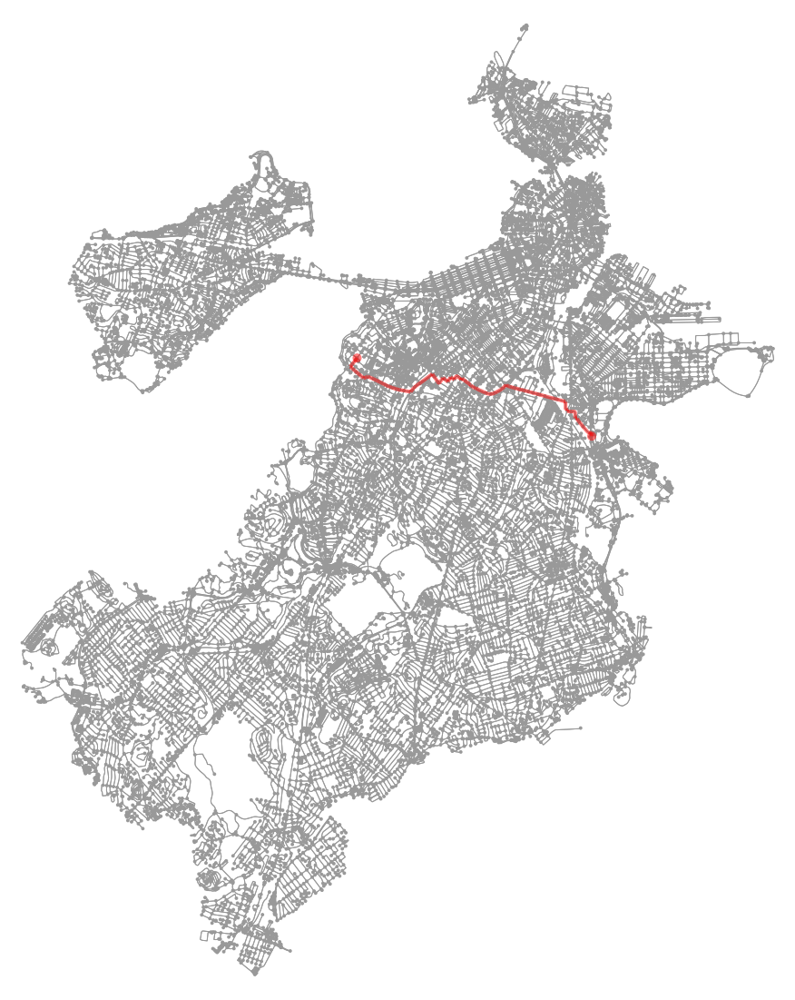

total Dist 6144.959    total Street Light Count 248    total Ped Accident Count 78


In [45]:
import numpy as np
import networkx as nx
# from random import choice
rnode1 = np.random.choice(Boston_G.nodes())
rnode2 = np.random.choice(Boston_G.nodes())
print(rnode1, rnode2)

# rnode1=4776915546
# rnode2=7131544784
# node1=3596389170
# node2=5991355031
dijik_route = nx.shortest_path(Boston_G, rnode1, rnode2, weight='length_SL_density')
ox.plot_graph_route(Boston_G, dijik_route, fig_height=20, fig_width=20)

# print("path length : ",nx.shortest_path_length(G_test_temp_test, rnode1, rnode2, weight='length_SL_density'))

u = dijik_route[0]
totalDist=0
totalSL=0
totalAcci=0
for v in dijik_route[1:]:
    totalDist += Boston_G[u][v][0]['length']
    totalSL += Boston_G[u][v][0]['SL_Count']
    totalAcci += Boston_G[u][v][0]['PED_Acci']    
    u = v
print("total Dist", totalDist, "   total Street Light Count", totalSL, "   total Ped Accident Count", totalAcci)

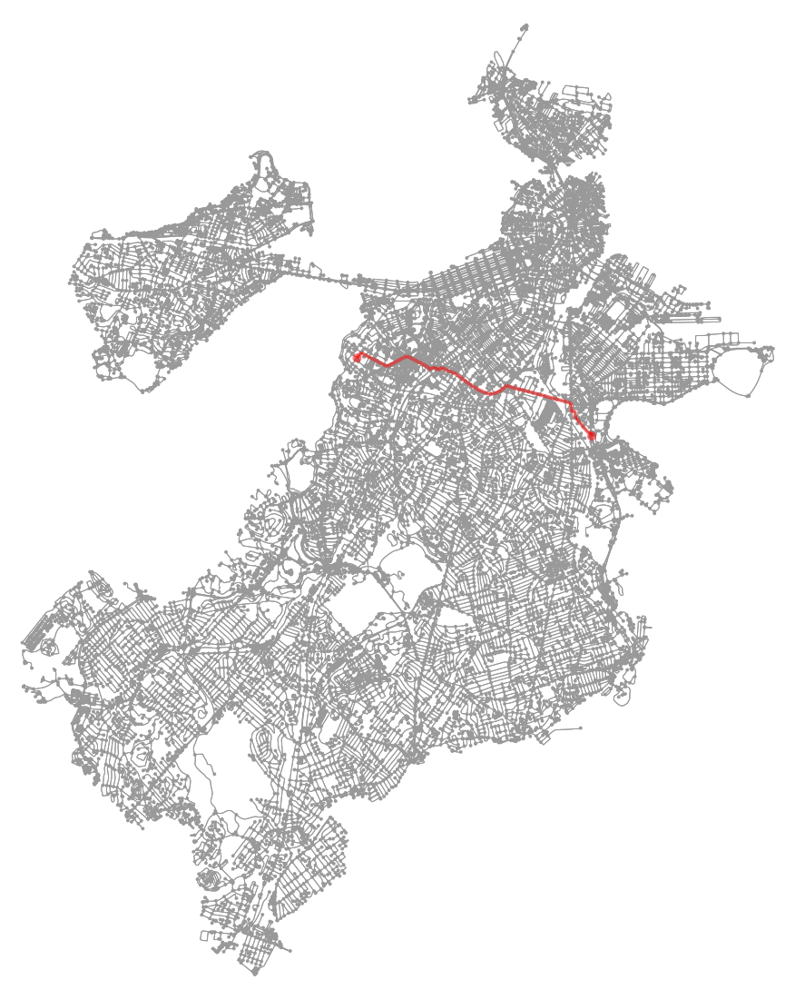

total Dist 5571.863000000003    total Street Light Count 144    total Ped Accident Count 105


In [46]:
dijik_route = nx.dijkstra_path(Boston_G, rnode1, rnode2, weight='length')
ox.plot_graph_route(Boston_G, dijik_route, fig_height=20, fig_width=20)

u = dijik_route[0]
totalDist=0
totalSL=0
totalAcci=0
for v in dijik_route[1:]:
    totalDist += Boston_G[u][v][0]['length']
    totalSL += Boston_G[u][v][0]['SL_Count']
    totalAcci += Boston_G[u][v][0]['PED_Acci']    
    u = v
print("total Dist", totalDist, "   total Street Light Count", totalSL, "   total Ped Accident Count", totalAcci)

In [42]:
Para = 0.9999999
for u, v, d in Boston_G.edges(data=True):
    d['length_PedAcci'] = (1-Para)*d['length']+Para*d['length']*(d['PED_Acci']+1)

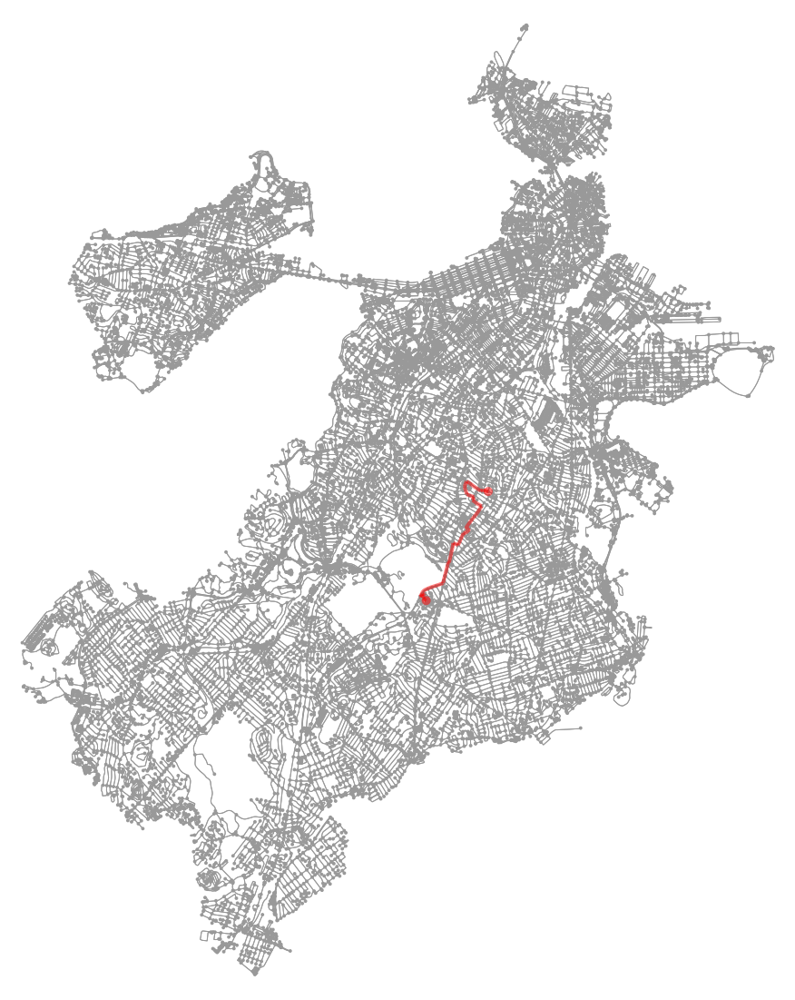

total Dist 3871.3129999999996    total Street Light Count 70    total Ped Accident Count 0


In [278]:
dijik_route = nx.dijkstra_path(Boston_G, rnode1, rnode2, weight='PED_Acci')
ox.plot_graph_route(Boston_G, dijik_route, fig_height=20, fig_width=20)

u = dijik_route[0]
totalDist=0
totalSL=0
totalAcci=0
for v in dijik_route[1:]:
    totalDist += Boston_G[u][v][0]['length']
    totalSL += Boston_G[u][v][0]['SL_Count']
    totalAcci += Boston_G[u][v][0]['PED_Acci']
    u = v
print("total Dist", totalDist, "   total Street Light Count", totalSL, "   total Ped Accident Count", totalAcci)

In [48]:
nx.write_gpickle(Boston_G, "BostonGraph_Total.gpickle")

In [279]:
for idx in range(0, len(dijik_route)):
    print("["+str(Boston_G.nodes[dijik_route[idx]]['x'])+","+str(Boston_G.nodes[dijik_route[idx]]['y'])+"],")

[-71.076391,42.314171],
[-71.077542,42.31441],
[-71.0776041,42.3142886],
[-71.0781111,42.3144091],
[-71.0782101,42.3142938],
[-71.078823,42.314608],
[-71.080571,42.3155233],
[-71.080998,42.315755],
[-71.081443,42.315923],
[-71.08193,42.314987],
[-71.08138,42.313676],
[-71.080766,42.313496],
[-71.079683,42.313219],
[-71.080088,42.312691],
[-71.079447,42.312343],
[-71.077927,42.311629],
[-71.078526,42.310965],
[-71.078793,42.310661],
[-71.078979,42.310456],
[-71.079585,42.30988],
[-71.080268,42.309258],
[-71.0807744,42.3087513],
[-71.081283,42.308242],
[-71.0814075,42.3081091],
[-71.0821198,42.3068518],
[-71.0821958,42.3069304],
[-71.082363,42.306688],
[-71.0827283,42.3060819],
[-71.0830818,42.3054823],
[-71.083477,42.304854],
[-71.0845965,42.3052535],
[-71.0850566,42.3035041],
[-71.0850865,42.3033961],
[-71.0852424,42.3029026],
[-71.0855764,42.3018738],
[-71.0857489,42.3019426],
[-71.0859328,42.3013699],
[-71.0865601,42.2995651],
[-71.0868473,42.2987478],
[-71.086984,42.2983067],
[-71.0

In [49]:
Para = 0.8
for u, v, d in Boston_G.edges(data=True):
    d['length_Optimized'] = (1-Para)*d['length']+Para*d['length']*(d['PED_Acci']+1)+Para*d['length']/(d['SL_Count']+1)

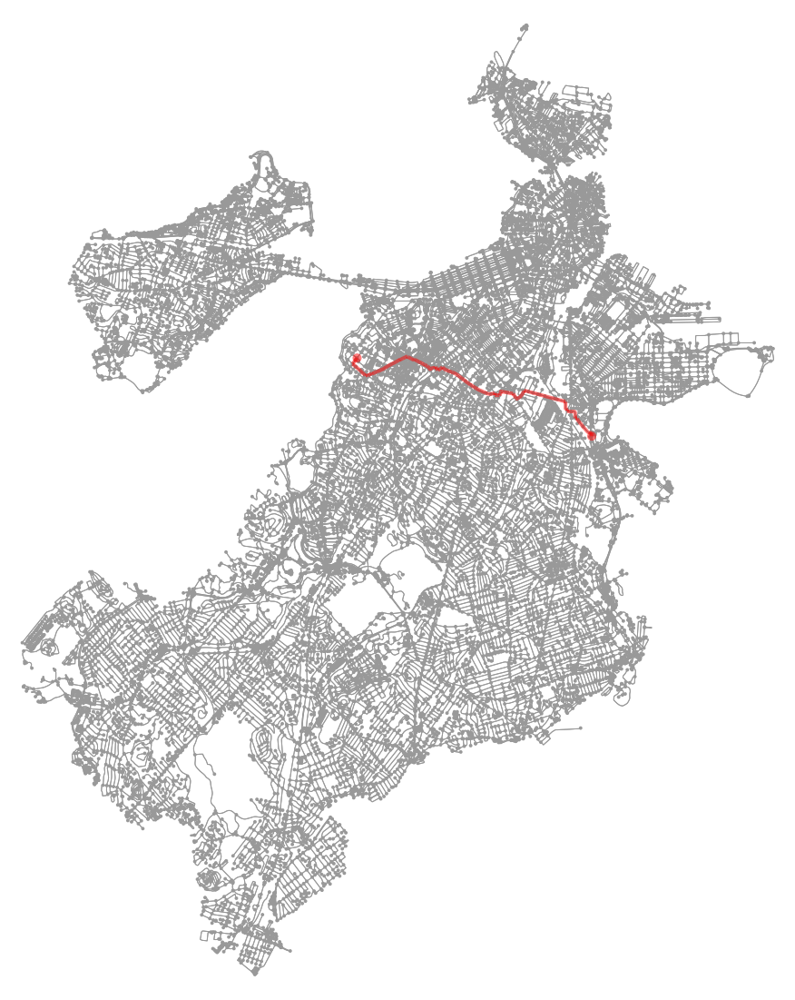

total Dist 6039.695999999999    total Street Light Count 182    total Ped Accident Count 0


In [50]:
dijik_route = nx.dijkstra_path(Boston_G, rnode1, rnode2, weight='length_Optimized')
ox.plot_graph_route(Boston_G, dijik_route, fig_height=20, fig_width=20)

u = dijik_route[0]
totalDist=0
totalSL=0
totalAcci=0
for v in dijik_route[1:]:
    totalDist += Boston_G[u][v][0]['length']
    totalSL += Boston_G[u][v][0]['SL_Count']
    totalAcci += Boston_G[u][v][0]['PED_Acci']
    u = v
print("total Dist", totalDist, "   total Street Light Count", totalSL, "   total Ped Accident Count", totalAcci)

In [78]:
Crime_pickle_list = []
for idx in range(0,32):
    pfile = open('file'+str(idx)+'_crime.pkl','rb')
    crime = pickle.load(pfile)
    Crime_pickle_list.append(crime)

In [82]:
for u, v, d in Boston_G.edges(data=True):
    d['Crime_Count']=0

In [83]:
error_counter = 0
for outdata in Crime_pickle_list:
    for key in outdata.keys():
        u, v = key[0], key[1]        
        try:        
            prev_count = Boston_G[u][v][0]['Crime_Count']    
        except:
            print("No such node : ", u, v)
            error_counter+=1
            continue
        if prev_count != 0:
            Boston_G[u][v][0]['Crime_Count'] = prev_count + outdata[key]
        else:
            Boston_G[u][v][0]['Crime_Count'] = outdata[key]
print("error counter : ",error_counter)

No such node :  1192149775 5458554785
No such node :  1192149775 5458554785
No such node :  61342333 61342334
No such node :  61341944 61340944
No such node :  61341944 61340944
No such node :  61502791 61341702
No such node :  61341944 61340944
No such node :  1192149775 5458554785
No such node :  61360862 61360883
No such node :  61341944 61340944
No such node :  61341944 61340944
No such node :  61341944 61340944
No such node :  61341944 61340944
No such node :  61346545 61461656
No such node :  61341944 61340944
No such node :  61341944 61340944
No such node :  61342333 61342334
No such node :  61341944 61340944
No such node :  1192149775 5458554785
No such node :  61341944 61340944
No such node :  61341944 61340944
No such node :  61341944 61340944
No such node :  61340944 61341944
No such node :  1192149775 5458554785
No such node :  61341944 61340944
No such node :  61341944 61340944
No such node :  61340944 61341944
No such node :  61346545 61461656
No such node :  61341944 613

In [237]:
for u, v, d in Boston_G.edges(data=True):
    d['length_1']    = d['length']*((1/(1+a))*(a+1/(1+d['SL_Count']))+b*(d['Crime_Count']+d['PED_Acci']))

    d['length_0p2_Crime']      = 0.2*d['length']*(d['Crime_Count'])+0.8*d['length']
    d['length_0p2_SL_density'] = 0.2*d['length']/(d['SL_Count']+1)+0.8*d['length']
    
    d['length_0p5_PedAcci']    = 0.5*d['length']*(d['PED_Acci']+1)
    d['length_0p5_Crime']      = 0.5*d['length']*(d['Crime_Count']+1)
    d['length_0p5_SL_density'] = 0.5*d['length']/(d['SL_Count']+1)+0.5*d['length']

    d['length_0p8_PedAcci']    = 0.8*d['length']*(d['PED_Acci'])+0.2*d['length']
    d['length_0p8_Crime']      = 0.8*d['length']*(d['Crime_Count'])+0.2*d['length']
    d['length_0p8_SL_density'] = 0.8*d['length']/(d['SL_Count']+1)+0.2*d['length']
    
    d['length_1p0_PedAcci']    = d['length']*(d['PED_Acci'])
    d['length_1p0_Crime']      = d['length']*(d['Crime_Count'])
    d['length_1p0_SL_density'] = d['length']/(d['SL_Count']+1)


In [238]:
nx.write_gpickle(Boston_G, "BostonGraph_Validation.gpickle")

In [90]:
Gtest = nx.read_gpickle("BostonGraph_Final.gpickle")
for u, v, d in Gtest.edges(data=True):
    print(u,v,d)


61341696 61341267 {'osmid': 8652528, 'oneway': False, 'lanes': '2', 'name': 'Park Plaza', 'highway': 'secondary', 'width': '29.9', 'length': 44.954, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 22, 'length_PedAcci': 44.954, 'length_Crime': 1033.942, 'length_SL_density': 44.954}
61341696 4779725263 {'osmid': 426831017, 'lanes': '2', 'name': 'Columbus Avenue', 'highway': 'residential', 'width': '23.8', 'oneway': False, 'length': 7.915, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 7.915, 'length_Crime': 7.915, 'length_SL_density': 7.915}
61341696 4779725246 {'osmid': 8651073, 'oneway': False, 'lanes': '2', 'name': 'Park Plaza', 'highway': 'secondary', 'width': '21.3', 'length': 19.073, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a34d950f0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 19.073, 'length_Crime': 19.073, 'length_SL_density': 19.073}
61341697 61342333 {'osmid': 8640801, 'oneway': False, 'lanes': '1', 'name': 'Glenvi

61341914 4040978896 {'osmid': 8647061, 'lanes': '2', 'name': 'Elm Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 66.811, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 66.811, 'length_Crime': 66.811, 'length_SL_density': 22.270333333333337}
61341914 61341826 {'osmid': 8642068, 'lanes': '2', 'name': 'Newbern Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'oneway': False, 'length': 54.01, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a34d7c080>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 54.01, 'length_Crime': 54.01, 'length_SL_density': 54.01}
61341914 61504350 {'osmid': 8647061, 'lanes': '2', 'name': 'Elm Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 163.48499999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a34d7c240>, 'PED_Acci': 0, 'SL_Count': 5, 'Crime_Count': 2, 

61604278 4776915599 {'osmid': 426488940, 'oneway': False, 'lanes': '3', 'name': 'Atlantic Avenue', 'highway': 'primary', 'length': 8.664, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 8.664, 'length_Crime': 8.664, 'length_SL_density': 8.664}
61604278 4776915550 {'osmid': 426488940, 'oneway': False, 'lanes': '3', 'name': 'Atlantic Avenue', 'highway': 'primary', 'length': 8.691, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 8.691, 'length_Crime': 8.691, 'length_SL_density': 8.691}
61342143 61352738 {'osmid': 8649991, 'oneway': False, 'lanes': '2', 'name': 'Marginal Road', 'highway': 'secondary', 'width': '14.9', 'length': 40.502, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 40.502, 'length_Crime': 40.502, 'length_SL_density': 20.251}
61342143 61342384 {'osmid': 8649991, 'oneway': False, 'lanes': '2', 'name': 'Marginal Road', 'highway': 'secondary', 'width': '14.9', 'length': 54.934, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 

61342520 5843650387 {'osmid': 533595683, 'lanes': '4', 'name': 'Boylston Street', 'highway': 'secondary', 'width': '33.5', 'oneway': False, 'length': 29.733, 'PED_Acci': 1, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 59.466, 'length_Crime': 29.733, 'length_SL_density': 9.911}
61342520 2491737952 {'osmid': 8644518, 'lanes': '2', 'name': 'Ipswich Street', 'highway': 'tertiary', 'width': '24.4', 'oneway': False, 'length': 73.913, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a39b28940>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 73.913, 'length_Crime': 73.913, 'length_SL_density': 24.637666666666664}
61342527 61382755 {'osmid': 8649404, 'lanes': '2', 'name': 'Monastery Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 61.209999999999994, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a39b28860>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 61.20999999999

61342901 61342246 {'osmid': 8646228, 'lanes': '2', 'name': 'Allston Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '10.7', 'oneway': False, 'length': 30.034, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 30.034, 'length_Crime': 30.034, 'length_SL_density': 30.034}
61342901 61342899 {'osmid': 8646228, 'lanes': '2', 'name': 'Allston Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '10.7', 'oneway': False, 'length': 31.392, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 1, 'length_PedAcci': 31.392, 'length_Crime': 62.784, 'length_SL_density': 31.392}
61342901 6546611279 {'osmid': 578464757, 'oneway': False, 'lanes': '1', 'name': 'Bellvista Road', 'highway': 'residential', 'width': '10.4', 'length': 98.90299999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3350c278>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 5, 'length_PedAcci': 98.90299999999999, 'length_Crime': 593.4179999999999, 'length_SL_density': 49.4514999

61343140 61340370 {'osmid': 8648713, 'oneway': False, 'lanes': '1', 'name': 'Boylston Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'length': 71.374, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a335450f0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 71.374, 'length_Crime': 71.374, 'length_SL_density': 71.374}
61343140 61340850 {'osmid': 8648713, 'oneway': False, 'lanes': '1', 'name': 'Boylston Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'length': 97.694, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a33545080>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 97.694, 'length_Crime': 97.694, 'length_SL_density': 97.694}
61343140 61343162 {'osmid': 8651738, 'oneway': False, 'lanes': '2', 'name': 'Brookside Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 94.28099999999999, 'geometry': <shapely.geometry.linestring.LineS

61343379 61485119 {'osmid': 8640926, 'oneway': False, 'lanes': '1', 'name': 'C Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'length': 82.644, 'PED_Acci': 0, 'SL_Count': 4, 'Crime_Count': 0, 'length_PedAcci': 82.644, 'length_Crime': 82.644, 'length_SL_density': 16.5288}
61343379 61356435 {'osmid': 8645731, 'oneway': False, 'lanes': '2', 'name': 'C Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'length': 98.345, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 1, 'length_PedAcci': 98.345, 'length_Crime': 196.69, 'length_SL_density': 98.345}
61343379 61343232 {'osmid': 426460373, 'lanes': '2', 'name': 'West First Street', 'highway': 'secondary', 'width': '15.2', 'oneway': False, 'length': 168.542, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 2, 'length_PedAcci': 168.542, 'length_Crime': 505.626, 'length_SL_density': 42.1355}
61343379 6755836288 {'osmid': 426460373, 'lanes': '2', 'name': 'West First Street', 'highway': 'secondary', 'width

61343797 61343770 {'osmid': 8650382, 'oneway': False, 'lanes': '1', 'name': 'Maybrook Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 129.192, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 129.192, 'length_Crime': 129.192, 'length_SL_density': 64.596}
61343797 61359593 {'osmid': 8648313, 'oneway': False, 'lanes': '1', 'name': 'Greenwood Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 72.532, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40c98828>, 'PED_Acci': 1, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 145.064, 'length_Crime': 72.532, 'length_SL_density': 72.532}
61540407 61542219 {'osmid': 8643654, 'oneway': False, 'highway': 'trunk_link', 'maxspeed': '25 mph', 'junction': 'jughandle', 'length': 38.388, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40c98940>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 38.388, 'length_Crime

61344194 61348073 {'osmid': 8640637, 'lanes': '2', 'name': 'Brentwood Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 142.379, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 1, 'length_PedAcci': 142.379, 'length_Crime': 284.758, 'length_SL_density': 142.379}
61344194 3522553299 {'osmid': 8640637, 'lanes': '2', 'name': 'Brentwood Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 86.35, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 86.35, 'length_Crime': 86.35, 'length_SL_density': 86.35}
61344194 61466779 {'osmid': 200985803, 'oneway': False, 'lanes': '1', 'name': 'Athol Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.4', 'length': 128.562, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 3, 'length_PedAcci': 128.562, 'length_Crime': 514.248, 'length_SL_density': 128.562}
61344194 61340550 {'osmid': 8648346, 'lanes': '2', 'name': 'Athol Street', 'hi

61344399 61344394 {'osmid': 28615836, 'lanes': '2', 'name': 'E Street', 'highway': 'tertiary', 'width': '14.9', 'oneway': False, 'length': 39.417, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 39.417, 'length_Crime': 39.417, 'length_SL_density': 39.417}
61344399 61344338 {'osmid': 28615836, 'lanes': '2', 'name': 'E Street', 'highway': 'tertiary', 'width': '14.9', 'oneway': False, 'length': 43.001, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 43.001, 'length_Crime': 43.001, 'length_SL_density': 43.001}
6143675027 61365396 {'osmid': 8644786, 'lanes': '2', 'name': 'Stimson Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 11.734, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 11.734, 'length_Crime': 11.734, 'length_SL_density': 11.734}
6143675027 61403016 {'osmid': 8652580, 'oneway': False, 'lanes': '3', 'name': 'Washington Street', 'highway': 'secondary', 'width': '30.2', 'length': 7.743, 'PED_Acci':

5709630412 5709630406 {'osmid': 600452686, 'highway': 'footway', 'oneway': False, 'length': 300.69800000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41137be0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 300.69800000000004, 'length_Crime': 300.69800000000004, 'length_SL_density': 300.69800000000004}
61344719 61344714 {'osmid': 8648471, 'lanes': '2', 'name': 'East Fifth Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.9', 'oneway': False, 'length': 168.117, 'PED_Acci': 0, 'SL_Count': 5, 'Crime_Count': 0, 'length_PedAcci': 168.117, 'length_Crime': 168.117, 'length_SL_density': 28.019499999999997}
61344719 61347851 {'osmid': 8648471, 'lanes': '2', 'name': 'East Fifth Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.9', 'oneway': False, 'length': 124.614, 'PED_Acci': 0, 'SL_Count': 9, 'Crime_Count': 3, 'length_PedAcci': 124.614, 'length_Crime': 498.456, 'length_SL_density': 12.461400000000001}
6134

61345053 6776988162 {'osmid': 8643878, 'lanes': '2', 'name': 'Columbia Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '24.4', 'oneway': False, 'length': 45.44, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 45.44, 'length_Crime': 45.44, 'length_SL_density': 22.72}
61345053 5458774427 {'osmid': 435486112, 'lanes': '2', 'name': 'Covington Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '13.7', 'oneway': False, 'length': 56.383, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 56.383, 'length_Crime': 56.383, 'length_SL_density': 56.383}
61345055 61345049 {'osmid': 8639598, 'oneway': False, 'lanes': '1', 'name': 'Hillside Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 67.604, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 67.604, 'length_Crime': 67.604, 'length_SL_density': 33.802}
61345055 7082360371 {'osmid': 8639598, 'oneway': False, 'lanes': '1', 'name': 'Hills

3990568344 6540742190 {'osmid': 396258228, 'highway': 'footway', 'oneway': False, 'length': 7.915, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 7.915, 'length_Crime': 7.915, 'length_SL_density': 7.915}
3990568344 6540728581 {'osmid': 396258228, 'highway': 'footway', 'oneway': False, 'length': 10.287, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 10.287, 'length_Crime': 10.287, 'length_SL_density': 10.287}
3990568344 3990568354 {'osmid': 696501095, 'highway': 'footway', 'oneway': False, 'length': 169.077, 'PED_Acci': 0, 'SL_Count': 9, 'Crime_Count': 0, 'length_PedAcci': 169.077, 'length_Crime': 169.077, 'length_SL_density': 16.9077}
3990568344 6540728543 {'osmid': 696501104, 'highway': 'footway', 'oneway': False, 'length': 38.984, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 38.984, 'length_Crime': 38.984, 'length_SL_density': 9.746}
61410798 2378746951 {'osmid': 8646294, 'oneway': False, 'lanes': '1', 'name': 'Wigglesworth S

2501119769 5599241977 {'osmid': 396258214, 'highway': 'footway', 'oneway': False, 'length': 7.533, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 7.533, 'length_Crime': 7.533, 'length_SL_density': 7.533}
2501119769 2500921856 {'osmid': 8651704, 'oneway': False, 'lanes': '2', 'name': 'Stuart Street', 'highway': 'secondary', 'width': '20.7', 'length': 17.595, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a413d5978>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 17.595, 'length_Crime': 17.595, 'length_SL_density': 17.595}
2501119769 2500921856 {'osmid': 396258214, 'highway': 'footway', 'oneway': False, 'length': 24.275, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a413d5908>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 24.275, 'length_Crime': 24.275, 'length_SL_density': 24.275}
2501119769 2501119764 {'osmid': 8651704, 'oneway': False, 'lanes': '2', 'name': 'Stuart Street', 'highway': 'seco

61345829 61345420 {'osmid': 8649775, 'lanes': '2', 'name': 'Preble Street', 'highway': 'secondary', 'width': '21.0', 'oneway': False, 'length': 38.446, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a414030b8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 38.446, 'length_Crime': 38.446, 'length_SL_density': 38.446}
61345829 6011042829 {'osmid': 8649775, 'lanes': '2', 'name': 'Preble Street', 'highway': 'secondary', 'width': '21.0', 'oneway': False, 'length': 37.583, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41403358>, 'PED_Acci': 2, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 112.749, 'length_Crime': 37.583, 'length_SL_density': 18.7915}
61345829 61345834 {'osmid': 8651095, 'lanes': '1', 'name': 'Wendeller Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.6', 'oneway': False, 'length': 70.33500000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a414032b0>, 'PED_Acci': 0, 'SL

61346145 61364848 {'osmid': 41937137, 'oneway': False, 'lanes': '2', 'name': 'Jamaicaway', 'highway': 'primary', 'maxspeed': '30 mph', 'width': '30.2', 'length': 62.70100000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a414281d0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 62.70100000000001, 'length_Crime': 62.70100000000001, 'length_SL_density': 62.70100000000001}
61346145 61346063 {'osmid': 168353947, 'lanes': '4', 'name': 'Jamaicaway', 'highway': 'primary', 'maxspeed': '30 mph', 'width': '30.2', 'oneway': False, 'length': 630.735, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41428160>, 'PED_Acci': 1, 'SL_Count': 6, 'Crime_Count': 0, 'length_PedAcci': 1261.47, 'length_Crime': 630.735, 'length_SL_density': 90.105}
1184043363 61477876 {'osmid': 294582917, 'oneway': False, 'lanes': '1', 'name': 'Albany Street', 'highway': 'tertiary', 'width': '24.4', 'length': 63.442, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 2, '

61346416 61590572 {'osmid': 8637594, 'lanes': '2', 'name': 'Estey Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 33.12, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41501f60>, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 33.12, 'length_Crime': 33.12, 'length_SL_density': 8.28}
61346416 61346498 {'osmid': 8649751, 'lanes': '2', 'name': 'Fisher Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 76.281, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4150d1d0>, 'PED_Acci': 0, 'SL_Count': 4, 'Crime_Count': 2, 'length_PedAcci': 76.281, 'length_Crime': 228.84300000000002, 'length_SL_density': 15.256200000000002}
61346416 61399036 {'osmid': 8649751, 'lanes': '2', 'name': 'Fisher Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 302.836, 'geometry': <shapely.geometry.linestring.Line

61346727 61462876 {'osmid': 435202581, 'oneway': False, 'lanes': '1', 'name': 'Eustis Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 224.134, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4152c358>, 'PED_Acci': 1, 'SL_Count': 9, 'Crime_Count': 19, 'length_PedAcci': 448.268, 'length_Crime': 4482.679999999999, 'length_SL_density': 22.4134}
61346728 61346730 {'osmid': 8650247, 'lanes': '2', 'name': 'Norfolk Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'oneway': False, 'length': 14.993, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 14.993, 'length_Crime': 14.993, 'length_SL_density': 14.993}
61346728 61343174 {'osmid': 8650247, 'lanes': '2', 'name': 'Norfolk Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'oneway': False, 'length': 68.695, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 68.695, 'length_Crime': 68.695, 'length_SL_density': 68.

6542726496 5674180974 {'osmid': 86479790, 'oneway': False, 'lanes': '2', 'ref': 'MA 2', 'name': 'Commonwealth Avenue', 'highway': 'primary', 'width': '59.1', 'length': 159.115, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 16, 'length_PedAcci': 159.115, 'length_Crime': 2704.955, 'length_SL_density': 53.038333333333334}
6542726496 6542726508 {'osmid': 696702123, 'highway': 'footway', 'oneway': False, 'length': 10.378, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 10.378, 'length_Crime': 10.378, 'length_SL_density': 10.378}
6542726496 6542726516 {'osmid': 696702123, 'highway': 'footway', 'oneway': False, 'length': 6.273, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 6.273, 'length_Crime': 6.273, 'length_SL_density': 3.1365}
6542726497 366656185 {'osmid': 591236214, 'oneway': False, 'lanes': '3', 'ref': 'MA 2', 'name': 'Commonwealth Avenue', 'highway': 'primary', 'width': '59.1', 'length': 3.519, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'lengt

5543761429 4748670387 {'osmid': 8641795, 'highway': 'residential', 'maxspeed': '25 mph', 'oneway': False, 'length': 7.638, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 7.638, 'length_Crime': 7.638, 'length_SL_density': 7.638}
5543761429 5543761430 {'osmid': 578641724, 'highway': 'footway', 'oneway': False, 'length': 6.694, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 6.694, 'length_Crime': 6.694, 'length_SL_density': 6.694}
5543761429 5543761428 {'osmid': 578641724, 'highway': 'footway', 'oneway': False, 'length': 9.083, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 9.083, 'length_Crime': 9.083, 'length_SL_density': 9.083}
5543761429 61402496 {'osmid': [8641802, 8641795], 'highway': 'residential', 'maxspeed': '25 mph', 'oneway': False, 'length': 162.024, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a414f5208>, 'PED_Acci': 0, 'SL_Count': 4, 'Crime_Count': 0, 'length_PedAcci': 162.024, 'length_Crime': 162.0

61347637 61471919 {'osmid': 279666895, 'lanes': '2', 'name': 'Blue Hill Avenue', 'highway': 'tertiary', 'width': '18.3', 'oneway': False, 'length': 37.191, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4179b828>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 37.191, 'length_Crime': 37.191, 'length_SL_density': 18.5955}
61347639 61340094 {'osmid': 279666895, 'lanes': '2', 'name': 'Blue Hill Avenue', 'highway': 'tertiary', 'width': '18.3', 'oneway': False, 'length': 38.728, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 24, 'length_PedAcci': 38.728, 'length_Crime': 968.2, 'length_SL_density': 12.909333333333334}
61347639 61365592 {'osmid': 8650601, 'oneway': False, 'lanes': '1', 'name': 'Maywood Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 311.07699999999994, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4179ba58>, 'PED_Acci': 1, 'SL_Count': 12, 'Crime_Count': 24, 'length_PedAcci': 622.153999

61347912 5951269202 {'osmid': 591278038, 'lanes': '2', 'name': 'Corey Street', 'highway': 'tertiary', 'width': '12.8', 'oneway': False, 'length': 64.63, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41818a20>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 64.63, 'length_Crime': 64.63, 'length_SL_density': 64.63}
61347912 61410465 {'osmid': 591278038, 'lanes': '2', 'name': 'Corey Street', 'highway': 'tertiary', 'width': '12.8', 'oneway': False, 'length': 209.554, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a418189e8>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 209.554, 'length_Crime': 209.554, 'length_SL_density': 69.85133333333333}
61347912 6189015600 {'osmid': 661061534, 'lanes': '1', 'name': 'Henshaw Terrace', 'highway': 'residential', 'width': '6.1', 'oneway': False, 'length': 62.047000000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41818cc0>, 'PED_Acci': 0, 'SL_Count': 0

61348217 61353941 {'osmid': 8652155, 'lanes': '2', 'name': 'Oriole Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 137.584, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a418603c8>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 137.584, 'length_Crime': 137.584, 'length_SL_density': 45.861333333333334}
61348217 61348212 {'osmid': 8652155, 'lanes': '2', 'name': 'Oriole Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 139.29000000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41860390>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 139.29000000000002, 'length_Crime': 139.29000000000002, 'length_SL_density': 46.43000000000001}
61348217 61566005 {'osmid': 34921162, 'lanes': '2', 'name': 'Bellevue Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 67.185, 'geometry': <shapely.geometry.linestring.LineString object at 0x1

61348357 61348356 {'osmid': 8645118, 'lanes': '2', 'name': 'Driscoll Drive', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'oneway': False, 'length': 13.396, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 13.396, 'length_Crime': 13.396, 'length_SL_density': 13.396}
61348357 5753325803 {'osmid': 606948973, 'oneway': False, 'lanes': '2', 'name': 'Driscoll Drive', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'length': 19.864, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 19.864, 'length_Crime': 19.864, 'length_SL_density': 19.864}
61348357 61348300 {'osmid': 8645118, 'lanes': '2', 'name': 'Driscoll Drive', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'oneway': False, 'length': 223.543, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4193e0b8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 223.543, 'length_Crime': 223.543, 'length_SL_density': 223.543}
613483

61348801 1005061812 {'osmid': [426490036, 485257980], 'lanes': '4', 'name': 'South Huntington Avenue', 'highway': 'secondary', 'maxspeed': '25 mph', 'width': '21.3', 'oneway': False, 'length': 135.322, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41978860>, 'PED_Acci': 1, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 270.644, 'length_Crime': 135.322, 'length_SL_density': 33.8305}
6289890243 6289890245 {'osmid': 671687236, 'highway': 'footway', 'oneway': False, 'length': 22.055, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41978828>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 22.055, 'length_Crime': 22.055, 'length_SL_density': 22.055}
896277444 896277629 {'osmid': 75916638, 'highway': 'footway', 'oneway': False, 'length': 43.263999999999996, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41978b38>, 'PED_Acci': 0, 'SL_Count': 25, 'Crime_Count': 0, 'length_PedAcci': 43.263999999999996, 'length_Crime'

4780399908 61467223 {'osmid': 102474889, 'oneway': False, 'lanes': '2', 'name': 'Columbia Road', 'highway': 'secondary', 'width': '32.6', 'length': 65.01899999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4216b358>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 3, 'length_PedAcci': 65.01899999999999, 'length_Crime': 260.07599999999996, 'length_SL_density': 32.509499999999996}
4780399908 4937411437 {'osmid': 102474889, 'oneway': False, 'lanes': '2', 'name': 'Columbia Road', 'highway': 'secondary', 'width': '32.6', 'length': 29.461999999999996, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4216b2e8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 29.461999999999996, 'length_Crime': 29.461999999999996, 'length_SL_density': 29.461999999999996}
4780399908 61356707 {'osmid': 503454744, 'oneway': False, 'highway': 'tertiary_link', 'length': 30.931, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4216b2b0>, 'PE

4044889753 61374107 {'osmid': 299911613, 'oneway': False, 'ref': 'MA 203', 'name': 'Arborway', 'highway': 'primary', 'length': 165.33599999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42470a20>, 'PED_Acci': 0, 'SL_Count': 6, 'Crime_Count': 0, 'length_PedAcci': 165.33599999999998, 'length_Crime': 165.33599999999998, 'length_SL_density': 23.619428571428568}
4044889753 4872987941 {'osmid': [495554429, 299911613], 'oneway': False, 'ref': 'MA 203', 'name': 'Arborway', 'highway': 'primary', 'length': 688.0869999999996, 'lanes': '2', 'width': '30.2', 'geometry': <shapely.geometry.linestring.LineString object at 0x1a424709e8>, 'PED_Acci': 0, 'SL_Count': 7, 'Crime_Count': 0, 'length_PedAcci': 688.0869999999996, 'length_Crime': 688.0869999999996, 'length_SL_density': 86.01087499999996}
4044889753 61432875 {'osmid': 494966254, 'oneway': False, 'highway': 'primary_link', 'length': 33.996, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42470978>, 'PED

61415332 61356858 {'osmid': 591136331, 'lanes': '2', 'name': 'Drydock Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '18.3', 'oneway': False, 'length': 18.482, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 18.482, 'length_Crime': 18.482, 'length_SL_density': 9.241}
61415332 2266605601 {'osmid': 217382370, 'oneway': False, 'name': 'Drydock Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'length': 155.13299999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4281c9e8>, 'PED_Acci': 0, 'SL_Count': 9, 'Crime_Count': 0, 'length_PedAcci': 155.13299999999998, 'length_Crime': 155.13299999999998, 'length_SL_density': 15.513299999999997}
61415332 2266605572 {'osmid': 217387627, 'oneway': False, 'name': 'Drydock Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'length': 31.069000000000003, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4281cb38>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'lengt

5458763988 5458763989 {'osmid': 566964329, 'highway': 'service', 'oneway': False, 'length': 12.01, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 12.01, 'length_Crime': 12.01, 'length_SL_density': 12.01}
5458763989 5458763988 {'osmid': 566964329, 'highway': 'service', 'oneway': False, 'length': 12.01, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 12.01, 'length_Crime': 12.01, 'length_SL_density': 12.01}
5458763989 5458763994 {'osmid': 566964329, 'highway': 'service', 'oneway': False, 'length': 53.094, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50ed8908>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 53.094, 'length_Crime': 53.094, 'length_SL_density': 53.094}
5458763989 5458763981 {'osmid': 566964329, 'highway': 'service', 'oneway': False, 'length': 87.14500000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50ed8978>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcc

61350448 61350454 {'osmid': 8646359, 'oneway': False, 'lanes': '1', 'name': 'Winchester Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.8', 'length': 44.091, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 1, 'length_PedAcci': 44.091, 'length_Crime': 88.182, 'length_SL_density': 11.02275}
61350448 61504972 {'osmid': 172092941, 'oneway': False, 'lanes': '1', 'name': 'Church Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.0', 'length': 60.055, 'PED_Acci': 0, 'SL_Count': 7, 'Crime_Count': 1, 'length_PedAcci': 60.055, 'length_Crime': 120.11, 'length_SL_density': 7.506875}
61350448 1830326195 {'osmid': 172092941, 'oneway': False, 'lanes': '1', 'name': 'Church Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.0', 'length': 30.365, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 30.365, 'length_Crime': 30.365, 'length_SL_density': 7.59125}
61350452 61350454 {'osmid': 8646359, 'oneway': False, 'lanes': '1', 'name': '

61481885 5458436591 {'osmid': 8647504, 'lanes': '2', 'name': 'Freeport Street', 'highway': 'tertiary', 'width': '17.4', 'oneway': False, 'length': 77.816, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57728b70>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 77.816, 'length_Crime': 77.816, 'length_SL_density': 25.938666666666666}
61481885 61357366 {'osmid': 8647819, 'oneway': False, 'lanes': '2', 'name': 'Park Street', 'highway': 'tertiary', 'width': '11.6', 'length': 126.78200000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57728cf8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 126.78200000000001, 'length_Crime': 126.78200000000001, 'length_SL_density': 126.78200000000001}
61481885 6757312616 {'osmid': 508841010, 'lanes': '2', 'name': 'Freeport Street', 'highway': 'tertiary', 'width': '17.4', 'oneway': False, 'length': 31.854999999999997, 'geometry': <shapely.geometry.linestring.LineString object 

61547618 61547610 {'osmid': 8636846, 'highway': 'track', 'oneway': False, 'length': 29.327, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 29.327, 'length_Crime': 29.327, 'length_SL_density': 29.327}
61547618 61547632 {'osmid': 656032351, 'highway': 'footway', 'oneway': False, 'length': 88.279, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a577d1780>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 88.279, 'length_Crime': 88.279, 'length_SL_density': 88.279}
3990569488 6540742186 {'osmid': 396258273, 'highway': 'footway', 'oneway': False, 'length': 6.655, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 6.655, 'length_Crime': 6.655, 'length_SL_density': 6.655}
3990569488 6540728576 {'osmid': 396258273, 'highway': 'footway', 'oneway': False, 'length': 7.81, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 7.81, 'length_Crime': 7.81, 'length_SL_density': 7.81}
3990569488 6540357035 {'osmid': 6964610

1083450678 61506502 {'osmid': 8651404, 'oneway': False, 'lanes': '1', 'name': 'Newbury Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '13.1', 'length': 112.853, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 112.853, 'length_Crime': 112.853, 'length_SL_density': 56.4265}
1083450678 6542726547 {'osmid': 93458628, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 4.17, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 4.17, 'length_Crime': 4.17, 'length_SL_density': 4.17}
1083450678 61351869 {'osmid': 8651404, 'oneway': False, 'lanes': '1', 'name': 'Newbury Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '13.1', 'length': 98.02499999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50fcd400>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 98.02499999999999, 'length_Crime': 98.02499999999999, 'length_SL_density': 49.012499999999996}
61351226 4073674

4204603014 4204603013 {'osmid': [112757779, 8644572], 'oneway': False, 'lanes': '1', 'name': ['Ward Street', 'Woodward Street'], 'highway': 'residential', 'maxspeed': '25 mph', 'width': ['9.1', '8.8'], 'length': 7.968999999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42241cc0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 7.968999999999999, 'length_Crime': 7.968999999999999, 'length_SL_density': 7.968999999999999}
4204603014 6008662200 {'osmid': 533608800, 'oneway': False, 'lanes': '2', 'name': 'Dorchester Street', 'highway': 'secondary', 'length': 156.299, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42241d30>, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 156.299, 'length_Crime': 156.299, 'length_SL_density': 39.07475}
4204603017 1280970837 {'osmid': 8650599, 'oneway': False, 'lanes': '1', 'name': 'Vinton Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.9', 'length': 214.64

61482998 61361159 {'osmid': 8647800, 'lanes': '2', 'name': 'Park Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 64.445, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 3, 'length_PedAcci': 64.445, 'length_Crime': 257.78, 'length_SL_density': 21.481666666666666}
61482998 61361321 {'osmid': 8644238, 'lanes': '2', 'name': 'Merlin Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 153.532, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42040940>, 'PED_Acci': 0, 'SL_Count': 7, 'Crime_Count': 5, 'length_PedAcci': 153.532, 'length_Crime': 921.192, 'length_SL_density': 19.1915}
61351929 61363895 {'osmid': 504330421, 'lanes': '2', 'name': 'Mount Vernon Street', 'highway': 'tertiary', 'width': '24.4', 'oneway': False, 'length': 23.718, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 23.718, 'length_Crime': 23.718, 'length_SL_density': 23.718}
61351929 61384372

3181980877 7059608453 {'osmid': [312345538, 312345548, 310169164, 312345581, 312345586, 312345587], 'lanes': ['4', '5'], 'name': 'Centre Street', 'highway': 'secondary', 'maxspeed': '30 mph', 'width': '26.2', 'oneway': False, 'length': 92.94200000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57742198>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 92.94200000000001, 'length_Crime': 92.94200000000001, 'length_SL_density': 46.471000000000004}
3181980878 3181980877 {'osmid': 312345724, 'highway': 'footway', 'oneway': False, 'length': 14.088, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 14.088, 'length_Crime': 14.088, 'length_SL_density': 7.044}
6601910638 6601910642 {'osmid': 702988871, 'highway': 'service', 'oneway': False, 'length': 115.541, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a577424a8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 115.541, 'length_Crime': 115.541, 'le

61352768 61352762 {'osmid': 538529680, 'oneway': False, 'lanes': '1', 'name': 'Endicott Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.6', 'length': 35.686, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 35.686, 'length_Crime': 35.686, 'length_SL_density': 17.843}
61352768 61431159 {'osmid': 538529680, 'oneway': False, 'lanes': '1', 'name': 'Endicott Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.6', 'length': 77.109, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57775080>, 'PED_Acci': 0, 'SL_Count': 7, 'Crime_Count': 3, 'length_PedAcci': 77.109, 'length_Crime': 308.436, 'length_SL_density': 9.638625}
61352769 61410235 {'osmid': 8648845, 'oneway': False, 'lanes': '1', 'name': 'North Margin Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.8', 'length': 19.326999999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57775278>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime

7118138465 7118138452 {'osmid': 761849508, 'highway': 'footway', 'oneway': False, 'length': 13.499, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a571b07f0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 13.499, 'length_Crime': 13.499, 'length_SL_density': 13.499}
61353058 1527826458 {'osmid': 8645160, 'oneway': False, 'lanes': '1', 'name': 'Asticou Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 110.10900000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a571b0128>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 110.10900000000001, 'length_Crime': 110.10900000000001, 'length_SL_density': 55.054500000000004}
61353058 61359565 {'osmid': 8651655, 'oneway': False, 'lanes': '1', 'name': 'Martinwood Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.3', 'length': 130.001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a571b0048>, 'PED_Acci':

61353241 61347847 {'osmid': 426459439, 'oneway': False, 'lanes': '2', 'name': 'American Legion Highway', 'highway': 'secondary', 'maxspeed': '30 mph', 'width': '30.2', 'length': 17.511, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 17.511, 'length_Crime': 17.511, 'length_SL_density': 17.511}
61353241 61353250 {'osmid': 426459485, 'oneway': False, 'lanes': '4', 'ref': 'MA 28', 'name': 'Blue Hill Avenue', 'highway': 'primary', 'width': '36.0', 'length': 57.855, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 13, 'length_PedAcci': 57.855, 'length_Crime': 809.9699999999999, 'length_SL_density': 57.855}
61353241 61359148 {'osmid': 426459497, 'oneway': False, 'lanes': '3', 'ref': 'MA 28', 'name': 'Blue Hill Avenue', 'highway': 'primary', 'width': '36.0', 'length': 53.312999999999995, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2dae5dd8>, 'PED_Acci': 1, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 106.62599999999999, 'length_Crime': 53.312999999999

1173892531 461788395 {'osmid': 101672658, 'highway': 'footway', 'oneway': False, 'length': 19.401, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2cc061d0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 19.401, 'length_Crime': 19.401, 'length_SL_density': 19.401}
61353392 61353396 {'osmid': 8651021, 'lanes': '2', 'name': 'Academy Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'oneway': False, 'length': 44.811, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 44.811, 'length_Crime': 44.811, 'length_SL_density': 14.937}
61353392 61516067 {'osmid': 8651195, 'lanes': '2', 'name': 'Academy Court', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '23.2', 'oneway': False, 'length': 45.725, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 45.725, 'length_Crime': 45.725, 'length_SL_density': 22.8625}
61353392 61354471 {'osmid': 8651021, 'lanes': '2', 'name': 'Academy Road', 'highway': 'resi

5459226225 5459226222 {'osmid': 567029210, 'oneway': False, 'highway': 'service', 'length': 67.126, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3bbc3828>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 67.126, 'length_Crime': 67.126, 'length_SL_density': 67.126}
5459226225 5459226227 {'osmid': 567029210, 'oneway': False, 'highway': 'service', 'length': 76.631, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3bbc3898>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 76.631, 'length_Crime': 76.631, 'length_SL_density': 38.3155}
3181981298 3181981312 {'osmid': 312345711, 'highway': 'footway', 'oneway': False, 'length': 6.346, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 6.346, 'length_Crime': 6.346, 'length_SL_density': 6.346}
3181981298 3181981225 {'osmid': 312345734, 'highway': 'footway', 'oneway': False, 'length': 30.088, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 30

5746077576 61406716 {'osmid': 605950543, 'highway': 'footway', 'oneway': False, 'length': 42.802, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42004c88>, 'PED_Acci': 0, 'SL_Count': 33, 'Crime_Count': 0, 'length_PedAcci': 42.802, 'length_Crime': 42.802, 'length_SL_density': 1.2588823529411766}
3181981577 3181981455 {'osmid': 312345641, 'highway': 'service', 'maxspeed': '10 mph', 'service': 'parking_aisle', 'access': 'no', 'oneway': False, 'length': 4.826, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 4.826, 'length_Crime': 4.826, 'length_SL_density': 4.826}
3181981577 3181981439 {'osmid': 312345760, 'highway': 'footway', 'oneway': False, 'length': 12.002, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 12.002, 'length_Crime': 12.002, 'length_SL_density': 12.002}
3181981577 3181981933 {'osmid': 312345760, 'highway': 'footway', 'oneway': False, 'length': 52.223, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 52.

3181981238 3181981279 {'osmid': 312345709, 'highway': 'footway', 'oneway': False, 'length': 12.169, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 12.169, 'length_Crime': 12.169, 'length_SL_density': 6.0845}
3181981238 61349036 {'osmid': [312345536, 312345599], 'lanes': '4', 'name': 'Centre Street', 'highway': 'secondary', 'maxspeed': '30 mph', 'width': '26.2', 'oneway': False, 'length': 56.7, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3ee84048>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 56.7, 'length_Crime': 56.7, 'length_SL_density': 56.7}
61354113 61515065 {'osmid': 8648872, 'lanes': '2', 'name': 'Savin Hill Terrace', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '6.7', 'oneway': False, 'length': 37.375, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 37.375, 'length_Crime': 37.375, 'length_SL_density': 37.375}
61354113 61341639 {'osmid': 8646843, 'oneway': False, 'lanes': '2', 'name': 'Sa

61354232 61497683 {'osmid': 8645333, 'lanes': '2', 'name': 'Canterbury Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '8.8', 'oneway': False, 'length': 503.806, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3eaa23c8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 503.806, 'length_Crime': 503.806, 'length_SL_density': 503.806}
61354232 7171324121 {'osmid': 420750683, 'lanes': '2', 'name': 'Mount Hope Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 72.059, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3eaa2438>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 72.059, 'length_Crime': 72.059, 'length_SL_density': 72.059}
61354233 61354230 {'osmid': 8647189, 'lanes': '2', 'name': 'Roslindale Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.7', 'oneway': False, 'length': 78.952, 'geometry': <shapely.geometry.linestring.Line

61354383 61354381 {'osmid': 8644755, 'lanes': '2', 'name': 'Baker Place', 'highway': 'residential', 'width': '9.1', 'oneway': False, 'length': 121.904, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 1, 'length_PedAcci': 121.904, 'length_Crime': 243.808, 'length_SL_density': 121.904}
61354384 61366930 {'osmid': 103024821, 'lanes': '2', 'name': 'Milton Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 60.882, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 1, 'length_PedAcci': 60.882, 'length_Crime': 121.764, 'length_SL_density': 60.882}
61354384 61354380 {'osmid': 103024821, 'lanes': '2', 'name': 'Milton Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 66.968, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 66.968, 'length_Crime': 66.968, 'length_SL_density': 66.968}
61354384 61348182 {'osmid': 103024878, 'oneway': False, 'lanes': '1', 'name': 'Myrtlebank Avenue', 'highway

61354559 61354562 {'osmid': 8648269, 'lanes': '2', 'name': 'Hartford Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 72.279, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a28edf7b8>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 8, 'length_PedAcci': 72.279, 'length_Crime': 650.511, 'length_SL_density': 24.093}
61354559 61347416 {'osmid': 8651923, 'lanes': '2', 'name': 'Howard Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 47.586, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a28edf748>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 47.586, 'length_Crime': 47.586, 'length_SL_density': 47.586}
61354559 61340316 {'osmid': 8651923, 'lanes': '2', 'name': 'Howard Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 110.018, 'geometry': <shapely.geometry.linestring.LineString object a

4640355094 4640355093 {'osmid': [469742848, 469742846, 469742847], 'highway': 'footway', 'oneway': False, 'length': 46.35, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41d66b38>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 46.35, 'length_Crime': 46.35, 'length_SL_density': 46.35}
61354773 61348504 {'osmid': [8641738, 8650358], 'lanes': '2', 'name': ['Rockmount Street', 'Rock Terrace'], 'highway': 'residential', 'maxspeed': '25 mph', 'width': ['9.1', '12.2'], 'oneway': False, 'length': 176.84900000000005, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41d66a90>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 176.84900000000005, 'length_Crime': 176.84900000000005, 'length_SL_density': 88.42450000000002}
61354773 61358197 {'osmid': 8646349, 'lanes': '2', 'name': 'Olney Street', 'highway': 'tertiary', 'width': '14.9', 'oneway': False, 'length': 62.08500000000001, 'geometry': <shapely.geometry.linestring.LineSt

61354932 61354930 {'osmid': 8647608, 'lanes': '2', 'name': 'Springvale Avenue', 'highway': 'residential', 'width': '12.8', 'oneway': False, 'length': 89.844, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40f997b8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 89.844, 'length_Crime': 89.844, 'length_SL_density': 89.844}
61354932 5458894795 {'osmid': 8650522, 'lanes': '4', 'name': 'Spring Street', 'highway': 'secondary', 'width': '24.7', 'oneway': False, 'length': 82.692, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40f99860>, 'PED_Acci': 1, 'SL_Count': 0, 'Crime_Count': 5, 'length_PedAcci': 165.384, 'length_Crime': 496.15199999999993, 'length_SL_density': 82.692}
61354932 3590726188 {'osmid': 8650522, 'lanes': '4', 'name': 'Spring Street', 'highway': 'secondary', 'width': '24.7', 'oneway': False, 'length': 42.64, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40f998d0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_

4775687320 4775687439 {'osmid': 484816144, 'oneway': False, 'highway': 'service', 'service': 'driveway', 'length': 15.804, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3ec1ac88>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 15.804, 'length_Crime': 15.804, 'length_SL_density': 15.804}
4775687320 4775687450 {'osmid': 484816145, 'oneway': False, 'highway': 'service', 'service': 'driveway', 'length': 78.12, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3ec1ac50>, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 78.12, 'length_Crime': 78.12, 'length_SL_density': 19.53}
61355163 61517772 {'osmid': 8641052, 'lanes': '1', 'name': 'Fairbury Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.0', 'oneway': False, 'length': 28.1, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 28.1, 'length_Crime': 28.1, 'length_SL_density': 14.05}
61355163 61339324 {'osmid': 279666895, 'lanes': '2', 

61355388 61350476 {'osmid': 8651339, 'lanes': '2', 'name': 'Farnham Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 72.826, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 3, 'length_PedAcci': 72.826, 'length_Crime': 291.304, 'length_SL_density': 72.826}
61355388 61355386 {'osmid': 301848114, 'lanes': '2', 'name': 'Hampden Street', 'highway': 'tertiary', 'width': '14.0', 'oneway': False, 'length': 43.98, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 43.98, 'length_Crime': 43.98, 'length_SL_density': 43.98}
61355388 61399898 {'osmid': 301848114, 'lanes': '2', 'name': 'Hampden Street', 'highway': 'tertiary', 'width': '14.0', 'oneway': False, 'length': 71.246, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 71.246, 'length_Crime': 71.246, 'length_SL_density': 71.246}
61486463 61342977 {'osmid': 8640643, 'lanes': '2', 'name': 'Adams Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2

61421179 61411028 {'osmid': 8645066, 'lanes': '2', 'name': 'Sunnybank Road', 'highway': 'residential', 'width': '9.1', 'oneway': False, 'length': 126.739, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3b28ba20>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 126.739, 'length_Crime': 126.739, 'length_SL_density': 63.3695}
1173894782 1173894796 {'osmid': 42701594, 'oneway': False, 'lanes': '2', 'name': 'Massachusetts Avenue', 'highway': 'secondary', 'width': '33.5', 'length': 12.629, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 12.629, 'length_Crime': 12.629, 'length_SL_density': 12.629}
1173894782 61568594 {'osmid': 426469534, 'oneway': False, 'lanes': '2', 'name': 'Melnea Cass Boulevard', 'highway': 'secondary', 'width': '22.3', 'length': 12.464, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 12.464, 'length_Crime': 12.464, 'length_SL_density': 12.464}
1173894782 1173899369 {'osmid': [426469531, 426469534], 

61355842 61355868 {'osmid': 8648664, 'lanes': '2', 'name': 'Geneva Avenue', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '14.9', 'oneway': False, 'length': 51.44, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a35332d68>, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 51.44, 'length_Crime': 51.44, 'length_SL_density': 12.86}
61355843 61355869 {'osmid': 8646942, 'lanes': '2', 'name': 'Bowdoin Street', 'highway': 'tertiary', 'width': '19.8', 'oneway': False, 'length': 53.149, 'PED_Acci': 1, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 106.298, 'length_Crime': 53.149, 'length_SL_density': 17.716333333333335}
61355843 61354725 {'osmid': 8646942, 'lanes': '2', 'name': 'Bowdoin Street', 'highway': 'tertiary', 'width': '19.8', 'oneway': False, 'length': 61.099000000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a35332f98>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 61.099000000000004, 'length_

4503189589 4503189591 {'osmid': 453606476, 'highway': 'footway', 'oneway': False, 'length': 50.974000000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e2d3978>, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 50.974000000000004, 'length_Crime': 50.974000000000004, 'length_SL_density': 12.743500000000001}
4503189591 4503189188 {'osmid': 453606475, 'highway': 'footway', 'oneway': False, 'length': 34.606, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 34.606, 'length_Crime': 34.606, 'length_SL_density': 34.606}
4503189591 4503189589 {'osmid': 453606476, 'highway': 'footway', 'oneway': False, 'length': 50.974000000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e2d3908>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 50.974000000000004, 'length_Crime': 50.974000000000004, 'length_SL_density': 25.487000000000002}
4503189591 4503189598 {'osmid': 453606476, 'highway': 'footway', 'one

61356364 61356152 {'osmid': 8642310, 'lanes': '2', 'name': 'Crockers Lane', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 147.027, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e2f0128>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 147.027, 'length_Crime': 147.027, 'length_SL_density': 147.027}
61356364 61356356 {'osmid': 8647081, 'lanes': '2', 'name': 'Shaw Street', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 68.329, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e2f0470>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 68.329, 'length_Crime': 68.329, 'length_SL_density': 68.329}
61356364 61356035 {'osmid': 8647081, 'lanes': '2', 'name': 'Shaw Street', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 163.52700000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e2f0438>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Coun

61356681 61345618 {'osmid': 95609071, 'lanes': '2', 'name': 'Bunker Hill Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'oneway': False, 'length': 33.634, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 33.634, 'length_Crime': 33.634, 'length_SL_density': 16.817}
61356681 61355576 {'osmid': 95609071, 'lanes': '2', 'name': 'Bunker Hill Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'oneway': False, 'length': 35.01, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 35.01, 'length_Crime': 35.01, 'length_SL_density': 17.505}
61356681 1108392711 {'osmid': 8646912, 'lanes': '1', 'name': 'Boswell Lane', 'highway': 'service', 'service': 'alley', 'width': '3.7', 'oneway': False, 'length': 22.101, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e313fd0>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 22.101, 'length_Crime': 22.101, 'length_SL_density': 11.0505}
61356682 61348343 {'osmid': 8638934, 'oneway': Fal

986004427 986004422 {'osmid': 84956471, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 81.467, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 81.467, 'length_Crime': 81.467, 'length_SL_density': 40.7335}
986004427 986004422 {'osmid': 84956482, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 104.36399999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e3494a8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 104.36399999999999, 'length_Crime': 104.36399999999999, 'length_SL_density': 104.36399999999999}
986004427 986004461 {'osmid': [84956474, 84956471], 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 156.269, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e349470>, 'PED_Acci': 0, 'SL_Count': 7, 'Crime_Count': 0, 'length_PedAcci': 156.269, 'length_Crime': 156.269, 'length_SL_density': 19.533625}
986004427 986004412 {'o

61357356 61357366 {'osmid': 8650604, 'lanes': '2', 'name': 'Everett Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.4', 'oneway': False, 'length': 112.735, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e372fd0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 2, 'length_PedAcci': 112.735, 'length_Crime': 338.205, 'length_SL_density': 112.735}
367017267 367017256 {'osmid': 290074778, 'oneway': False, 'lanes': '3', 'name': 'Atlantic Avenue', 'highway': 'primary', 'length': 9.218, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 9.218, 'length_Crime': 9.218, 'length_SL_density': 9.218}
367017267 4454612347 {'osmid': 448449655, 'highway': 'footway', 'oneway': False, 'length': 14.474, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 14.474, 'length_Crime': 14.474, 'length_SL_density': 14.474}
367017267 61374205 {'osmid': 290074778, 'oneway': False, 'lanes': '3', 'name': 'Atlantic Avenue', 'highway': 'primary', 'length

61357490 61354866 {'osmid': 102473005, 'lanes': '2', 'name': 'Homes Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 62.766, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 62.766, 'length_Crime': 62.766, 'length_SL_density': 31.383}
61357490 61357551 {'osmid': 8651003, 'oneway': False, 'lanes': '1', 'name': 'Hamilton Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 88.481, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40e09320>, 'PED_Acci': 0, 'SL_Count': 4, 'Crime_Count': 1, 'length_PedAcci': 88.481, 'length_Crime': 176.962, 'length_SL_density': 17.696199999999997}
61357490 6759343142 {'osmid': 102473184, 'oneway': False, 'lanes': '2', 'name': 'Homes Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 60.789, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40e092b0>, 'PED_Acci': 0, 'SL_Count': 4, 'Crime_Count': 

61357769 61357783 {'osmid': 8646153, 'oneway': False, 'lanes': '1', 'name': 'Rossmore Road', 'highway': 'residential', 'maxspeed': '20 mph', 'width': '12.8', 'length': 72.201, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 72.201, 'length_Crime': 72.201, 'length_SL_density': 72.201}
61357769 61505964 {'osmid': 8640151, 'lanes': '2', 'name': 'Stedman Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.7', 'oneway': False, 'length': 92.324, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40e2e390>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 92.324, 'length_Crime': 92.324, 'length_SL_density': 92.324}
61357769 61354780 {'osmid': 8646153, 'oneway': False, 'lanes': '1', 'name': 'Rossmore Road', 'highway': 'residential', 'maxspeed': '20 mph', 'width': '12.8', 'length': 72.614, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40e2e358>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci

61489206 6775602830 {'osmid': 8646027, 'lanes': '2', 'name': 'Quincy Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'oneway': False, 'length': 35.575, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41074278>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 6, 'length_PedAcci': 35.575, 'length_Crime': 249.02500000000003, 'length_SL_density': 11.858333333333334}
61358139 61498821 {'osmid': 186870739, 'oneway': False, 'lanes': '1', 'name': 'Carleton Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.3', 'length': 41.931, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 41.931, 'length_Crime': 41.931, 'length_SL_density': 10.48275}
61358139 61498764 {'osmid': 186870739, 'oneway': False, 'lanes': '1', 'name': 'Carleton Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.3', 'length': 39.597, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 39.597, 'length_Crime': 39.597, 'length_S

3990569262 3990568352 {'osmid': 696501087, 'highway': 'footway', 'oneway': False, 'length': 180.095, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 180.095, 'length_Crime': 180.095, 'length_SL_density': 180.095}
3990569263 6540728523 {'osmid': 396258232, 'highway': 'footway', 'oneway': False, 'length': 3.875, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 3.875, 'length_Crime': 3.875, 'length_SL_density': 3.875}
3990569263 6540728563 {'osmid': 396258232, 'highway': 'footway', 'oneway': False, 'length': 9.357, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 9.357, 'length_Crime': 9.357, 'length_SL_density': 9.357}
3990569263 3990568355 {'osmid': 696501086, 'highway': 'footway', 'oneway': False, 'length': 180.765, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 180.765, 'length_Crime': 180.765, 'length_SL_density': 45.19125}
61423920 1325750147 {'osmid': 8650196, 'oneway': False, 'lanes': '2', 'ref': 'MA 9', 'name'

61358542 61358991 {'osmid': 8649819, 'oneway': False, 'lanes': '1', 'name': 'Radcliffe Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 324.06699999999995, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a412be978>, 'PED_Acci': 2, 'SL_Count': 13, 'Crime_Count': 18, 'length_PedAcci': 972.2009999999998, 'length_Crime': 6157.272999999999, 'length_SL_density': 23.147642857142852}
61358542 61343917 {'osmid': 34729455, 'lanes': '2', 'name': 'Harvard Street', 'highway': 'tertiary', 'width': '13.4', 'oneway': False, 'length': 40.198, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a412be0b8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 40.198, 'length_Crime': 40.198, 'length_SL_density': 40.198}
61358542 61363570 {'osmid': 34729455, 'lanes': '2', 'name': 'Harvard Street', 'highway': 'tertiary', 'width': '13.4', 'oneway': False, 'length': 61.174, 'geometry': <shapely.geometry.linestring.LineString object 

61555270 61429084 {'osmid': 8644292, 'highway': 'service', 'oneway': False, 'length': 22.921, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 22.921, 'length_Crime': 22.921, 'length_SL_density': 22.921}
61555270 61354288 {'osmid': 8646093, 'lanes': '2', 'name': 'Harvard Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '12.8', 'oneway': False, 'length': 74.84, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a412d7ba8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 74.84, 'length_Crime': 74.84, 'length_SL_density': 74.84}
61555270 61388547 {'osmid': 8646093, 'lanes': '2', 'name': 'Harvard Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '12.8', 'oneway': False, 'length': 120.80799999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a412d7b70>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 120.80799999999999, 'length_Crime': 120.80799999999999, 'length_SL_density':

61358838 61365488 {'osmid': 8652482, 'lanes': '2', 'name': 'Boutwell Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 85.505, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 85.505, 'length_Crime': 85.505, 'length_SL_density': 21.37625}
61358838 61410564 {'osmid': 508840882, 'lanes': '2', 'name': 'Neponset Avenue', 'highway': 'tertiary', 'width': '19.5', 'oneway': False, 'length': 137.373, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 2, 'length_PedAcci': 137.373, 'length_Crime': 412.11899999999997, 'length_SL_density': 34.34325}
61358838 61358840 {'osmid': 508840882, 'lanes': '2', 'name': 'Neponset Avenue', 'highway': 'tertiary', 'width': '19.5', 'oneway': False, 'length': 56.07, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 56.07, 'length_Crime': 56.07, 'length_SL_density': 14.0175}
61358840 61358836 {'osmid': 8640598, 'oneway': False, 'lanes': '1', 'name': 'Southwick Street', 'highway': 'residen

3344778290 1053355743 {'osmid': 90757438, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 64.421, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41459b70>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 64.421, 'length_Crime': 64.421, 'length_SL_density': 64.421}
61359156 7044708135 {'osmid': 8646106, 'lanes': '4', 'name': 'Washington Street', 'highway': 'secondary', 'width': '19.8', 'oneway': False, 'length': 6.05, 'PED_Acci': 3, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 24.2, 'length_Crime': 6.05, 'length_SL_density': 6.05}
61359156 7044708122 {'osmid': 8648734, 'lanes': '4', 'name': 'Hyde Park Avenue', 'highway': 'secondary', 'width': '24.4', 'oneway': False, 'length': 7.51, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 7.51, 'length_Crime': 7.51, 'length_SL_density': 7.51}
61359156 5456716924 {'osmid': 8651460, 'lanes': '2', 'name': 'Tower Street', 'highway': 'residential', 'maxspeed': '

61359428 1195629571 {'osmid': 241180702, 'oneway': False, 'lanes': '1', 'name': 'India Street', 'highway': 'tertiary', 'length': 12.495, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 12.495, 'length_Crime': 12.495, 'length_SL_density': 6.2475}
61359428 61376993 {'osmid': 241180702, 'oneway': False, 'lanes': '1', 'name': 'India Street', 'highway': 'tertiary', 'length': 57.636, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4148ac50>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 57.636, 'length_Crime': 57.636, 'length_SL_density': 19.212}
61490500 61513996 {'osmid': 8646971, 'lanes': '2', 'name': 'Wingate Road', 'highway': 'residential', 'width': '13.4', 'oneway': False, 'length': 91.274, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4148abe0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 91.274, 'length_Crime': 91.274, 'length_SL_density': 91.274}
61490500 61490534 {'osmid': 8651678, 'la

61425312 61347473 {'osmid': 8649421, 'lanes': '2', 'name': 'Dale Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 97.976, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41592fd0>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 1, 'length_PedAcci': 97.976, 'length_Crime': 195.952, 'length_SL_density': 32.65866666666667}
4981343903 4981282053 {'osmid': 8649517, 'lanes': '2', 'name': 'Butler Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 28.244, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 28.244, 'length_Crime': 28.244, 'length_SL_density': 28.244}
4981343903 5459250788 {'osmid': [8649517, 8651701], 'lanes': '2', 'name': ['Branchfield Street', 'Butler Street'], 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 66.82, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4159e048>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_

61491225 61427023 {'osmid': 8641168, 'lanes': '2', 'name': 'Williams Avenue', 'highway': 'residential', 'width': '11.9', 'oneway': False, 'length': 72.326, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a415eea90>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 1, 'length_PedAcci': 72.326, 'length_Crime': 144.652, 'length_SL_density': 72.326}
61491225 61355010 {'osmid': 8648217, 'lanes': '2', 'name': 'Highland Street', 'highway': 'residential', 'width': '11.0', 'oneway': False, 'length': 111.28399999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a415eea58>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 111.28399999999999, 'length_Crime': 111.28399999999999, 'length_SL_density': 111.28399999999999}
61360154 61511871 {'osmid': 8644054, 'lanes': '2', 'name': 'Orlando Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 34.842, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'lengt

6354323729 6354323732 {'osmid': 678631574, 'highway': 'service', 'oneway': False, 'length': 88.407, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4171f128>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 88.407, 'length_Crime': 88.407, 'length_SL_density': 88.407}
2081376530 2081376759 {'osmid': 197942435, 'highway': 'footway', 'oneway': False, 'length': 75.11300000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4171f208>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 75.11300000000001, 'length_Crime': 75.11300000000001, 'length_SL_density': 75.11300000000001}
61360412 61360343 {'osmid': 8647889, 'lanes': '2', 'name': 'Magee Street', 'highway': 'residential', 'width': '11.9', 'oneway': False, 'length': 141.757, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4171f278>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 141.757, 'length_Crime': 141.757, 'length_SL_densit

61360853 61360847 {'osmid': 8650870, 'lanes': '2', 'name': 'Harrison Avenue', 'highway': 'tertiary', 'width': '21.6', 'oneway': False, 'length': 64.174, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 64.174, 'length_Crime': 64.174, 'length_SL_density': 64.174}
3811527384 3811494392 {'osmid': 377755806, 'highway': 'path', 'oneway': False, 'length': 75.50999999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41758da0>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 75.50999999999999, 'length_Crime': 75.50999999999999, 'length_SL_density': 37.754999999999995}
3811527384 3811527368 {'osmid': 377755806, 'highway': 'path', 'oneway': False, 'length': 127.00000000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41758d68>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 127.00000000000001, 'length_Crime': 127.00000000000001, 'length_SL_density': 127.00000000000001}
3811527384 3811527387 {'o

61361264 61367235 {'osmid': 8650107, 'lanes': '1', 'name': 'Deacon Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '4.9', 'oneway': False, 'length': 36.441, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 36.441, 'length_Crime': 36.441, 'length_SL_density': 36.441}
61361264 61343479 {'osmid': 8651994, 'oneway': False, 'lanes': '1', 'name': 'West Concord Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.6', 'length': 56.087, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 56.087, 'length_Crime': 56.087, 'length_SL_density': 56.087}
61361264 61361288 {'osmid': 8651994, 'oneway': False, 'lanes': '1', 'name': 'West Concord Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.6', 'length': 17.469, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 17.469, 'length_Crime': 17.469, 'length_SL_density': 5.823}
5264329846 5264336190 {'osmid': 86480893, 'oneway': False, 'lanes': '2', 'name': 

515984827 515984834 {'osmid': 8644605, 'lanes': '2', 'name': 'Lyne Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.5', 'oneway': False, 'length': 14.53, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 14.53, 'length_Crime': 14.53, 'length_SL_density': 14.53}
515984827 61519822 {'osmid': 8644605, 'lanes': '2', 'name': 'Lyne Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.5', 'oneway': False, 'length': 38.053, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 38.053, 'length_Crime': 38.053, 'length_SL_density': 38.053}
515984827 515984876 {'osmid': 41805337, 'highway': 'footway', 'oneway': False, 'length': 23.875, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5779cb38>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 23.875, 'length_Crime': 23.875, 'length_SL_density': 23.875}
1017007548 1017007761 {'osmid': 87626708, 'highway': 'footway', 'oneway': False, 'length': 4.252, 'PED_A

61361918 61395676 {'osmid': 8639104, 'oneway': False, 'lanes': '2', 'name': 'Ayr Road', 'highway': 'residential', 'width': '12.2', 'length': 41.193, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 41.193, 'length_Crime': 41.193, 'length_SL_density': 41.193}
61361918 3197610704 {'osmid': 8650997, 'oneway': False, 'lanes': '2', 'name': 'Beacon Street', 'highway': 'secondary', 'length': 63.827, 'PED_Acci': 1, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 127.654, 'length_Crime': 63.827, 'length_SL_density': 15.95675}
61361918 61581806 {'osmid': 41740783, 'lanes': '2', 'name': 'Ayr Road', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 26.122, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2d8c8278>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 26.122, 'length_Crime': 26.122, 'length_SL_density': 8.707333333333333}
61427454 5458865676 {'osmid': 566981101, 'highway': 'service', 'oneway': False, 'length': 18

61362357 5458554795 {'osmid': 8652261, 'lanes': '2', 'name': 'Victory Road', 'highway': 'tertiary', 'width': '15.2', 'oneway': False, 'length': 18.805, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 18.805, 'length_Crime': 18.805, 'length_SL_density': 18.805}
61362357 61484158 {'osmid': 215726056, 'lanes': '2', 'name': 'Freeport Street', 'highway': 'tertiary', 'width': '15.2', 'oneway': False, 'length': 32.969, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 32.969, 'length_Crime': 32.969, 'length_SL_density': 32.969}
61362357 5458554779 {'osmid': 8644486, 'lanes': '2', 'name': 'Freeport Street', 'highway': 'tertiary', 'width': '15.2', 'oneway': False, 'length': 87.905, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2cf92390>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 87.905, 'length_Crime': 87.905, 'length_SL_density': 29.301666666666666}
61362357 61352133 {'osmid': 93123265, 'lanes': '2', 'name': 'Victory

61493702 61461439 {'osmid': 8639663, 'oneway': False, 'lanes': '1', 'name': 'Cranston Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'length': 177.026, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3571eba8>, 'PED_Acci': 0, 'SL_Count': 2, 'Crime_Count': 0, 'length_PedAcci': 177.026, 'length_Crime': 177.026, 'length_SL_density': 59.00866666666667}
61493702 61466816 {'osmid': 8639663, 'oneway': False, 'lanes': '1', 'name': 'Cranston Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'length': 146.076, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3571eb38>, 'PED_Acci': 0, 'SL_Count': 3, 'Crime_Count': 0, 'length_PedAcci': 146.076, 'length_Crime': 146.076, 'length_SL_density': 36.519}
61362630 6972058305 {'osmid': 8644711, 'oneway': False, 'lanes': '2', 'ref': 'MA 28', 'name': 'Blue Hill Avenue', 'highway': 'primary', 'width': '36.0', 'length': 46.178, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 

61428494 61434856 {'osmid': 579460094, 'oneway': False, 'lanes': '2', 'name': 'Blue Ledge Drive', 'highway': 'residential', 'width': '12.2', 'length': 50.26, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a422f8828>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 50.26, 'length_Crime': 50.26, 'length_SL_density': 50.26}
4704563801 4704563798 {'osmid': 477046205, 'highway': 'footway', 'oneway': False, 'length': 14.623, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 14.623, 'length_Crime': 14.623, 'length_SL_density': 14.623}
4704563801 4704563800 {'osmid': 477046206, 'highway': 'footway', 'oneway': False, 'length': 11.144, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 11.144, 'length_Crime': 11.144, 'length_SL_density': 11.144}
4704563801 4704563802 {'osmid': [477046205, 477046207], 'highway': 'footway', 'oneway': False, 'length': 15.853, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a422f8940

61560051 61350918 {'osmid': [8647265, 215347355, 8647813], 'lanes': '2', 'name': ['Taylor Street', 'Water Street'], 'highway': 'residential', 'width': ['10.4', '12.2'], 'oneway': False, 'length': 277.711, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3f8387f0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 277.711, 'length_Crime': 277.711, 'length_SL_density': 277.711}
2576569588 2576569591 {'osmid': 251439303, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 34.041, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 34.041, 'length_Crime': 34.041, 'length_SL_density': 34.041}
2576569588 2576569591 {'osmid': 251439305, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 69.08699999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3f8384e0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 69.08699999999999, 'length_Crime': 69.0869999999999

61363704 61363818 {'osmid': 8647379, 'lanes': '2', 'name': 'Warren Avenue', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 166.691, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 166.691, 'length_Crime': 166.691, 'length_SL_density': 166.691}
61363704 61493340 {'osmid': 8647379, 'lanes': '2', 'name': 'Warren Avenue', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 134.87, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 134.87, 'length_Crime': 134.87, 'length_SL_density': 134.87}
61363704 61363698 {'osmid': 8650291, 'lanes': '2', 'name': 'Summit Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 89.391, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 89.391, 'length_Crime': 89.391, 'length_SL_density': 89.391}
61363704 6193546142 {'osmid': 8650291, 'lanes': '2', 'name': 'Summit Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 68.32

61364108 61364106 {'osmid': 8651863, 'lanes': '2', 'name': 'Edgebrook Road', 'highway': 'residential', 'width': '11.6', 'oneway': False, 'length': 141.73, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 141.73, 'length_Crime': 141.73, 'length_SL_density': 141.73}
61429645 3545932196 {'osmid': 348449115, 'highway': 'service', 'oneway': False, 'length': 21.158, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 21.158, 'length_Crime': 21.158, 'length_SL_density': 10.579}
61429645 3545932199 {'osmid': 348449120, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 56.662, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 56.662, 'length_Crime': 56.662, 'length_SL_density': 28.331}
61429645 430605688 {'osmid': [348449127, 8637535], 'highway': 'service', 'oneway': False, 'length': 289.976, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3fb74710>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'lengt

258955502 258955506 {'osmid': 23890872, 'highway': 'footway', 'oneway': False, 'length': 22.494, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 22.494, 'length_Crime': 22.494, 'length_SL_density': 22.494}
258955502 1132438653 {'osmid': 23890895, 'highway': 'footway', 'oneway': False, 'length': 4.133, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 4.133, 'length_Crime': 4.133, 'length_SL_density': 4.133}
258955502 258956465 {'osmid': 23890895, 'highway': 'footway', 'oneway': False, 'length': 24.908, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 24.908, 'length_Crime': 24.908, 'length_SL_density': 24.908}
258955502 5206263332 {'osmid': 537708523, 'highway': 'footway', 'oneway': False, 'length': 23.847, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3fdb17b8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 23.847, 'length_Crime': 23.847, 'length_SL_density': 23.847}
5850683631 61340131 {'osmid'

258955859 1132438641 {'osmid': 97836635, 'highway': 'footway', 'oneway': False, 'length': 73.89, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a28d83d68>, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 73.89, 'length_Crime': 73.89, 'length_SL_density': 36.945}
61495893 5543529982 {'osmid': 8644796, 'oneway': False, 'name': "Louder's Lane", 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'length': 22.745, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a28d83eb8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 22.745, 'length_Crime': 22.745, 'length_SL_density': 22.745}
61495893 5543529985 {'osmid': 626345813, 'oneway': False, 'lanes': '2', 'name': "Louder's Lane", 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'length': 9.481, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a28d83e48>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 9.481, 'lengt

1325488940 1325488974 {'osmid': 117701251, 'highway': 'footway', 'oneway': False, 'length': 22.904, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 22.904, 'length_Crime': 22.904, 'length_SL_density': 11.452}
1325488940 1325488960 {'osmid': 383943278, 'highway': 'footway', 'oneway': False, 'length': 9.023, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 9.023, 'length_Crime': 9.023, 'length_SL_density': 9.023}
1325488940 1325488934 {'osmid': 117701250, 'highway': 'footway', 'oneway': False, 'length': 107.392, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a291e4b70>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 107.392, 'length_Crime': 107.392, 'length_SL_density': 107.392}
61365039 2401902057 {'osmid': 747090070, 'oneway': False, 'lanes': '2', 'name': 'Devonshire Street', 'highway': 'secondary', 'width': '16.5', 'length': 9.098, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 1, 'length_PedAcci': 9.098, 'length_Cr

61496290 61364788 {'osmid': 8645070, 'lanes': '1', 'name': 'Public Alley 818', 'highway': 'service', 'service': 'alley', 'width': '4.9', 'oneway': False, 'length': 280.217, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3ea00cc0>, 'PED_Acci': 0, 'SL_Count': 4, 'Crime_Count': 0, 'length_PedAcci': 280.217, 'length_Crime': 280.217, 'length_SL_density': 56.0434}
61365219 61368447 {'osmid': 8646540, 'oneway': False, 'lanes': '2', 'name': 'Austin Street', 'highway': 'residential', 'width': '12.2', 'length': 103.435, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3ea00c88>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 2, 'length_PedAcci': 103.435, 'length_Crime': 310.305, 'length_SL_density': 103.435}
61365219 61368117 {'osmid': 8646540, 'oneway': False, 'lanes': '2', 'name': 'Austin Street', 'highway': 'residential', 'width': '12.2', 'length': 166.049, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3ea00e10>, 'PED_Acci': 0, 'SL_Count':

61496547 61401514 {'osmid': 8652056, 'oneway': False, 'lanes': '2', 'name': 'Veterans of Foreign Wars Parkway', 'highway': 'primary', 'width': '31.1', 'length': 160.147, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ad5f60>, 'PED_Acci': 0, 'SL_Count': 10, 'Crime_Count': 0, 'length_PedAcci': 160.147, 'length_Crime': 160.147, 'length_SL_density': 14.55881818181818}
61365478 61365479 {'osmid': 591278038, 'lanes': '2', 'name': 'Corey Street', 'highway': 'tertiary', 'width': '12.8', 'oneway': False, 'length': 27.487, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 27.487, 'length_Crime': 27.487, 'length_SL_density': 27.487}
61365478 61367280 {'osmid': 8642486, 'oneway': False, 'lanes': '1', 'name': 'Vermont Street', 'highway': 'residential', 'width': '12.2', 'length': 52.135000000000005, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ad5f28>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 52.135000000000005, 'le

4067646857 4067646854 {'osmid': 404481480, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 24.317, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 24.317, 'length_Crime': 24.317, 'length_SL_density': 24.317}
61431178 61348351 {'osmid': 8640309, 'oneway': False, 'lanes': '1', 'name': 'Franklin Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.1', 'length': 76.672, 'geometry': <shapely.geometry.linestring.LineString object at 0x11ee9b2b0>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 1, 'length_PedAcci': 76.672, 'length_Crime': 153.344, 'length_SL_density': 76.672}
61431178 61365147 {'osmid': 241180702, 'oneway': False, 'lanes': '1', 'name': 'India Street', 'highway': 'tertiary', 'length': 49.805, 'geometry': <shapely.geometry.linestring.LineString object at 0x11ee9b2e8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 49.805, 'length_Crime': 49.805, 'length_SL_density': 49.805}
61431178 515465224 {'osmi

61365881 61365943 {'osmid': [8649124, 426454637], 'oneway': False, 'lanes': ['2', '3'], 'name': 'Blue Hill Avenue', 'highway': 'secondary', 'width': '36.0', 'length': 102.814, 'geometry': <shapely.geometry.linestring.LineString object at 0x11a75dd68>, 'PED_Acci': 1, 'SL_Count': 8, 'Crime_Count': 0, 'length_PedAcci': 205.628, 'length_Crime': 102.814, 'length_SL_density': 11.423777777777778}
61365881 61395155 {'osmid': 570199883, 'oneway': False, 'lanes': '2', 'name': 'Blue Hill Avenue', 'highway': 'secondary', 'width': '36.0', 'length': 25.31, 'geometry': <shapely.geometry.linestring.LineString object at 0x11a75ddd8>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 25.31, 'length_Crime': 25.31, 'length_SL_density': 25.31}
61365881 61371478 {'osmid': 570199884, 'oneway': False, 'lanes': '2', 'name': 'Georgia Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 11.253, 'geometry': <shapely.geometry.linestring.LineString object at 0x11a75de8

1626496827 1626496828 {'osmid': 591284841, 'oneway': False, 'name': 'Cambridge Street', 'highway': 'tertiary', 'width': '21.3', 'length': 21.73, 'PED_Acci': 0, 'SL_Count': 1, 'Crime_Count': 0, 'length_PedAcci': 21.73, 'length_Crime': 21.73, 'length_SL_density': 10.865}
1626496827 61421747 {'osmid': 8647704, 'oneway': False, 'name': 'Cambridge Street', 'highway': 'tertiary', 'width': '21.3', 'length': 28.959, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a55c0ce80>, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 28.959, 'length_Crime': 28.959, 'length_SL_density': 28.959}
1626496828 61365903 {'osmid': 8648487, 'oneway': False, 'lanes': '2', 'name': 'Washington Street', 'highway': 'tertiary', 'width': '11.0', 'length': 11.85, 'PED_Acci': 0, 'SL_Count': 0, 'Crime_Count': 0, 'length_PedAcci': 11.85, 'length_Crime': 11.85, 'length_SL_density': 11.85}
1626496828 1626496827 {'osmid': 591284841, 'oneway': False, 'name': 'Cambridge Street', 'highway': 'tert

KeyboardInterrupt: 

In [55]:
Para = 0.9999999
for u, v, d in Boston_G.edges(data=True):
    d['length_Crime'] = (1-Para)*d['length']+Para*d['length']*(d['Crime_Count']+1)

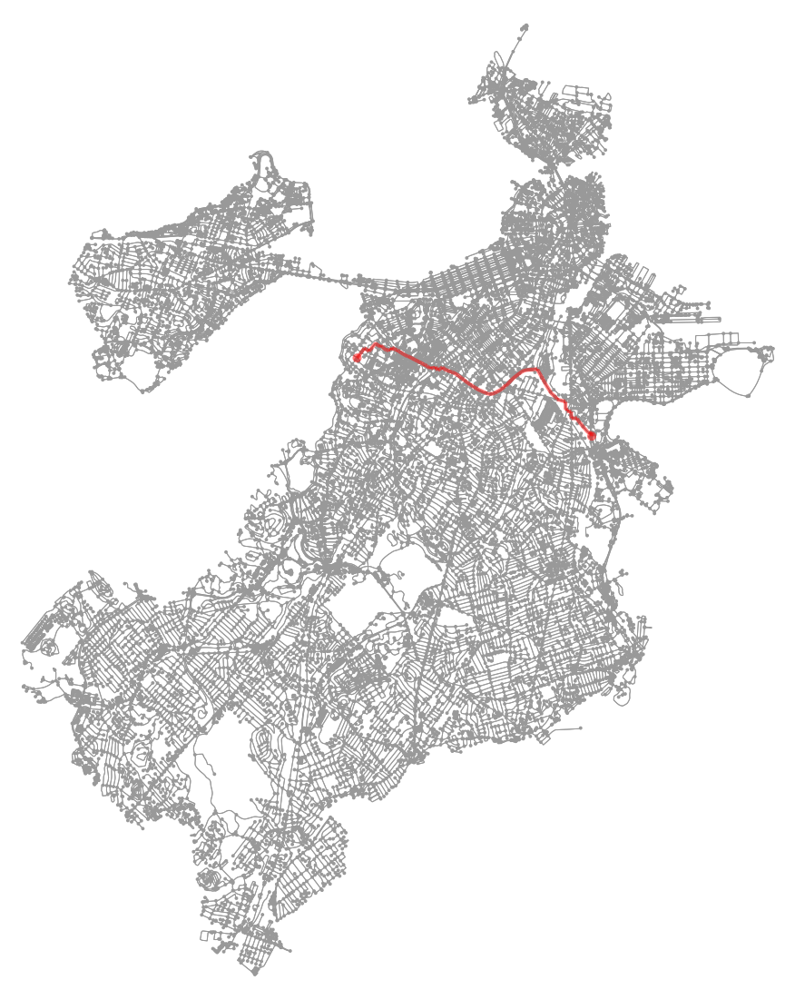

total Dist 6351.498    total Street Light Count 150    total Ped Accident Count 6    total crime 4


In [56]:
dijik_route = nx.dijkstra_path(Boston_G, rnode1, rnode2, weight='length_Crime')
ox.plot_graph_route(Boston_G, dijik_route, fig_height=20, fig_width=20)

u = dijik_route[0]
totalDist=0
totalSL=0
totalAcci=0
totalCrim=0
for v in dijik_route[1:]:
    totalDist += Boston_G[u][v][0]['length']
    totalSL += Boston_G[u][v][0]['SL_Count']
    totalAcci += Boston_G[u][v][0]['PED_Acci']
    totalCrim += Boston_G[u][v][0]['Crime_Count']    
    u = v
print("total Dist", totalDist, "   total Street Light Count", totalSL, "   total Ped Accident Count", totalAcci, "   total crime", totalCrim)

In [2]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
pd_Crimes = pd.read_csv('crime_boston.csv')
pd_Crimes.columns
geo_Crimes = gpd.GeoDataFrame(pd_Crimes.drop(['Lat', 'Long'], axis=1),
                             crs={'init': 'epsg:4326'}, # need to assign a CRS for CSV, CSV by default does not carry it
                             geometry=[Point(xy) for xy in zip(pd_Crimes.Long, pd_Crimes.Lat)])
geo_Crimes = geo_Crimes.to_crs(epsg=4327)


In [3]:
geo_Crimes.OCCURRED_ON_DATE

0        2019-09-29 06:00:00
1        2019-09-29 04:46:00
2        2019-09-29 04:46:00
3        2019-09-29 02:30:00
4        2019-09-29 01:30:00
                ...         
65605    2018-01-27 14:01:00
65606    2018-01-27 14:01:00
65607    2015-07-09 13:38:00
65608    2019-05-23 08:00:00
65609    2019-05-23 09:00:00
Name: OCCURRED_ON_DATE, Length: 65610, dtype: object

In [8]:
# geo_Crimes['time'] = pd.to_datetime(geo_Crimes['OCCURRED_ON_DATE'])
pd.set_option('display.max_rows', None)
geo_Crimes['OCCURRED_ON_DATE'] = pd.to_datetime(geo_Crimes['OCCURRED_ON_DATE'])
print(geo_Crimes['OCCURRED_ON_DATE'][0].hour)
print(geo_Crimes['OCCURRED_ON_DATE'][0].year)

start_date = '2015-01-01'
end_date = '2017-12-31'

mask = geo_Crimes[(geo_Crimes['OCCURRED_ON_DATE'] >= start_date) & (geo_Crimes['OCCURRED_ON_DATE'] <= end_date)]
# geo_Crimes['OCCURRED_ON_DATE'][1]hour

6
2019


In [10]:
len(mask)

40193

In [11]:
start_date = '2019-01-01'
end_date = '2019-12-31'

mask = geo_Crimes[(geo_Crimes['OCCURRED_ON_DATE'] >= start_date) & (geo_Crimes['OCCURRED_ON_DATE'] <= end_date)]
len(mask)

11209

In [16]:
import numpy as np
import networkx as nx

In [32]:
# Producing ensemble of travel distance based on length
# from random import choice
totalDIST_list = []
for idx in range(0,10):
    rnode1 = np.random.choice(Boston_G.nodes())
    rnode2 = np.random.choice(Boston_G.nodes())
    print(rnode1,rnode2)
    dijik_route = nx.dijkstra_path(Boston_G, rnode1, rnode2, weight='length')
    u = dijik_route[0]
    totalDist=0
    for v in dijik_route[1:]:
        totalDist += Boston_G[u][v][0]['length']
        u = v
    totalDIST_list.append(totalDist)

5459029581 1186263601
61405061 6407210465
61510855 4795890134
61440479 3281274237
522254300 61432387
61505139 3552622438
4941167956 6150844047
6878592281 61387744
61357722 5459207394
5458830371 4044495588


In [30]:
print(max(totalDIST_list))
print(min(totalDIST_list))

ValueError: max() arg is an empty sequence

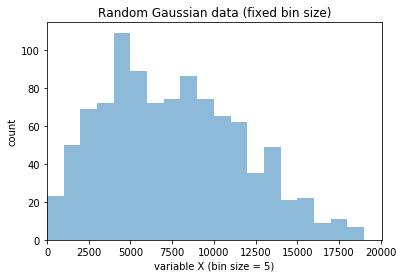

In [25]:
import numpy as np
from matplotlib import pyplot as plt

bins = np.arange(0, 20000, 1000) # fixed bin size

plt.xlim([0, max(totalDIST_list)+1000])

plt.hist(totalDIST_list, bins=bins, alpha=0.5)
plt.title('Random Travel Distance')
plt.xlabel('Distance')
plt.ylabel('Count')

plt.show()

/Users/jblee/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:15: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  from ipykernel import kernelapp as app


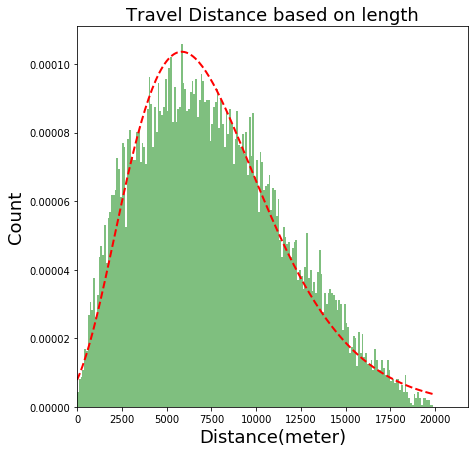

std :  4054.323219089784
mean :  7624.570401374999


In [188]:
import pickle
from scipy import stats 
import matplotlib.mlab as mlab

Length_pickle_list = []
for idx in range(0,8):
    pfile = open('file'+str(idx)+'_Ensemble_length.pkl','rb')
    lengthP = pickle.load(pfile)
    Length_pickle_list.append(lengthP)
from pandas.core.common import flatten
flatLengthList = list(flatten(Length_pickle_list))
bins = np.arange(0, 20000, 100) # fixed bin size
plt.figure(figsize=(7,7))
plt.xlim([0, max(flatLengthList)+1000])
plt.hist(flatLengthList, bins=bins, alpha=0.5, color='green', normed=True)
plt.title('Travel Distance based on length',fontsize=18)
plt.xlabel('Distance(meter)',fontsize=18)
plt.ylabel('Count',fontsize=18)

ag,bg,cg = stats.gamma.fit(Length_pickle_list)
y = stats.gamma.pdf(bins, ag, bg, cg)
plt.plot(bins, y, 'r--', linewidth=2)
# plt.plot(lnspc, pdf_g, label="Norm") # plot it
plt.show()
print("std : ", np.std(flatLengthList))
print("mean : ", np.mean(flatLengthList))

In [44]:
nx.write_gpickle(Boston_G, "BostonGraph_Total.gpickle")

In [45]:
for u, v, d in Boston_G.edges(data=True):
    print(u,v,d)

61341696 61341267 {'osmid': 8652528, 'oneway': False, 'lanes': '2', 'name': 'Park Plaza', 'highway': 'secondary', 'width': '29.9', 'length': 44.954}
61341696 4779725263 {'osmid': 426831017, 'lanes': '2', 'name': 'Columbus Avenue', 'highway': 'residential', 'width': '23.8', 'oneway': False, 'length': 7.915}
61341696 4779725246 {'osmid': 8651073, 'oneway': False, 'lanes': '2', 'name': 'Park Plaza', 'highway': 'secondary', 'width': '21.3', 'length': 19.073, 'geometry': <shapely.geometry.linestring.LineString object at 0x10df4c048>}
61341697 61342333 {'osmid': 8640801, 'oneway': False, 'lanes': '1', 'name': 'Glenville Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 23.799}
61341697 61341707 {'osmid': 8640801, 'oneway': False, 'lanes': '1', 'name': 'Glenville Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 72.236, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42bf5c88>}
61341697 61341702 {'osmid': 86

61341895 5543294135 {'osmid': 495554429, 'oneway': False, 'lanes': '2', 'ref': 'MA 203', 'name': 'Arborway', 'highway': 'primary', 'width': '30.2', 'length': 20.849999999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a58cf4588>}
61341899 61341857 {'osmid': 8651847, 'oneway': False, 'lanes': '1', 'name': 'Coleman Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 43.522}
61341899 61341596 {'osmid': 8642282, 'oneway': False, 'lanes': '1', 'name': 'Hendry Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 78.646, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a58cf4a90>}
61341899 61358319 {'osmid': 8642282, 'oneway': False, 'lanes': '1', 'name': 'Hendry Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 66.338, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a58cf4128>}
61341902 5549076808 {'osmid': 8646666, 'oneway': False, 'lanes

61342319 61342336 {'osmid': 8651265, 'oneway': False, 'lanes': '1', 'name': 'Oak Square Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 303.299, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e2e66d8>}
61342319 61577610 {'osmid': 149700924, 'lanes': '2', 'name': 'Washington Street', 'highway': 'tertiary', 'width': '15.2', 'oneway': False, 'length': 98.337, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e2e6710>}
61342319 61342308 {'osmid': 149700924, 'lanes': '2', 'name': 'Washington Street', 'highway': 'tertiary', 'width': '15.2', 'oneway': False, 'length': 50.034, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e2e66a0>}
1016136311 1016149638 {'osmid': 87384597, 'highway': 'footway', 'oneway': False, 'length': 3.725}
4192141946 1097411276 {'osmid': 94482777, 'name': 'Boston HarborWalk', 'highway': 'footway', 'oneway': False, 'length': 6.205}
4192141946 4723507338 {'osmid': 419031023, 'name'

61342564 4060516127 {'osmid': 8650117, 'lanes': '2', 'name': 'Colborne Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 22.756}
61342564 61342527 {'osmid': 8649404, 'lanes': '2', 'name': 'Monastery Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 75.886, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e3031d0>}
61342564 61343327 {'osmid': 8650549, 'lanes': '2', 'name': 'Colborne Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '13.4', 'oneway': False, 'length': 194.571, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e303208>}
61342570 6870207771 {'osmid': 8641529, 'lanes': '2', 'name': 'Undine Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.8', 'oneway': False, 'length': 289.606, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e303240>}
61342570 61342609 {'osmid': 8644342, 'oneway': False, 'lanes'

61473917 61474139 {'osmid': 631162513, 'oneway': False, 'highway': 'service', 'length': 20.723, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e320828>}
61473920 661035203 {'osmid': 426481847, 'oneway': False, 'lanes': '4', 'name': 'North Washington Street', 'highway': 'primary', 'width': '17.1', 'length': 45.668}
61473920 61473806 {'osmid': 8641575, 'oneway': False, 'name': 'John F. Fitzgerald Surface Road', 'highway': 'primary', 'width': '17.1', 'length': 17.305, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e320860>}
61473920 61377085 {'osmid': 8647803, 'oneway': False, 'lanes': '3', 'name': 'New Chardon Street', 'highway': 'secondary', 'width': '11.0', 'length': 58.262, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e320898>}
61342851 61426054 {'osmid': 8644859, 'lanes': '2', 'name': 'Woodstock Avenue', 'highway': 'residential', 'width': '11.6', 'oneway': False, 'length': 23.119999999999997, 'geometry': <shapely.geometry.

67503518 67503518 {'osmid': 9125470, 'highway': 'service', 'oneway': False, 'length': 53.905, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e34a630>}
67503518 67503518 {'osmid': 9125470, 'highway': 'service', 'oneway': False, 'length': 53.905, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e34a668>}
61605282 61605007 {'osmid': 8640681, 'oneway': False, 'highway': 'service', 'length': 58.424, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e34a6a0>}
61605282 61360049 {'osmid': 8640681, 'oneway': False, 'highway': 'service', 'length': 26.61, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e34a6d8>}
61605282 61605271 {'osmid': 8645649, 'highway': 'service', 'oneway': False, 'length': 45.45, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e34a710>}
61343140 61340370 {'osmid': 8648713, 'oneway': False, 'lanes': '1', 'name': 'Boylston Street', 'highway': 'residential', 'maxspeed': '25 mph', 'wid

61343403 5850816705 {'osmid': 8649610, 'lanes': '2', 'name': 'Chestnut Hill Avenue', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '16.8', 'oneway': False, 'length': 36.152}
61343403 61342699 {'osmid': 8638142, 'lanes': '2', 'name': 'Chiswick Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 196.517, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e367828>}
61343403 61484706 {'osmid': 28993990, 'oneway': False, 'lanes': '1', 'name': 'Chiswick Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'length': 93.623, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e367908>}
61343405 61484724 {'osmid': 8644600, 'oneway': False, 'lanes': '1', 'name': 'Waltham Street', 'highway': 'residential', 'width': '11.9', 'length': 86.577}
61343405 61343407 {'osmid': 8644600, 'oneway': False, 'lanes': '1', 'name': 'Waltham Street', 'highway': 'residential', 'width': '11.9', 'length': 123.657}

6878136211 5709630354 {'osmid': 600452678, 'highway': 'footway', 'oneway': False, 'length': 44.701}
6878136211 6878136210 {'osmid': 734453848, 'highway': 'service', 'oneway': False, 'length': 14.537}
6878136211 6878136209 {'osmid': 734453848, 'highway': 'service', 'oneway': False, 'length': 5.638}
6878136211 5709630367 {'osmid': 600452678, 'highway': 'footway', 'oneway': False, 'length': 543.4739999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a2e384780>}
4067690389 4067690390 {'osmid': 8639100, 'lanes': '2', 'name': 'Lamartine Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 7.568}
4067690389 5265960906 {'osmid': 8650613, 'oneway': False, 'lanes': '1', 'name': 'Lamartine Place', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.3', 'length': 70.363}
4067690389 61343075 {'osmid': 8639100, 'lanes': '2', 'name': 'Lamartine Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'one

61475058 3060065455 {'osmid': 8647200, 'oneway': False, 'lanes': '2', 'name': 'Malcolm X Boulevard', 'highway': 'secondary', 'width': '24.4', 'length': 104.03899999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a33523470>}
61475058 3060065453 {'osmid': 591236167, 'oneway': False, 'lanes': '2', 'name': 'Shawmut Avenue', 'highway': 'tertiary', 'width': '17.1', 'length': 92.319, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a335234a8>}
61343988 61343992 {'osmid': 8651197, 'oneway': False, 'lanes': '1', 'name': 'Higgins Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.9', 'length': 66.66}
61343988 61490129 {'osmid': [588063784, 8649578, 8636419, 8648188], 'lanes': '2', 'name': ['Higgins Street', 'Griggs Place'], 'highway': 'residential', 'maxspeed': '25 mph', 'width': ['7.9', '7.3'], 'oneway': False, 'length': 288.092, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a33523518>}
61343988 61361949 {'osmid': 426

61344194 61340550 {'osmid': 8648346, 'lanes': '2', 'name': 'Athol Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.4', 'oneway': False, 'length': 87.831, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3353e208>}
6162811330 1522224147 {'osmid': 426456738, 'lanes': '5', 'name': 'New Chardon Street', 'highway': 'primary', 'width': '24.4', 'oneway': False, 'length': 12.731}
6162811330 61352245 {'osmid': [8641560, 426456738], 'lanes': ['4', '5'], 'name': 'New Chardon Street', 'highway': ['secondary', 'primary'], 'width': '24.4', 'oneway': False, 'length': 96.56, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5652b278>}
6162811330 6162811332 {'osmid': [658046481, 658046479], 'highway': 'footway', 'oneway': False, 'length': 13.135, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5652b2b0>}
6162811330 6162811333 {'osmid': [658046482, 658046479], 'highway': 'footway', 'oneway': False, 'length': 10.79, 'geometry': <shap

5359733368 5359733367 {'osmid': 555538332, 'oneway': False, 'name': 'Franklin Street', 'highway': 'service', 'service': 'driveway', 'access': 'destination', 'length': 31.724}
5359733368 5359733367 {'osmid': 555263071, 'oneway': False, 'highway': 'service', 'service': 'driveway', 'access': 'destination', 'length': 42.123, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56538eb8>}
61344377 61395663 {'osmid': 8651285, 'oneway': False, 'lanes': '2', 'ref': 'MA 30', 'name': 'Commonwealth Avenue', 'highway': 'secondary', 'width': '36.6', 'length': 417.609, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3354e0f0>}
61344377 61344257 {'osmid': [524655229, 524655221, 524655222], 'name': 'Saint Thomas More Road', 'highway': 'residential', 'oneway': False, 'length': 19.561999999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a3354e160>}
61344377 3405453377 {'osmid': 524655224, 'name': 'Saint Thomas More Road', 'highway': 'residential', 

5709630393 5709630394 {'osmid': 600452684, 'highway': 'footway', 'oneway': False, 'length': 4.67}
5709630393 5709630392 {'osmid': 600452684, 'highway': 'footway', 'oneway': False, 'length': 4.713}
5709630393 61456290 {'osmid': 8646168, 'oneway': False, 'lanes': '1', 'name': 'Custer Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'length': 85.37899999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a335794e0>}
61344698 61412879 {'osmid': 8639297, 'name': 'Raynor Circle', 'highway': 'residential', 'maxspeed': '25 mph', 'oneway': False, 'length': 69.994}
61344698 61344930 {'osmid': 8648709, 'oneway': False, 'lanes': '2', 'name': 'Ruggles Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '15.5', 'length': 45.229}
61344698 7087672808 {'osmid': 8648709, 'oneway': False, 'lanes': '2', 'name': 'Ruggles Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '15.5', 'length': 78.387, 'geometry': <shapely.geometry.linestring.Li

61410417 61347039 {'osmid': 8646335, 'oneway': False, 'lanes': '1', 'name': 'Dale Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 56.603, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56790dd8>}
61410417 61347555 {'osmid': 8648720, 'oneway': False, 'lanes': '1', 'name': 'Rockland Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '5.8', 'length': 143.55, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56790e10>}
61410421 61340988 {'osmid': 426636537, 'oneway': False, 'lanes': '2', 'name': 'Pond Street', 'highway': 'primary', 'width': '18.3', 'junction': 'roundabout', 'length': 36.817}
61410421 5549069556 {'osmid': 8652553, 'oneway': False, 'lanes': '3', 'name': 'Pond Street', 'highway': 'primary', 'maxspeed': '30 mph', 'width': '15.2', 'length': 35.153000000000006, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56790eb8>}
61410421 61388152 {'osmid': 48919789, 'oneway': False, 'la

61345183 61345900 {'osmid': 8646735, 'lanes': '2', 'name': 'Copenger Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'oneway': False, 'length': 65.515}
61345183 61345221 {'osmid': 8644635, 'oneway': False, 'lanes': '2', 'name': 'Parker Hill Avenue', 'highway': 'tertiary', 'width': '14.0', 'length': 55.466, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40c35ef0>}
6755978656 6755978653 {'osmid': 719706022, 'highway': 'service', 'oneway': False, 'length': 54.732, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5733b748>}
3990568330 6540728582 {'osmid': 396258222, 'highway': 'footway', 'oneway': False, 'length': 6.807}
3990568330 6540742193 {'osmid': 396258222, 'highway': 'footway', 'oneway': False, 'length': 9.666}
3990568330 6540357038 {'osmid': 696461010, 'highway': 'footway', 'oneway': False, 'length': 15.627}
61410723 61410465 {'osmid': 8640285, 'lanes': '2', 'name': 'Corey Terrace', 'highway': 'residential', 'width': '10

6548295379 6548295380 {'osmid': 697209725, 'name': 'Walnut Court', 'highway': 'residential', 'oneway': False, 'length': 44.604}
6548295379 61511422 {'osmid': 8647025, 'lanes': '2', 'name': 'Walnut Street', 'highway': 'residential', 'width': '10.7', 'oneway': False, 'length': 181.099, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a567add30>}
61345493 6870900489 {'osmid': 426476042, 'lanes': '4', 'name': 'Massachusetts Avenue', 'highway': 'secondary', 'width': '21.6', 'oneway': False, 'length': 31.026}
61345493 61345483 {'osmid': 8646319, 'lanes': '2', 'name': 'Peirson Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 141.63400000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40ca0b70>}
61345493 61345519 {'osmid': [426476042, 426476047], 'lanes': ['4', '2'], 'name': 'Massachusetts Avenue', 'highway': 'secondary', 'width': '21.6', 'oneway': False, 'length': 71.805, 'geometry': <shapely.geometr

5458431967 5458431961 {'osmid': 566889599, 'oneway': False, 'highway': 'service', 'length': 28.456}
366612453 366612330 {'osmid': 32601702, 'highway': 'footway', 'oneway': False, 'length': 7.884}
366612453 366612593 {'osmid': 32601706, 'highway': 'footway', 'oneway': False, 'length': 12.003, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40d8b5f8>}
366612453 4227654835 {'osmid': 423051401, 'highway': 'footway', 'oneway': False, 'length': 24.483, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40d8b630>}
1305546725 61422331 {'osmid': [101912038, 426462221, 8650317, 426462233, 426462238], 'oneway': False, 'lanes': ['2', '3'], 'name': 'Massachusetts Avenue', 'highway': 'secondary', 'width': '29.0', 'length': 209.882, 'tunnel': 'yes', 'geometry': <shapely.geometry.linestring.LineString object at 0x1a567bdc18>}
1305546725 5691213422 {'osmid': 115591991, 'lanes': '3', 'name': 'Albany Street', 'highway': 'tertiary', 'width': '24.4', 'oneway': False, 'lengt

61411551 61607163 {'osmid': [8650405, 8649623], 'highway': 'residential', 'oneway': False, 'length': 110.898, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a567cdcf8>}
4080406752 61348119 {'osmid': 8652508, 'lanes': '1', 'name': 'Public Alley 303', 'highway': 'service', 'service': 'alley', 'width': '3.0', 'oneway': False, 'length': 44.736999999999995, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40da9978>}
61411558 6881226064 {'osmid': 734769325, 'highway': 'service', 'oneway': False, 'length': 13.868}
61411558 61411572 {'osmid': 8648086, 'oneway': False, 'lanes': '2', 'name': 'Veterans of Foreign Wars Parkway', 'highway': 'primary', 'width': '26.5', 'length': 124.559, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a567cddd8>}
61411558 61411551 {'osmid': 8648086, 'oneway': False, 'lanes': '2', 'name': 'Veterans of Foreign Wars Parkway', 'highway': 'primary', 'width': '26.5', 'length': 110.24000000000001, 'geometry': <shapely.geo

61346379 61346371 {'osmid': 8646711, 'oneway': False, 'lanes': '1', 'name': 'Burrell Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 168.675, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40e15d68>}
61346379 61346375 {'osmid': 570158272, 'lanes': '2', 'name': 'Dudley Street', 'highway': 'secondary', 'width': '19.8', 'oneway': False, 'length': 53.248000000000005, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40e15da0>}
61542987 61354912 {'osmid': 8652020, 'lanes': '2', 'name': 'Brother Joseph A Heeran Way', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 39.113}
61542987 6869657848 {'osmid': 8652020, 'lanes': '2', 'name': 'Brother Joseph A Heeran Way', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 69.362, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a567d8be0>}
61542987 6869657854 {'osmid': 733540118, 'highway': 'service', 'access': 'emergency', '

4995552117 4995552128 {'osmid': 510562338, 'highway': 'service', 'oneway': False, 'length': 53.812000000000005, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40fbf4a8>}
4995552121 4995552131 {'osmid': 8646486, 'name': 'Elm Avenue', 'highway': 'track', 'oneway': False, 'length': 18.554, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40fbf4e0>}
61346682 61346684 {'osmid': 8648250, 'oneway': False, 'lanes': '1', 'name': 'Common Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'length': 60.324}
61346682 1905386631 {'osmid': 180105311, 'highway': 'footway', 'oneway': False, 'length': 44.564}
61346682 61452085 {'osmid': 8651520, 'oneway': False, 'lanes': '1', 'name': 'Winthrop Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'length': 100.31200000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a40fbf518>}
61346682 1905386633 {'osmid': [8651520, 217801042], 'oneway': False, 'lanes

5543761105 5543761098 {'osmid': 578641712, 'highway': 'footway', 'oneway': False, 'length': 41.673, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56804d68>}
5543761105 5543761430 {'osmid': [578641720, 578641716, 578641718], 'highway': 'footway', 'oneway': False, 'length': 184.33000000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56804da0>}
6565139668 61400690 {'osmid': 8647088, 'lanes': '2', 'name': 'Walnut Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '18.0', 'oneway': False, 'length': 11.062}
6565139668 61400718 {'osmid': 8651264, 'lanes': '2', 'name': 'Hilton Terrace', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '23.2', 'oneway': False, 'length': 30.712}
6565139668 61347601 {'osmid': 8647088, 'lanes': '2', 'name': 'Walnut Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '18.0', 'oneway': False, 'length': 50.641999999999996, 'geometry': <shapely.geometry.linestring.LineString object at 0

390010246 390010238 {'osmid': 8636790, 'name': 'Harvard Way', 'highway': 'service', 'access': 'destination', 'oneway': False, 'length': 19.518, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56814fd0>}
390010246 390010165 {'osmid': 8636790, 'name': 'Harvard Way', 'highway': 'service', 'access': 'destination', 'oneway': False, 'length': 22.59, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56822048>}
61543815 61405768 {'osmid': 8652415, 'name': 'Anderer Lane', 'highway': 'service', 'oneway': False, 'length': 71.83, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56822080>}
61543815 61543815 {'osmid': 8652457, 'name': 'Anderer Lane', 'highway': 'service', 'oneway': False, 'length': 75.45, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a568220b8>}
61543815 61543815 {'osmid': 8652457, 'name': 'Anderer Lane', 'highway': 'service', 'oneway': False, 'length': 75.45000000000002, 'geometry': <shapely.geometry.linestring.L

61413016 61342045 {'osmid': 8644883, 'oneway': False, 'lanes': '1', 'name': 'Carolina Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'length': 73.691, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56822d30>}
61347483 61347484 {'osmid': 8646461, 'lanes': '2', 'name': 'Chestnut Street', 'highway': 'tertiary', 'width': '22.0', 'oneway': False, 'length': 40.981}
61347483 3605411630 {'osmid': 354890464, 'highway': 'service', 'oneway': False, 'length': 7.746}
61347483 1280319741 {'osmid': 426626900, 'lanes': '2', 'name': 'Perkins Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '15.9', 'oneway': False, 'length': 4.171}
61347483 61347469 {'osmid': [426626898, 133175135], 'lanes': ['2', '3'], 'name': 'Perkins Street', 'highway': 'tertiary', 'width': '15.9', 'oneway': False, 'length': 49.083, 'maxspeed': '25 mph', 'geometry': <shapely.geometry.linestring.LineString object at 0x1a410636a0>}
61347484 61377920 {'osmid': 8646461, 'lanes': 

7170561935 7170561947 {'osmid': 8644559, 'oneway': False, 'lanes': '2', 'name': 'West Broadway', 'highway': 'primary', 'width': '18.3', 'length': 11.029}
7170561935 7170561945 {'osmid': 767990676, 'oneway': False, 'lanes': '2', 'name': 'West Broadway', 'highway': 'primary', 'width': '18.3', 'length': 18.0}
7170561935 7170561940 {'osmid': 767990681, 'oneway': False, 'highway': 'service', 'length': 33.097, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56e64710>}
896276364 896277044 {'osmid': 75916628, 'highway': 'footway', 'oneway': False, 'length': 10.211}
896276364 896277089 {'osmid': 75916628, 'highway': 'footway', 'oneway': False, 'length': 39.736000000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4110dac8>}
896276364 896277234 {'osmid': 75916652, 'highway': 'footway', 'oneway': False, 'length': 62.879, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4110dba8>}
61347727 61347719 {'osmid': 8645803, 'oneway': False, 'lan

5853812810 5845055138 {'osmid': 533640529, 'oneway': False, 'lanes': '2', 'ref': 'MA 28', 'name': 'Blue Hill Avenue', 'highway': 'primary', 'width': '39.9', 'length': 64.364, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41139828>}
5853812811 61520300 {'osmid': 426469234, 'oneway': False, 'lanes': '2', 'ref': 'MA 28', 'name': 'Blue Hill Avenue', 'highway': 'primary', 'width': '39.9', 'length': 119.027}
5853812811 5853812810 {'osmid': 619454099, 'highway': 'primary_link', 'oneway': False, 'length': 12.801}
5853812811 61549840 {'osmid': 426469234, 'oneway': False, 'lanes': '2', 'ref': 'MA 28', 'name': 'Blue Hill Avenue', 'highway': 'primary', 'width': '39.9', 'length': 40.529999999999994, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a411397b8>}
896276557 896276937 {'osmid': 75916653, 'highway': 'footway', 'oneway': False, 'length': 6.107}
896276557 896277774 {'osmid': 75916639, 'highway': 'footway', 'oneway': False, 'length': 28.938000000000002, 'g

61610297 61610229 {'osmid': 8638087, 'highway': 'service', 'oneway': False, 'length': 108.381, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41156e10>}
61348155 7134296245 {'osmid': 93128853, 'oneway': False, 'lanes': '1', 'highway': 'trunk_link', 'width': '15.2', 'length': 24.763}
61348155 7134287102 {'osmid': 93128853, 'oneway': False, 'lanes': '1', 'highway': 'trunk_link', 'width': '15.2', 'length': 31.292}
61348155 7134287100 {'osmid': 763482471, 'highway': 'service', 'oneway': False, 'length': 39.857, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41156e48>}
2258966846 5888223553 {'osmid': 8637589, 'highway': 'service', 'oneway': False, 'length': 30.298}
61610305 61383005 {'osmid': 8639093, 'highway': 'service', 'oneway': False, 'length': 61.764}
61610305 61610297 {'osmid': 8639302, 'highway': 'service', 'oneway': False, 'length': 30.077}
61610305 61610535 {'osmid': 8648284, 'highway': 'service', 'oneway': False, 'length': 96.287, 'geometry':

61348321 3334642186 {'osmid': 8814292, 'lanes': '2', 'name': 'Lanark Road', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 15.632, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a411820b8>}
3306232289 61350969 {'osmid': 41917741, 'highway': 'footway', 'oneway': False, 'length': 142.168, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5684dc18>}
3306232289 3306232285 {'osmid': 41917741, 'highway': 'footway', 'oneway': False, 'length': 13.548, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5684dc50>}
3306232289 3306232287 {'osmid': 323853885, 'highway': 'footway', 'oneway': False, 'length': 10.394, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5684dc88>}
61348323 61413773 {'osmid': 8646435, 'lanes': '2', 'name': 'Kilsyth Terrace', 'highway': 'residential', 'width': '9.1', 'oneway': False, 'length': 84.75, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a411820f0>}
61348323 6

6774659783 6774659775 {'osmid': 8648605, 'name': 'Rivermoor Street', 'highway': 'residential', 'oneway': False, 'length': 27.219, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56859c50>}
2296322763 2296322781 {'osmid': 220520030, 'highway': 'footway', 'oneway': False, 'length': 22.691, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56859c88>}
2296322763 2152582219 {'osmid': 350651978, 'highway': 'footway', 'oneway': False, 'length': 16.592, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56859cc0>}
2296322763 2296322758 {'osmid': [181024752, 350651978], 'highway': 'footway', 'oneway': False, 'length': 35.408, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56859cf8>}
61414096 61414064 {'osmid': 8647453, 'highway': 'service', 'oneway': False, 'length': 179.488, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56859d30>}
61479634 61353169 {'osmid': 8643637, 'lanes': '2', 'name': 'Erie Street', 'hi

6289890392 6289890363 {'osmid': 671687243, 'highway': 'footway', 'oneway': False, 'length': 122.22399999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a411d6160>}
5976628313 61344615 {'osmid': 8650477, 'oneway': False, 'lanes': '2', 'name': 'G Street', 'highway': 'tertiary', 'width': '14.9', 'length': 21.1}
5976628313 61459018 {'osmid': 633109348, 'lanes': '2', 'name': 'G Street', 'highway': 'tertiary', 'width': '14.9', 'oneway': False, 'length': 24.494}
5976628313 61458973 {'osmid': 8649874, 'oneway': False, 'lanes': '1', 'name': 'Thomas Park', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.0', 'length': 75.619, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a411d6198>}
6289890396 6289890129 {'osmid': 671687231, 'highway': 'footway', 'oneway': False, 'length': 14.395, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a411d61d0>}
6289890396 6289890118 {'osmid': 671687231, 'highway': 'footway', 'oneway': False, 'le

61414863 61517359 {'osmid': 359232566, 'name': 'Canterbury Street', 'highway': 'residential', 'oneway': False, 'length': 144.757, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a568842e8>}
61414863 61414621 {'osmid': 591715249, 'name': 'Canterbury Street', 'highway': 'residential', 'oneway': False, 'length': 132.165, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56884320>}
61414863 6870944330 {'osmid': 733607326, 'highway': 'service', 'oneway': False, 'length': 327.43300000000005, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56884358>}
61349334 61363497 {'osmid': 8637714, 'oneway': False, 'lanes': '1', 'name': 'Mascot Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 92.91499999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a412049b0>}
61349334 61402234 {'osmid': 8652340, 'lanes': '2', 'name': 'Mountain Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': 

61349743 61362229 {'osmid': 8647779, 'oneway': False, 'lanes': '1', 'name': 'Beaumont Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.8', 'length': 18.079}
61349743 61366911 {'osmid': 8647779, 'oneway': False, 'lanes': '1', 'name': 'Beaumont Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.8', 'length': 45.198}
61349744 61349743 {'osmid': 8636712, 'lanes': '2', 'name': 'Berkshire Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 66.952}
61349744 61518558 {'osmid': 8641644, 'oneway': False, 'lanes': '1', 'name': 'Westmoreland Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 204.75400000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4123d0f0>}
61349744 61490171 {'osmid': 8641644, 'oneway': False, 'lanes': '1', 'name': 'Westmoreland Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 159.943, 'geometry': <

3990569317 4687378978 {'osmid': 396258248, 'highway': 'footway', 'oneway': False, 'length': 11.873}
3990569317 4687378979 {'osmid': 474876504, 'highway': 'footway', 'oneway': False, 'length': 7.796}
3990569317 4687381708 {'osmid': 474876548, 'highway': 'footway', 'oneway': False, 'length': 40.483}
3990569317 6540728512 {'osmid': 696501067, 'highway': 'footway', 'oneway': False, 'length': 210.954}
61350150 61350100 {'osmid': 510035800, 'lanes': '2', 'name': 'Washington Street', 'highway': 'secondary', 'width': '19.8', 'oneway': False, 'length': 90.555}
61350150 6152341953 {'osmid': 510035801, 'lanes': '2', 'name': 'Washington Street', 'highway': 'secondary', 'width': '19.8', 'oneway': False, 'length': 9.034}
61350150 61350147 {'osmid': 8650722, 'oneway': False, 'lanes': '1', 'name': 'Mendelssohn Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 198.931, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4126a160>}
61481223 61365456 {'osmi

3005752040 6755197342 {'osmid': 328890421, 'name': 'South Bay Harbor Trail', 'highway': 'path', 'oneway': False, 'length': 17.627, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a412c43c8>}
61350635 61359310 {'osmid': 132174018, 'lanes': '2', 'name': 'Causeway Street', 'highway': 'secondary', 'width': '30.2', 'oneway': False, 'length': 34.531}
61350635 61357894 {'osmid': 8648170, 'lanes': '1', 'name': 'Beverly Street Extension', 'highway': 'residential', 'maxspeed': '20 mph', 'width': '24.4', 'oneway': False, 'length': 48.67, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a412c4400>}
61350635 61350637 {'osmid': [426456673, 140090363], 'lanes': ['6', '2'], 'name': 'Causeway Street', 'highway': 'secondary', 'width': '30.2', 'oneway': False, 'length': 41.343, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a412c4438>}
61350637 7131547387 {'osmid': 591677136, 'oneway': False, 'lanes': '2', 'name': 'Beverly Street', 'highway': 'residentia

5458830371 5458830369 {'osmid': 566975139, 'highway': 'service', 'oneway': False, 'length': 18.933}
5458830372 5458830373 {'osmid': 566975132, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 41.749}
5458830372 5458830374 {'osmid': 566975142, 'highway': 'service', 'oneway': False, 'length': 19.218}
5458830372 5458830370 {'osmid': 566975142, 'highway': 'service', 'oneway': False, 'length': 23.19}
5458830373 5458830372 {'osmid': 566975132, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 41.749}
5458830373 5458830375 {'osmid': 566975139, 'highway': 'service', 'oneway': False, 'length': 20.933}
5458830373 5458830371 {'osmid': 566975139, 'highway': 'service', 'oneway': False, 'length': 22.719}
61350954 61349226 {'osmid': 8645609, 'lanes': '2', 'name': 'Chestnut Hill Driveway', 'highway': 'residential', 'width': '15.5', 'oneway': False, 'length': 304.657, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a412e36a0>}
6135

4998702291 4606621810 {'osmid': 512689929, 'oneway': False, 'lanes': '1', 'name': 'Minot Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '13.7', 'length': 41.208}
4998702291 6755741771 {'osmid': 512689929, 'oneway': False, 'lanes': '1', 'name': 'Minot Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '13.7', 'length': 55.255}
5312029902 5674297161 {'osmid': 549916339, 'highway': 'footway', 'oneway': False, 'length': 9.444}
5312029902 5312029849 {'osmid': 549916342, 'highway': 'footway', 'oneway': False, 'length': 51.658}
5312029902 5312029905 {'osmid': [549916341, 549916342], 'highway': 'footway', 'oneway': False, 'length': 30.914, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a568cbbe0>}
5312029905 5312029902 {'osmid': [549916341, 549916342], 'highway': 'footway', 'oneway': False, 'length': 30.913999999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a568cbc50>}
5312029905 5312029909 {'osmid': 549916347, 'hig

61351426 61351435 {'osmid': 591278021, 'lanes': '2', 'name': 'Georgetowne Drive', 'highway': 'residential', 'width': '25.6', 'oneway': False, 'length': 52.312, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4131e7f0>}
1809524231 7108530088 {'osmid': 231826904, 'highway': 'footway', 'oneway': False, 'length': 5.894}
1809524231 1818111078 {'osmid': 55677196, 'highway': 'footway', 'oneway': False, 'length': 76.82199999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a568d97b8>}
1809524231 64063937 {'osmid': 231826904, 'highway': 'footway', 'oneway': False, 'length': 66.864, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a568d97f0>}
5211366921 3577724614 {'osmid': 94841500, 'oneway': False, 'lanes': '1', 'name': 'Constitution Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '13.4', 'length': 35.036, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a568d9828>}
5211366921 5211367034 {'osmid': 94841500

61351695 61348184 {'osmid': 8649043, 'lanes': '2', 'name': 'Montvale Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'oneway': False, 'length': 264.703, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a413494a8>}
4719781648 4719781638 {'osmid': 478776027, 'highway': 'footway', 'oneway': False, 'length': 0.905}
4719781648 4719781630 {'osmid': 478776027, 'highway': 'footway', 'oneway': False, 'length': 14.207}
4719781648 4719781653 {'osmid': 478776030, 'highway': 'footway', 'oneway': False, 'length': 18.265, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a413494e0>}
61351689 61351505 {'osmid': 642020042, 'lanes': '2', 'name': 'Lagrange Street', 'highway': 'tertiary', 'width': '18.3', 'oneway': False, 'length': 79.402}
61351689 61354207 {'osmid': 8646664, 'oneway': False, 'lanes': '1', 'name': 'Westmount Avenue', 'highway': 'residential', 'width': '9.1', 'length': 100.625, 'geometry': <shapely.geometry.linestring.LineString obje

61352251 61358125 {'osmid': 8643944, 'oneway': False, 'lanes': '1', 'name': 'Prince Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'length': 94.111, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41372eb8>}
5888223547 5888223548 {'osmid': 623468262, 'highway': 'footway', 'oneway': False, 'length': 176.838}
5888223547 5888223546 {'osmid': 623468262, 'highway': 'footway', 'oneway': False, 'length': 13.727}
5888223547 1381389921 {'osmid': 216538346, 'oneway': False, 'lanes': '2', 'name': 'University Drive East', 'highway': 'unclassified', 'length': 83.776, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a568f8b38>}
5888223547 4933379428 {'osmid': 216538346, 'oneway': False, 'lanes': '2', 'name': 'University Drive East', 'highway': 'unclassified', 'length': 43.285000000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a568f8b70>}
5888223548 5888223547 {'osmid': 623468262, 'highway': 'footway', 'oneway': Fa

61352773 61348278 {'osmid': 435375258, 'lanes': '2', 'name': 'Lyall Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 61.54}
61352773 61352777 {'osmid': 8648479, 'lanes': '1', 'name': 'Lyall Terrace', 'highway': 'residential', 'width': '5.5', 'oneway': False, 'length': 80.787, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4139d828>}
61352773 61364387 {'osmid': 8648479, 'lanes': '1', 'name': 'Lyall Terrace', 'highway': 'residential', 'width': '5.5', 'oneway': False, 'length': 108.533, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4139d860>}
61352777 61352773 {'osmid': 8648479, 'lanes': '1', 'name': 'Lyall Terrace', 'highway': 'residential', 'width': '5.5', 'oneway': False, 'length': 80.787, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4139d898>}
61352781 5624723239 {'osmid': 8646205, 'lanes': '1', 'name': 'Public Alley 1001', 'highway': 'service', 'service': 'alley', 'width': '4.9', 'oneway': False

1534929959 61374253 {'osmid': 426484910, 'oneway': False, 'lanes': '2', 'name': 'Clinton Street', 'highway': 'secondary', 'width': '11.0', 'length': 9.672, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56923a90>}
6757231656 61348256 {'osmid': 8646023, 'oneway': False, 'lanes': '1', 'name': 'Montello Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 63.888}
6757231656 61480696 {'osmid': 8646023, 'oneway': False, 'lanes': '1', 'name': 'Montello Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 55.105999999999995, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56923b38>}
6757231656 6757231657 {'osmid': 719932700, 'highway': 'service', 'oneway': False, 'length': 44.789, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56923b70>}
61353001 61360092 {'osmid': 591284919, 'lanes': '4', 'name': 'Spring Street', 'highway': 'secondary', 'width': '24.7', 'oneway': False, 'leng

6881226061 6881226060 {'osmid': 734769323, 'highway': 'service', 'oneway': False, 'length': 78.384}
6881226061 6881226063 {'osmid': 734769324, 'highway': 'service', 'oneway': False, 'length': 35.338}
6881226063 6881230987 {'osmid': 8639793, 'oneway': False, 'highway': 'service', 'length': 37.305}
6881226063 6881226061 {'osmid': 734769324, 'highway': 'service', 'oneway': False, 'length': 35.338}
6881226063 6881226068 {'osmid': [734769328, 8639793], 'oneway': False, 'highway': 'service', 'length': 73.969, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5693bb70>}
6881226064 6881226065 {'osmid': 734769325, 'highway': 'service', 'oneway': False, 'length': 90.487}
6881226064 61411558 {'osmid': 734769325, 'highway': 'service', 'oneway': False, 'length': 13.868}
6881226064 6881226074 {'osmid': 734769326, 'highway': 'service', 'oneway': False, 'length': 24.976999999999997, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5693bba8>}
6881226065 6881226064 {'osm

5459225999 5459225998 {'osmid': 567030006, 'highway': 'service', 'oneway': False, 'length': 18.296}
5459225999 5459226002 {'osmid': 567030009, 'highway': 'service', 'oneway': False, 'length': 31.501}
5459225999 5459226000 {'osmid': 567030009, 'highway': 'service', 'oneway': False, 'length': 89.505, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a566a1320>}
2272144791 61368903 {'osmid': 627755984, 'oneway': False, 'name': 'Commonwealth Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 7.893}
2272144791 2272144799 {'osmid': 217906840, 'highway': 'footway', 'oneway': False, 'length': 12.615, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a413e33c8>}
2272144791 61356441 {'osmid': 627755984, 'oneway': False, 'name': 'Commonwealth Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 95.44500000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a413e3400>}
61353368 113239

61353551 61355904 {'osmid': 63104590, 'oneway': False, 'lanes': '2', 'name': 'Tremont Street', 'highway': 'secondary', 'width': '30.2', 'length': 68.869}
61353551 2540099018 {'osmid': 63104590, 'oneway': False, 'lanes': '2', 'name': 'Tremont Street', 'highway': 'secondary', 'width': '30.2', 'length': 6.333}
61353551 61353453 {'osmid': 654038108, 'oneway': False, 'lanes': '1', 'name': 'Bromfield Street', 'highway': 'residential', 'width': '10.4', 'length': 80.595}
3181981262 3181981250 {'osmid': 312345710, 'highway': 'footway', 'oneway': False, 'length': 2.994}
3181981262 3181981318 {'osmid': 312345656, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 25.053, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a566af240>}
3181981262 3181981233 {'osmid': 312345656, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 48.556, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a566af278>}
3181981262 3181981298 {

61484874 61343624 {'osmid': 296776154, 'lanes': '2', 'name': 'Flaherty Way', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '8.5', 'oneway': False, 'length': 35.878}
61484874 61401655 {'osmid': 8640063, 'lanes': '2', 'name': 'Saint Casimir Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.8', 'oneway': False, 'length': 90.33600000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4141f898>}
1769090891 322648823 {'osmid': [165358918, 29328015], 'bridge': 'yes', 'highway': 'footway', 'oneway': False, 'length': 26.393, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4141f8d0>}
61484879 3324417814 {'osmid': 8644421, 'oneway': False, 'lanes': '1', 'name': 'Strathmore Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'length': 152.62699999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4141f908>}
61484879 61484706 {'osmid': 8650528, 'oneway': False, 'lanes': '1', 'name': 'Lot

61354043 61521982 {'osmid': 8640282, 'lanes': '2', 'name': 'Hill Top Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'oneway': False, 'length': 57.099, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a414498d0>}
61354043 61366930 {'osmid': 8641212, 'oneway': False, 'lanes': '2', 'name': 'Rockne Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 186.47899999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41449908>}
61354045 61358088 {'osmid': 8646166, 'oneway': False, 'lanes': '1', 'name': 'Alberta Street', 'highway': 'residential', 'width': '6.4', 'length': 63.176}
61354045 61354417 {'osmid': 310169173, 'oneway': False, 'lanes': '1', 'name': 'Elgin Street', 'highway': 'residential', 'width': '12.2', 'length': 21.167}
61354045 3155473245 {'osmid': 310169173, 'oneway': False, 'lanes': '1', 'name': 'Elgin Street', 'highway': 'residential', 'width': '12.2', 'length': 110.482, 'geometry': <

61354256 6863847638 {'osmid': 448441075, 'oneway': False, 'lanes': '2', 'name': 'Harrison Avenue', 'highway': 'secondary', 'width': '25.0', 'length': 31.734}
61354256 61493524 {'osmid': 8640707, 'oneway': False, 'lanes': '1', 'name': 'Harrison Avenue Extension', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 72.97200000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41482940>}
61354257 61354255 {'osmid': 657718433, 'oneway': False, 'lanes': '2', 'name': 'Washington Street', 'highway': 'secondary', 'width': '16.8', 'length': 52.65}
61354257 61580985 {'osmid': 657718433, 'oneway': False, 'lanes': '2', 'name': 'Washington Street', 'highway': 'secondary', 'width': '16.8', 'length': 36.091}
61354257 61395229 {'osmid': 8652045, 'name': 'Boylston Square', 'highway': 'service', 'access': 'no', 'oneway': False, 'length': 101.811, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41482978>}
5549076751 61341349 {'osmid': 864958

61354357 1037989292 {'osmid': 697223500, 'lanes': '2', 'name': 'Camden Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '16.5', 'oneway': False, 'length': 4.351}
61354357 6394722119 {'osmid': [693356994, 89534013], 'highway': 'service', 'oneway': False, 'length': 211.18400000000003, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4149f668>}
61354357 61354359 {'osmid': 697223500, 'lanes': '2', 'name': 'Camden Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '16.5', 'oneway': False, 'length': 27.616999999999997, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4149f6a0>}
5888225654 5888223573 {'osmid': 623468268, 'highway': 'service', 'oneway': False, 'length': 37.567}
5888225654 5888223572 {'osmid': 623468268, 'highway': 'service', 'oneway': False, 'length': 46.781000000000006, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a566cc9b0>}
5888225654 5888225597 {'osmid': [623468274, 626742035, 626742036],

61354573 61365674 {'osmid': 8648547, 'lanes': '1', 'name': 'Bolton Place', 'highway': 'service', 'service': 'alley', 'width': '4.3', 'oneway': False, 'length': 52.527}
61354573 61345620 {'osmid': 95603141, 'oneway': False, 'lanes': '1', 'name': 'High Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '17.7', 'length': 9.806}
61354573 61354572 {'osmid': 95603141, 'oneway': False, 'lanes': '1', 'name': 'High Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '17.7', 'length': 10.315}
61354574 61345616 {'osmid': 95603141, 'oneway': False, 'lanes': '1', 'name': 'High Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '17.7', 'length': 36.516}
61354574 61363785 {'osmid': 95603141, 'oneway': False, 'lanes': '1', 'name': 'High Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '17.7', 'length': 34.486}
61354574 61363824 {'osmid': 8637773, 'oneway': False, 'lanes': '1', 'name': 'Salem Street Avenue', 'highway': 'residential', 'maxspee

61420340 61420334 {'osmid': 8642558, 'oneway': False, 'lanes': '1', 'name': 'Dorchester Avenue', 'highway': 'secondary', 'width': '17.4', 'length': 69.922}
61420340 61451082 {'osmid': 8645065, 'oneway': False, 'name': 'Dorchester Avenue', 'highway': 'primary', 'width': '20.4', 'length': 35.736, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5672def0>}
61420340 61516904 {'osmid': 296968945, 'oneway': False, 'lanes': '2', 'name': 'Old Colony Avenue', 'highway': 'primary', 'width': '24.7', 'length': 58.70599999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5672df28>}
61354807 6757294243 {'osmid': 148495801, 'oneway': False, 'lanes': '1', 'name': 'Williams Street', 'highway': 'residential', 'maxspeed': '20 mph', 'width': '11.6', 'length': 16.242}
61354807 61354774 {'osmid': 148495801, 'oneway': False, 'lanes': '1', 'name': 'Williams Street', 'highway': 'residential', 'maxspeed': '20 mph', 'width': '11.6', 'length': 17.374}
61354807 61354780 {'o

3181982671 3181982774 {'osmid': 312345602, 'oneway': False, 'lanes': '1', 'name': 'Colbert Street', 'highway': 'residential', 'maxspeed': '30 mph', 'width': '12.2', 'length': 26.064, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5673a7b8>}
61354961 61354962 {'osmid': 8649954, 'lanes': '2', 'name': 'Delhi Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'oneway': False, 'length': 65.392}
61354961 61357374 {'osmid': 8644520, 'lanes': '2', 'name': 'Rich Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.9', 'oneway': False, 'length': 171.013, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a415936d8>}
61354961 61356302 {'osmid': 8649954, 'lanes': '2', 'name': 'Delhi Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'oneway': False, 'length': 63.55, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41593710>}
61354962 61355044 {'osmid': 8645790, 'lanes': '2', 'name': 'Wo

61355218 1527824525 {'osmid': 591277994, 'lanes': '2', 'name': 'Walter Street', 'highway': 'tertiary', 'width': '17.4', 'oneway': False, 'length': 21.029, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a415c1390>}
61355219 61355220 {'osmid': 8641580, 'oneway': False, 'lanes': '1', 'name': 'Hutchings Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 97.805}
61355219 61349238 {'osmid': 8636371, 'lanes': '2', 'name': 'Park View Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'oneway': False, 'length': 131.44, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a415c13c8>}
61355219 61341436 {'osmid': 8641580, 'oneway': False, 'lanes': '1', 'name': 'Hutchings Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 82.443, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a415c1400>}
61355220 61355219 {'osmid': 8641580, 'oneway': False, 'lanes': '1', 'name': '

61341192 61341188 {'osmid': 8650915, 'lanes': '2', 'name': 'Electric Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'oneway': False, 'length': 123.786, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a577b74a8>}
61341192 7148968719 {'osmid': 8650915, 'lanes': '2', 'name': 'Electric Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'oneway': False, 'length': 110.93200000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a577b74e0>}
61355547 1097411487 {'osmid': 8645578, 'lanes': '2', 'name': 'Long Wharf', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '30.2', 'oneway': False, 'length': 19.345}
61355547 5604208996 {'osmid': 8645578, 'lanes': '2', 'name': 'Long Wharf', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '30.2', 'oneway': False, 'length': 14.812}
61355547 1411414645 {'osmid': 8647337, 'name': 'Old Atlantic Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'oneway':

61355700 61355697 {'osmid': 8648097, 'oneway': False, 'lanes': '1', 'name': 'Washington Street', 'highway': 'residential', 'width': '12.2', 'length': 25.659, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a415fb208>}
61355700 61485603 {'osmid': 426494292, 'oneway': False, 'lanes': '3', 'name': 'Washington Street', 'highway': 'secondary', 'width': '30.2', 'length': 254.122, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a415fb240>}
61355703 61514975 {'osmid': 8647818, 'lanes': '2', 'name': 'Briggs Place', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.9', 'oneway': False, 'length': 25.051}
61355703 61355704 {'osmid': 8649645, 'oneway': False, 'lanes': '2', 'name': 'Shawmut Avenue', 'highway': 'tertiary', 'width': '18.0', 'length': 39.815}
61355703 61352639 {'osmid': 8649645, 'oneway': False, 'lanes': '2', 'name': 'Shawmut Avenue', 'highway': 'tertiary', 'width': '18.0', 'length': 38.939}
61355704 61521654 {'osmid': 8647091, 'oneway': Fals

61355933 61355909 {'osmid': 8644740, 'oneway': False, 'lanes': '1', 'name': 'Brook Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.9', 'length': 28.868000000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41628160>}
61355933 61467890 {'osmid': 8644740, 'oneway': False, 'lanes': '1', 'name': 'Brook Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.9', 'length': 11.58, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41628198>}
61355933 61386079 {'osmid': 8652077, 'oneway': False, 'lanes': '1', 'name': 'Victor Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '6.4', 'length': 74.444, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a416281d0>}
61355935 3708708664 {'osmid': 485271435, 'oneway': False, 'lanes': '2', 'ref': 'MA 2', 'name': 'Commonwealth Avenue', 'highway': 'primary', 'maxspeed': '25 mph', 'width': '24.4', 'length': 59.054}
61355935 61349182 {'osmid': 86479795

4876744876 4876744887 {'osmid': 495959450, 'highway': 'service', 'oneway': False, 'length': 43.679, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56a7e400>}
61487278 61487280 {'osmid': 8650708, 'oneway': False, 'lanes': '1', 'name': 'Davern Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '6.1', 'length': 36.502}
61487278 4954050821 {'osmid': 591252060, 'oneway': False, 'name': 'Columbia Road', 'highway': 'secondary', 'width': '18.3', 'length': 14.618}
61487278 61367044 {'osmid': [426442413, 426442414], 'oneway': False, 'lanes': ['2', '3'], 'name': 'Columbia Road', 'highway': 'secondary', 'width': '32.6', 'length': 135.033, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41635b70>}
61487280 61487278 {'osmid': 8650708, 'oneway': False, 'lanes': '1', 'name': 'Davern Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '6.1', 'length': 36.502}
61487280 5458326165 {'osmid': 8650708, 'oneway': False, 'lanes': '1', 'name': '

61487638 6774700473 {'osmid': 722232699, 'highway': 'service', 'oneway': False, 'length': 88.225}
61487638 61487882 {'osmid': 8652330, 'lanes': '2', 'name': 'Edgemere Road', 'highway': 'residential', 'oneway': False, 'length': 43.635, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a414e2b00>}
61487638 61487681 {'osmid': 8652330, 'lanes': '2', 'name': 'Edgemere Road', 'highway': 'residential', 'oneway': False, 'length': 169.07199999999997, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a414e2ba8>}
61356567 5493349250 {'osmid': 8644633, 'lanes': '2', 'name': 'Roland Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 28.83}
61356567 5458933546 {'osmid': 8644633, 'lanes': '2', 'name': 'Roland Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 15.267}
61356567 5674301639 {'osmid': 8644008, 'lanes': '2', 'name': 'Stark Street', 'highway': 'residential', 'max

986004427 986004412 {'osmid': [84956482, 84956478], 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 19.582, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56a9ce10>}
61357008 61518437 {'osmid': 8639406, 'lanes': '1', 'name': 'Lawrence Place', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '4.3', 'oneway': False, 'length': 65.76}
61357008 5458428190 {'osmid': 426450130, 'lanes': '2', 'name': 'Market Street', 'highway': 'tertiary', 'width': '18.9', 'oneway': False, 'length': 32.626}
61357008 5458428187 {'osmid': 426450130, 'lanes': '2', 'name': 'Market Street', 'highway': 'tertiary', 'width': '18.9', 'oneway': False, 'length': 14.117}
61357010 61366709 {'osmid': 100233798, 'oneway': False, 'lanes': '1', 'name': 'Logan Way', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 73.206}
61357010 61366711 {'osmid': 100233798, 'oneway': False, 'lanes': '1', 'name': 'Logan Way', 'highway': 'residential', 'maxspeed'

61553892 61553902 {'osmid': 328877208, 'lanes': '2', 'name': 'Warren Street', 'highway': 'tertiary', 'width': '13.4', 'oneway': False, 'length': 43.501000000000005, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ab9470>}
61553892 61358297 {'osmid': 328877208, 'lanes': '2', 'name': 'Warren Street', 'highway': 'tertiary', 'width': '13.4', 'oneway': False, 'length': 115.548, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ab94a8>}
61357285 5197250327 {'osmid': 8641386, 'oneway': False, 'lanes': '1', 'name': 'Haviland Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'length': 33.187}
61357285 5197250396 {'osmid': 536658241, 'lanes': '1', 'name': 'Public Alley 909', 'highway': 'service', 'service': 'alley', 'width': '4.9', 'oneway': False, 'length': 33.109}
61357285 61410371 {'osmid': [8652235, 8640004], 'lanes': '1', 'name': ['Public Alley 904', 'Public Alley 903'], 'highway': 'service', 'service': 'alley', 'width': '4.9', '

3990568341 6540728557 {'osmid': 396258226, 'highway': 'footway', 'oneway': False, 'length': 5.572}
3990568341 3990568351 {'osmid': 696501094, 'highway': 'footway', 'oneway': False, 'length': 166.286}
3990568342 6540728558 {'osmid': 396258226, 'highway': 'footway', 'oneway': False, 'length': 4.543}
3990568342 6540728559 {'osmid': 396258226, 'highway': 'footway', 'oneway': False, 'length': 9.63}
3990568342 6540728539 {'osmid': 696501098, 'highway': 'footway', 'oneway': False, 'length': 44.179}
3990568342 3990568327 {'osmid': 696501115, 'highway': 'footway', 'oneway': False, 'length': 169.71}
61357472 61354604 {'osmid': 8651562, 'oneway': False, 'lanes': '1', 'name': 'Mount Bowdoin Terrace', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'length': 276.965, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41749d30>}
61357472 61355347 {'osmid': 8651749, 'lanes': '2', 'name': 'Mallon Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'on

61488828 61552155 {'osmid': [8647921, 8646517], 'lanes': '2', 'name': ['Highfield Road', 'Hemman Street'], 'highway': 'residential', 'maxspeed': '25 mph', 'width': ['11.0', '12.5'], 'oneway': False, 'length': 421.165, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41774630>}
61488828 61521660 {'osmid': 8649996, 'oneway': False, 'lanes': '1', 'name': 'Wellsmere Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'length': 83.571, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41774668>}
61488828 61362174 {'osmid': 8652404, 'lanes': '2', 'name': 'Kittredge Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 59.361000000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a417745f8>}
61488828 61509485 {'osmid': 8652404, 'lanes': '2', 'name': 'Kittredge Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 80.901, 'geo

61554726 61354408 {'osmid': 8646110, 'lanes': '2', 'name': 'Cornauba Street Extension', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.5', 'oneway': False, 'length': 94.06700000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ad5ba8>}
61554726 61353967 {'osmid': 8649730, 'lanes': '2', 'name': 'Poplar Street', 'highway': 'tertiary', 'width': '12.2', 'oneway': False, 'length': 62.011, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ad5be0>}
61358125 61362287 {'osmid': 8640119, 'oneway': False, 'lanes': '1', 'name': 'Snow Hill Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '8.5', 'length': 54.712}
61358125 61410219 {'osmid': 8643944, 'oneway': False, 'lanes': '1', 'name': 'Prince Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'length': 17.858}
61358125 61352251 {'osmid': 8643944, 'oneway': False, 'lanes': '1', 'name': 'Prince Street', 'highway': 'residential', 'maxspeed': '25 mph', 'wi

61423920 1325750147 {'osmid': 8650196, 'oneway': False, 'lanes': '2', 'ref': 'MA 9', 'name': 'Huntington Avenue', 'highway': 'primary', 'width': '30.2', 'length': 58.487}
61423920 4073403105 {'osmid': 8647371, 'oneway': False, 'lanes': '1', 'highway': 'primary_link', 'length': 130.20100000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ae6c88>}
61423920 61423858 {'osmid': [87905771, 8650196, 87905774], 'oneway': False, 'lanes': '2', 'ref': 'MA 9', 'name': 'Huntington Avenue', 'highway': 'primary', 'width': '30.2', 'length': 340.10600000000005, 'tunnel': 'yes', 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ae6cc0>}
3990569265 6540728526 {'osmid': 396258233, 'highway': 'footway', 'oneway': False, 'length': 3.728}
3990569265 6540728548 {'osmid': 396258233, 'highway': 'footway', 'oneway': False, 'length': 9.574}
3990569265 3990569282 {'osmid': 696501083, 'highway': 'footway', 'oneway': False, 'length': 110.649}
3990569266 6540728549 {'osmid

61358566 61358571 {'osmid': 8651874, 'lanes': '2', 'name': 'Willowdean Avenue', 'highway': 'residential', 'width': '11.6', 'oneway': False, 'length': 34.933}
61358566 61361133 {'osmid': 8651874, 'lanes': '2', 'name': 'Willowdean Avenue', 'highway': 'residential', 'width': '11.6', 'oneway': False, 'length': 79.44, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a417caac8>}
61358571 61358566 {'osmid': 8651874, 'lanes': '2', 'name': 'Willowdean Avenue', 'highway': 'residential', 'width': '11.6', 'oneway': False, 'length': 34.933}
61358571 61588921 {'osmid': 8649749, 'oneway': False, 'lanes': '2', 'name': 'Veterans of Foreign Wars Parkway', 'highway': 'primary', 'width': '31.1', 'length': 68.209, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a417cab00>}
61358573 61358580 {'osmid': 8646149, 'lanes': '2', 'name': 'Victory Road', 'highway': 'tertiary', 'width': '11.9', 'oneway': False, 'length': 78.547, 'geometry': <shapely.geometry.linestring.LineString ob

3990569571 1012683530 {'osmid': 396258295, 'highway': 'footway', 'oneway': False, 'length': 12.605, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56af3be0>}
3990569572 2498763339 {'osmid': 396258294, 'highway': 'footway', 'oneway': False, 'length': 10.661}
3990569572 6540806756 {'osmid': 696508026, 'highway': 'footway', 'oneway': False, 'length': 35.379}
3990569572 3990569589 {'osmid': 696702139, 'highway': 'footway', 'oneway': False, 'length': 47.072}
3990569572 4779704500 {'osmid': 396258294, 'highway': 'footway', 'oneway': False, 'length': 15.640999999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56af3c18>}
3990569574 1012683530 {'osmid': 396258295, 'highway': 'footway', 'oneway': False, 'length': 8.958}
3990569574 3990569588 {'osmid': 696702140, 'highway': 'footway', 'oneway': False, 'length': 132.237}
3990569574 3990569581 {'osmid': 696702141, 'highway': 'footway', 'oneway': False, 'length': 73.184, 'geometry': <shapely.geometry.line

6182421345 5845055138 {'osmid': 618387312, 'oneway': False, 'highway': 'service', 'length': 38.313, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a417f6cf8>}
6182421344 6182421345 {'osmid': 660335495, 'highway': 'service', 'oneway': False, 'length': 31.0}
6182421346 6182421343 {'osmid': 660335494, 'highway': 'service', 'oneway': False, 'length': 30.926000000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a417f6d30>}
61358951 61357515 {'osmid': 591252056, 'lanes': '2', 'name': 'Geneva Avenue', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '14.9', 'oneway': False, 'length': 48.064}
61358951 61348554 {'osmid': 591252056, 'lanes': '2', 'name': 'Geneva Avenue', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '14.9', 'oneway': False, 'length': 22.615}
61358951 61480366 {'osmid': 8642349, 'oneway': False, 'lanes': '1', 'name': 'Dakota Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 109.21100000000001

6615811299 6615811298 {'osmid': 704460075, 'highway': 'service', 'oneway': False, 'length': 46.108}
61359333 3763104593 {'osmid': 8646368, 'oneway': False, 'lanes': '1', 'name': 'Richmond Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'length': 24.746}
61359333 2095840754 {'osmid': 8646368, 'oneway': False, 'lanes': '1', 'name': 'Richmond Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'length': 5.123}
61359333 61517803 {'osmid': 8651900, 'lanes': '2', 'name': 'Archway Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.3', 'oneway': False, 'length': 42.977}
368985317 2667735588 {'osmid': [261148061, 261148062], 'highway': ['service', 'footway'], 'oneway': False, 'length': 105.58900000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41821c88>}
61490409 61423431 {'osmid': 8650741, 'oneway': False, 'lanes': '2', 'name': 'Neponset Valley Parkway', 'highway': 'secondary', 'width': '27.4', 'length

61359651 61360125 {'osmid': 8647540, 'lanes': '2', 'name': 'Maplewood Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 24.626}
61359651 61359879 {'osmid': 8648015, 'lanes': '2', 'name': 'Eagle Street', 'highway': 'residential', 'width': '15.2', 'oneway': False, 'length': 50.947}
61359651 61482058 {'osmid': 8647540, 'lanes': '2', 'name': 'Maplewood Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 77.78800000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4184e9e8>}
5206263332 258955499 {'osmid': 23890870, 'highway': 'footway', 'oneway': False, 'length': 4.841}
5206263332 258955466 {'osmid': 23890870, 'highway': 'footway', 'oneway': False, 'length': 40.825, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56b1edd8>}
5206263332 258955502 {'osmid': 537708523, 'highway': 'footway', 'oneway': False, 'length': 23.847, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56b1ed68

1016874911 61425381 {'osmid': 42825653, 'lanes': '2', 'name': 'Hemenway Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '17.1', 'oneway': False, 'length': 82.43299999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a418793c8>}
961038242 961038240 {'osmid': 82576630, 'highway': 'footway', 'oneway': False, 'length': 123.052}
61360031 61510262 {'osmid': 8650983, 'lanes': '2', 'name': 'Gladeside Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'oneway': False, 'length': 79.419}
61360031 61356013 {'osmid': 8650983, 'lanes': '2', 'name': 'Gladeside Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'oneway': False, 'length': 68.897}
61360031 61481079 {'osmid': 8641182, 'lanes': '2', 'name': 'Cragmere Terrace', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 129.946, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a418792e8>}
61360033 61362155 {'o

5456546035 5456546038 {'osmid': 294599305, 'highway': 'service', 'oneway': False, 'length': 17.371}
5456546035 5456546032 {'osmid': 294599305, 'highway': 'service', 'oneway': False, 'length': 17.733}
5456546035 5456546036 {'osmid': 566667037, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 70.926}
5456546039 5456546042 {'osmid': 102248434, 'highway': 'service', 'oneway': False, 'length': 22.012}
5456546039 5456546036 {'osmid': 102248434, 'highway': 'service', 'oneway': False, 'length': 17.998}
5456546039 5456546038 {'osmid': 566667039, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 70.771}
5456546039 5456546040 {'osmid': 566667039, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 76.333}
5456546040 5456546043 {'osmid': 102247858, 'highway': 'service', 'oneway': False, 'length': 23.181}
5456546040 5456546037 {'osmid': 102247858, 'highway': 'service', 'oneway': False, 'length': 16.815}
5456546040 54565

4967385670 4967385681 {'osmid': 507171465, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 47.278, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a418b4be0>}
3317647942 61475128 {'osmid': 323899188, 'oneway': False, 'lanes': '2', 'ref': 'MA 30', 'name': 'Commonwealth Avenue', 'highway': 'secondary', 'width': '36.6', 'length': 14.499}
3317647942 61423025 {'osmid': [8645024, 8648474], 'highway': 'service', 'oneway': False, 'length': 214.24199999999996, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56b68128>}
3317647942 61407289 {'osmid': 323899188, 'oneway': False, 'lanes': '2', 'ref': 'MA 30', 'name': 'Commonwealth Avenue', 'highway': 'secondary', 'width': '36.6', 'length': 158.82399999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56b68160>}
6870944330 6885029319 {'osmid': 733607326, 'highway': 'service', 'oneway': False, 'length': 13.105}
6870944330 61349017 {'osmid': [426627260, 8647127], 'o

61361108 61364379 {'osmid': 8652282, 'lanes': '2', 'name': 'President Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 135.401, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4195fa20>}
5458447315 3334480890 {'osmid': 8647990, 'oneway': False, 'lanes': '1', 'name': 'Lanark Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '6.1', 'length': 24.183}
5458447315 61356857 {'osmid': 8647990, 'oneway': False, 'lanes': '1', 'name': 'Lanark Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '6.1', 'length': 119.717, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56b77780>}
5458447315 5458447302 {'osmid': 566892937, 'highway': 'service', 'oneway': False, 'length': 35.63, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56b777b8>}
1522224086 1522224088 {'osmid': 426456625, 'oneway': False, 'lanes': '2', 'name': 'Cambridge Street', 'highway': 'primary', 'width': '33.5'

61492639 61351659 {'osmid': 8642468, 'oneway': False, 'lanes': '1', 'name': 'Bailey Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 123.24799999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41cce940>}
61492639 61404712 {'osmid': 8642468, 'oneway': False, 'lanes': '1', 'name': 'Bailey Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 225.314, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41cce978>}
61492639 61558800 {'osmid': 8650669, 'oneway': False, 'lanes': '1', 'name': 'Atherstone Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.4', 'length': 102.143, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41cce9b0>}
61558177 61366933 {'osmid': 8652314, 'oneway': False, 'lanes': '1', 'name': 'Woolson Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 67.425}
61558177 61348627 {'osmid': 8651537, 'oneway':

61361868 5458848668 {'osmid': 8650963, 'oneway': False, 'lanes': '1', 'name': 'Gardner Street', 'highway': 'residential', 'width': '8.5', 'length': 39.555}
61361868 61509215 {'osmid': [661925048, 8636635], 'oneway': False, 'lanes': '2', 'name': 'Wycliff Avenue', 'highway': 'residential', 'width': '12.2', 'length': 307.26300000000003, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41cea320>}
61361868 61367803 {'osmid': 8650963, 'oneway': False, 'lanes': '1', 'name': 'Gardner Street', 'highway': 'residential', 'width': '8.5', 'length': 141.947, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41cea2e8>}
61361873 2217981098 {'osmid': 8649490, 'lanes': '2', 'name': 'Fairway Street', 'highway': 'residential', 'width': '15.2', 'oneway': False, 'length': 8.266}
61361873 5459184210 {'osmid': 34729475, 'oneway': False, 'lanes': '2', 'name': 'Cummins Highway', 'highway': 'secondary', 'width': '24.7', 'length': 90.84}
61361873 5845055140 {'osmid': 34729475, 'on

5423386636 61579240 {'osmid': 8647661, 'highway': 'service', 'oneway': False, 'length': 67.409, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41cfcda0>}
5423386636 61570790 {'osmid': 8651539, 'highway': 'service', 'oneway': False, 'length': 175.186, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41cfcdd8>}
61558800 61351648 {'osmid': 8651563, 'oneway': False, 'lanes': '1', 'name': 'Fuller Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 124.139}
61558800 61492639 {'osmid': 8650669, 'oneway': False, 'lanes': '1', 'name': 'Atherstone Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.4', 'length': 102.143, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56bbd128>}
61558800 61366984 {'osmid': 8651563, 'oneway': False, 'lanes': '1', 'name': 'Fuller Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 259.349, 'geometry': <shapely.geometry.linestring.

5458448782 61520526 {'osmid': 323902730, 'lanes': '4', 'name': 'Chestnut Hill Avenue', 'highway': 'secondary', 'maxspeed': '25 mph', 'width': '22.6', 'oneway': False, 'length': 73.625}
5458448782 5458448785 {'osmid': 566894264, 'highway': 'service', 'oneway': False, 'length': 47.349, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56bcf6a0>}
61428111 2963507836 {'osmid': 292808567, 'name': 'Marina Park Drive', 'highway': 'residential', 'oneway': False, 'length': 84.883}
61428111 6755405952 {'osmid': 292967031, 'lanes': '4', 'name': 'Northern Avenue', 'highway': 'tertiary', 'width': '30.5', 'oneway': False, 'length': 8.503}
61428111 6185148395 {'osmid': 292967031, 'lanes': '4', 'name': 'Northern Avenue', 'highway': 'tertiary', 'width': '30.5', 'oneway': False, 'length': 100.08}
61362577 61363038 {'osmid': 8639207, 'lanes': '2', 'name': 'Hemlock Road', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 104.891, 'geometry': <shapely.geometry.linestring

4041036385 4041036386 {'osmid': 8639100, 'lanes': '2', 'name': 'Lamartine Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 4.466}
4041036385 5265960898 {'osmid': 8650877, 'oneway': False, 'lanes': '1', 'name': 'Cerina Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '8.5', 'length': 98.98}
4041036385 4063761123 {'osmid': 8639100, 'lanes': '2', 'name': 'Lamartine Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 63.343, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56bdb3c8>}
61493858 61493863 {'osmid': 8640685, 'lanes': '2', 'name': 'Beckler Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.4', 'oneway': False, 'length': 74.793}
61493858 61458922 {'osmid': 8648679, 'oneway': False, 'lanes': '1', 'name': 'K Street', 'highway': 'residential', 'width': '15.5', 'length': 46.814}
61493858 61344719 {'osmid': 8648679, 'oneway': False, 'l

61363164 61378064 {'osmid': 354897248, 'oneway': False, 'lanes': '2', 'name': 'Theodore A. Glynn Way', 'highway': 'secondary', 'width': '24.4', 'length': 52.474000000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41f2eac8>}
1626493916 61479646 {'osmid': 149701299, 'lanes': '2', 'name': 'Washington Street', 'highway': 'tertiary', 'width': '11.0', 'oneway': False, 'length': 15.144}
1626493916 61578147 {'osmid': 8648311, 'highway': 'service', 'oneway': False, 'length': 52.449, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41f2eba8>}
1626493916 61342240 {'osmid': 149701299, 'lanes': '2', 'name': 'Washington Street', 'highway': 'tertiary', 'width': '11.0', 'oneway': False, 'length': 84.65, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41f2ebe0>}
61363168 61363170 {'osmid': 8638347, 'lanes': '2', 'name': 'Ashmore Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '13.1', 'oneway': False, 'length': 62.308}
6136316

61560051 61350918 {'osmid': [8647265, 215347355, 8647813], 'lanes': '2', 'name': ['Taylor Street', 'Water Street'], 'highway': 'residential', 'width': ['10.4', '12.2'], 'oneway': False, 'length': 277.711, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56bf9e10>}
2576569588 2576569591 {'osmid': 251439303, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 34.041}
2576569588 2576569591 {'osmid': 251439305, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 69.08699999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56bf9e48>}
2576569588 2576569592 {'osmid': 251439305, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 17.544}
2576569591 2576569588 {'osmid': 251439303, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 34.041}
2576569591 2576569588 {'osmid': 251439305, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length'

1325749770 61357263 {'osmid': 117737185, 'highway': 'path', 'oneway': False, 'length': 10.370999999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56c15b00>}
1325749774 4073403124 {'osmid': 8650196, 'oneway': False, 'lanes': '2', 'ref': 'MA 9', 'name': 'Huntington Avenue', 'highway': 'primary', 'width': '30.2', 'length': 102.683}
1325749774 61385665 {'osmid': 8650196, 'oneway': False, 'lanes': '2', 'ref': 'MA 9', 'name': 'Huntington Avenue', 'highway': 'primary', 'width': '30.2', 'length': 14.351}
1325749774 4073403142 {'osmid': [117737234, 117737215], 'highway': 'footway', 'oneway': False, 'length': 23.799, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56c15b38>}
1325749774 4073403139 {'osmid': 396258305, 'highway': 'footway', 'oneway': False, 'length': 12.407, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56c15b70>}
2938328593 61439475 {'osmid': 8650834, 'lanes': '2', 'name': 'Congress Street', 'highway': 'secondary', 

61363996 61346272 {'osmid': 8639227, 'lanes': '2', 'name': 'Parkton Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 163.617, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a421491d0>}
61495070 61518638 {'osmid': 8646503, 'lanes': '2', 'name': 'South Charlame Terrace', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.9', 'oneway': False, 'length': 49.804}
61495070 61494944 {'osmid': 8646582, 'oneway': False, 'lanes': '1', 'name': 'Charlame Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 40.571}
61495070 61580875 {'osmid': 8646582, 'oneway': False, 'lanes': '1', 'name': 'Charlame Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 18.547}
1818056481 1818056591 {'osmid': 170646334, 'highway': 'footway', 'oneway': False, 'length': 138.437, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56c24f98>}
1818056481 1818056345 {'osmi

61364305 61364301 {'osmid': 8649919, 'lanes': '2', 'name': 'Mahler Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'oneway': False, 'length': 143.496, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42158cf8>}
61560916 61500987 {'osmid': 8647304, 'oneway': False, 'lanes': '2', 'ref': 'US 20', 'name': 'Brighton Avenue', 'highway': 'primary', 'width': '27.1', 'length': 9.47}
61560916 61450370 {'osmid': 8647304, 'oneway': False, 'lanes': '2', 'ref': 'US 20', 'name': 'Brighton Avenue', 'highway': 'primary', 'width': '27.1', 'length': 82.229, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56c3dcc0>}
61560916 61452714 {'osmid': 326301613, 'oneway': False, 'highway': 'primary_link', 'length': 36.436, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56c3dcf8>}
61364312 61361164 {'osmid': 8637664, 'lanes': '2', 'name': 'Ledgedale Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 

7164877101 7164877100 {'osmid': 767378332, 'highway': 'footway', 'oneway': False, 'length': 3.968}
7164877101 4132047213 {'osmid': 747090072, 'highway': 'footway', 'oneway': False, 'length': 16.682, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56d84748>}
7164877101 7164877104 {'osmid': 767378332, 'highway': 'footway', 'oneway': False, 'length': 44.947, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56d84780>}
7164877104 6162811270 {'osmid': 658046452, 'highway': 'footway', 'oneway': False, 'length': 149.28500000000003, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56d847b8>}
7164877104 6990594261 {'osmid': 747090075, 'highway': 'footway', 'oneway': False, 'length': 21.219, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56d847f0>}
7164877104 6162811202 {'osmid': [747090075, 658046436], 'highway': 'footway', 'oneway': False, 'length': 8.245, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56d

61364801 61456997 {'osmid': 8636146, 'lanes': '2', 'name': 'Dunboy Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 56.938, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a422622b0>}
61364801 61469039 {'osmid': 8649735, 'name': 'Perthshire Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 74.565, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a422622e8>}
7118150210 7118132343 {'osmid': 761849504, 'highway': 'service', 'oneway': False, 'length': 2.252}
7118150210 7118150224 {'osmid': 761850686, 'highway': 'footway', 'oneway': False, 'length': 11.051}
7118150210 7118132344 {'osmid': 761849504, 'highway': 'service', 'oneway': False, 'length': 39.342, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42262320>}
258955841 258955767 {'osmid': 23890901, 'highway': 'footway', 'oneway': False, 'length': 11.124}
258955841 258955843 {'osmid': 238

1325488983 61343541 {'osmid': 8651231, 'lanes': '2', 'name': 'Museum Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.6', 'oneway': False, 'length': 9.86}
1325488983 1325488955 {'osmid': [383943277, 117701253], 'highway': 'footway', 'oneway': False, 'length': 99.781, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56dabbe0>}
61365081 61340347 {'osmid': 8639100, 'lanes': '2', 'name': 'Lamartine Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 28.94, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42273f98>}
61365081 61363323 {'osmid': 8639100, 'lanes': '2', 'name': 'Lamartine Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 82.60900000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42273fd0>}
61365081 61347647 {'osmid': 8641311, 'lanes': '2', 'name': 'New Minton Street', 'highway': 'residential', 'maxspee

5674261584 6542726530 {'osmid': 396258298, 'highway': 'footway', 'oneway': False, 'length': 8.053}
5674261584 4779657636 {'osmid': 579279967, 'oneway': False, 'lanes': '2', 'name': 'Exeter Street', 'highway': 'secondary', 'width': '17.1', 'length': 54.42}
5674261584 61371318 {'osmid': 579279967, 'oneway': False, 'lanes': '2', 'name': 'Exeter Street', 'highway': 'secondary', 'width': '17.1', 'length': 16.456, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4231d390>}
61365327 61375304 {'osmid': 8648012, 'name': 'Denvir Street', 'highway': 'residential', 'maxspeed': '25 mph', 'oneway': False, 'length': 59.421}
61365327 61365444 {'osmid': 8651901, 'oneway': False, 'lanes': '1', 'name': 'Shepton Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 231.09199999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4231d278>}
61365327 61373564 {'osmid': 8651901, 'oneway': False, 'lanes': '1', 'name': 'Shepton Street', 'highw

61562180 61562174 {'osmid': 8647955, 'highway': 'residential', 'maxspeed': '25 mph', 'oneway': False, 'length': 110.265, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56dd7780>}
61562180 61410811 {'osmid': 8648114, 'oneway': False, 'lanes': '2', 'name': 'Worthington Street', 'highway': 'tertiary', 'width': '12.2', 'length': 129.941, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56dd7860>}
61496654 61361256 {'osmid': 101672141, 'oneway': False, 'lanes': '1', 'name': 'Rutland Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.5', 'length': 19.444}
61496654 61484460 {'osmid': 101672141, 'oneway': False, 'lanes': '1', 'name': 'Rutland Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.5', 'length': 52.402}
61496654 61349028 {'osmid': 8650610, 'lanes': '1', 'name': 'Haven Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '5.5', 'oneway': False, 'length': 104.93599999999999, 'geometry': <shapely.geo

61365749 61343657 {'osmid': 8649090, 'lanes': '2', 'name': 'East Second Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'oneway': False, 'length': 77.513}
61365750 61365747 {'osmid': 8651232, 'lanes': '1', 'name': 'Kittredge Terrace', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '3.0', 'oneway': False, 'length': 30.292}
61365751 61355894 {'osmid': 8642321, 'lanes': '2', 'name': 'Ruskin Road', 'highway': 'residential', 'width': '15.2', 'oneway': False, 'length': 42.981}
61365752 61365749 {'osmid': 8649005, 'lanes': '1', 'name': 'Lauten Place', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.6', 'oneway': False, 'length': 29.79}
4624440818 4624440816 {'osmid': 467841578, 'highway': 'footway', 'oneway': False, 'length': 22.94}
4624440818 6813074505 {'osmid': 726968843, 'highway': 'footway', 'oneway': False, 'length': 14.469}
4624440818 6813074508 {'osmid': 726968843, 'highway': 'footway', 'oneway': False, 'length': 8.077}
4624440818 462444

2266521290 2266521291 {'osmid': 217379086, 'highway': 'service', 'oneway': False, 'length': 72.467}
2266521291 61384199 {'osmid': 216891715, 'name': 'Ocean View Drive', 'highway': 'residential', 'oneway': False, 'length': 38.51}
2266521291 61384460 {'osmid': 216891715, 'name': 'Ocean View Drive', 'highway': 'residential', 'oneway': False, 'length': 40.866}
2266521291 2266521290 {'osmid': 217379086, 'highway': 'service', 'oneway': False, 'length': 72.467}
61365967 61373208 {'osmid': 8645767, 'lanes': '2', 'name': 'Salman Street', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 391.784, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42486128>}
61365967 61365213 {'osmid': 8645767, 'lanes': '2', 'name': 'Salman Street', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 174.105, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42486160>}
61365967 61351111 {'osmid': 591278054, 'lanes': '2', 'name': 'Stimson Street'

61366114 61360925 {'osmid': 8640493, 'oneway': False, 'lanes': '2', 'name': 'Myopia Road', 'highway': 'residential', 'width': '12.2', 'length': 282.42100000000005, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42497748>}
61366114 61364833 {'osmid': 8652513, 'lanes': '2', 'name': 'Braeburn Road', 'highway': 'residential', 'width': '13.1', 'oneway': False, 'length': 186.149, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42497780>}
61366122 61366141 {'osmid': 8643639, 'lanes': '2', 'name': 'Chittick Road', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 174.858}
61366122 61366603 {'osmid': 8650424, 'lanes': '2', 'name': 'Loring Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 89.088}
61366122 61515796 {'osmid': 8650424, 'lanes': '2', 'name': 'Loring Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 88.976}
61366122 2229374839 {'osmid': 8643639, 'lanes': '2', 'name': 'Ch

61366418 61346050 {'osmid': 8650247, 'lanes': '2', 'name': 'Norfolk Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'oneway': False, 'length': 26.354, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a424b37b8>}
61366418 61366416 {'osmid': 8650247, 'lanes': '2', 'name': 'Norfolk Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'oneway': False, 'length': 73.114, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a424b3898>}
61366422 61366423 {'osmid': 8650247, 'lanes': '2', 'name': 'Norfolk Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'oneway': False, 'length': 80.402}
61366422 61345885 {'osmid': 8650247, 'lanes': '2', 'name': 'Norfolk Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'oneway': False, 'length': 104.639}
61366422 61588260 {'osmid': 8649186, 'highway': 'service', 'oneway': False, 'length': 180.099, 'geometry': <shapely.geometry.linestring.L

61366695 61404897 {'osmid': 242631526, 'oneway': False, 'lanes': '3', 'name': 'Arlington Street', 'highway': 'secondary', 'width': '24.4', 'length': 16.831}
61366695 1185484845 {'osmid': 242631526, 'oneway': False, 'lanes': '3', 'name': 'Arlington Street', 'highway': 'secondary', 'width': '24.4', 'length': 16.107, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a424cfa20>}
61366701 61366704 {'osmid': 8638336, 'lanes': '2', 'name': 'Tenean Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'oneway': False, 'length': 155.318}
61497773 61497779 {'osmid': 8644752, 'highway': 'service', 'maxspeed': '25 mph', 'oneway': False, 'length': 26.731}
61366703 61520944 {'osmid': 8647340, 'oneway': False, 'lanes': '1', 'name': 'Stellman Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'length': 284.176, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a424cfac8>}
61366703 61390357 {'osmid': 8647690, 'oneway': False, 'name'

61497938 61564228 {'osmid': 8650046, 'oneway': False, 'name': 'Mount Hood Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'length': 40.972, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a424e0f98>}
61366864 61366862 {'osmid': 8646722, 'lanes': '2', 'name': 'Franklin Terrace', 'highway': 'residential', 'width': '11.9', 'oneway': False, 'length': 97.32}
61366864 61366724 {'osmid': 8647379, 'lanes': '2', 'name': 'Warren Avenue', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 80.713}
61366864 61430634 {'osmid': 8647379, 'lanes': '2', 'name': 'Warren Avenue', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 129.027, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a424e0e80>}
61366862 61366864 {'osmid': 8646722, 'lanes': '2', 'name': 'Franklin Terrace', 'highway': 'residential', 'width': '11.9', 'oneway': False, 'length': 97.32}
6602580556 6602580554 {'osmid': 703076787, 'highway': 'servic

61367229 61369002 {'osmid': 426634817, 'oneway': False, 'lanes': '2', 'name': 'Veterans of Foreign Wars Parkway', 'highway': 'primary', 'width': '43.9', 'length': 54.426, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4262b3c8>}
61367230 61459816 {'osmid': 8642447, 'lanes': '2', 'name': 'Rickerhill Road', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 31.162}
61367230 61367229 {'osmid': 8640079, 'lanes': '2', 'name': 'Brucewood Street', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 203.943, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4262b400>}
61367230 61364491 {'osmid': 8642447, 'lanes': '2', 'name': 'Rickerhill Road', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 72.792, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4262b438>}
5456487351 61339825 {'osmid': 8690429, 'oneway': False, 'lanes': '1', 'name': 'North Street', 'highway': 'residential', 'maxspee

61367604 61352282 {'osmid': 8640929, 'lanes': '2', 'name': "William Cardinal O'Connell Way", 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.4', 'oneway': False, 'length': 125.67599999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4263a940>}
61367604 1337672414 {'osmid': [382995600, 709652532], 'highway': 'footway', 'oneway': False, 'length': 84.083, 'name': 'Thoreau Path', 'access': 'no', 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4263a978>}
1020683578 1020683524 {'osmid': 87792262, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 15.0}
1020683578 61446364 {'osmid': 8645809, 'highway': 'service', 'service': 'driveway', 'oneway': False, 'length': 29.269, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4263a908>}
1020683578 1020683560 {'osmid': 87792262, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 45.06, 'geometry': <shapely.geometry.linestring.Li

61499147 61355247 {'osmid': 8641054, 'oneway': False, 'lanes': '1', 'name': 'Redfield Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.9', 'length': 36.242}
61499147 61456942 {'osmid': 8641054, 'oneway': False, 'lanes': '1', 'name': 'Redfield Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.9', 'length': 47.732, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42658a20>}
61499147 61499172 {'osmid': 8645591, 'highway': 'service', 'oneway': False, 'length': 104.27100000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42658a58>}
61499153 61358354 {'osmid': 215344080, 'lanes': '2', 'name': 'Norwood Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.9', 'oneway': False, 'length': 68.275}
61499153 61421086 {'osmid': 8645085, 'oneway': False, 'lanes': '2', 'name': 'Norwood Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.9', 'length': 88.769, 'geometry': <shapely.geometr

61434516 61355380 {'osmid': 8647671, 'lanes': '2', 'name': 'Hardy Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 91.663}
61434516 61351226 {'osmid': 113214547, 'lanes': '2', 'name': 'East Eighth Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.9', 'oneway': False, 'length': 66.85}
61434516 61367408 {'osmid': 113214547, 'lanes': '2', 'name': 'East Eighth Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.9', 'oneway': False, 'length': 48.9}
5459176091 5459176070 {'osmid': 567021271, 'highway': 'service', 'oneway': False, 'length': 14.674}
5459176091 5459176092 {'osmid': 567021275, 'highway': 'service', 'oneway': False, 'length': 10.444}
5459176091 5459176082 {'osmid': 567021275, 'highway': 'service', 'oneway': False, 'length': 129.184, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a426d1c18>}
4044515996 4044495575 {'osmid': 402023618, 'oneway': False, 'highway': 'service', 'l

5458848679 5847677599 {'osmid': 8646572, 'oneway': False, 'lanes': '2', 'name': 'Veterans of Foreign Wars Parkway', 'highway': 'primary', 'width': '30.8', 'length': 61.554}
5458848679 5458848677 {'osmid': 566978442, 'oneway': False, 'highway': 'service', 'length': 51.046}
5458848679 5458848683 {'osmid': 8646572, 'oneway': False, 'lanes': '2', 'name': 'Veterans of Foreign Wars Parkway', 'highway': 'primary', 'width': '30.8', 'length': 12.838000000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ebf5c0>}
5458848683 5458848679 {'osmid': 8646572, 'oneway': False, 'lanes': '2', 'name': 'Veterans of Foreign Wars Parkway', 'highway': 'primary', 'width': '30.8', 'length': 12.838000000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ebf5f8>}
5458848683 61367801 {'osmid': 8646572, 'oneway': False, 'lanes': '2', 'name': 'Veterans of Foreign Wars Parkway', 'highway': 'primary', 'width': '30.8', 'length': 68.961, 'geometry': <shapely.geometry.li

3579538812 61425342 {'osmid': 8646771, 'lanes': '2', 'name': 'Travis Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'oneway': False, 'length': 23.061}
3579538812 3579538813 {'osmid': 352191372, 'highway': 'footway', 'oneway': False, 'length': 30.288}
3579538812 61456142 {'osmid': 8646771, 'lanes': '2', 'name': 'Travis Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'oneway': False, 'length': 49.629999999999995, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ed90b8>}
61369725 61369471 {'osmid': 8640106, 'lanes': '2', 'name': 'Washington Street', 'highway': 'tertiary', 'width': '18.3', 'oneway': False, 'length': 24.817}
61369725 61369152 {'osmid': 8646285, 'oneway': False, 'lanes': '1', 'name': 'Torrey Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 77.962}
61369725 61369738 {'osmid': 8640106, 'lanes': '2', 'name': 'Washington Street', 'highway': 'tertiary', 'width': '18.3', 'one

61370187 61464415 {'osmid': 8644062, 'lanes': '2', 'name': 'Portsmouth Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'oneway': False, 'length': 55.405}
61370187 942761416 {'osmid': 8644062, 'lanes': '2', 'name': 'Portsmouth Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'oneway': False, 'length': 117.637}
6150582094 61358688 {'osmid': 8646425, 'lanes': '1', 'name': 'Camp Road', 'highway': 'residential', 'width': '6.1', 'oneway': False, 'length': 1.88}
61370193 942761416 {'osmid': 8644062, 'lanes': '2', 'name': 'Portsmouth Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'oneway': False, 'length': 5.581}
61370193 61398700 {'osmid': 8646403, 'lanes': '1', 'name': 'Bronsdon Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '6.1', 'oneway': False, 'length': 44.534}
61370193 7139231090 {'osmid': 8644062, 'lanes': '2', 'name': 'Portsmouth Street', 'highway': 'residential', 'maxspeed': '25 mph', 'widt

61501725 61420463 {'osmid': 8647984, 'lanes': '2', 'name': 'Alcorn Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 115.157}
61501725 5458214985 {'osmid': 585734149, 'lanes': '2', 'name': 'Alcorn Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 82.505}
61501725 990778558 {'osmid': 8645125, 'oneway': False, 'lanes': '1', 'name': 'Gardner Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'length': 72.496, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a428045f8>}
61501725 7058950723 {'osmid': 578481728, 'lanes': '2', 'name': 'Gardner Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 21.109, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42804630>}
5211517222 3990569289 {'osmid': 396258240, 'highway': 'footway', 'oneway': False, 'length': 7.783}
5211517222 6540728519 {'osmid':

61371028 61467020 {'osmid': 102474889, 'oneway': False, 'lanes': '2', 'name': 'Columbia Road', 'highway': 'secondary', 'width': '32.6', 'length': 72.346}
5458326165 61392553 {'osmid': 8650708, 'oneway': False, 'lanes': '1', 'name': 'Davern Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '6.1', 'length': 46.513}
5458326165 61487280 {'osmid': 8650708, 'oneway': False, 'lanes': '1', 'name': 'Davern Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '6.1', 'length': 38.891999999999996, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56f227b8>}
5458326165 5458326156 {'osmid': 566881552, 'highway': 'service', 'oneway': False, 'length': 180.92399999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56f227f0>}
3599725207 390010177 {'osmid': 34033204, 'highway': 'footway', 'oneway': False, 'length': 122.42, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56f22828>}
3599725207 2689132897 {'osmid': 8634320

5461013559 5461013560 {'osmid': 567258478, 'highway': 'service', 'oneway': False, 'length': 21.715}
5461013559 61403461 {'osmid': 567258478, 'highway': 'service', 'oneway': False, 'length': 21.002}
5461013558 5461013559 {'osmid': 567258474, 'highway': 'service', 'oneway': False, 'length': 23.336}
5461013560 5461013559 {'osmid': 567258478, 'highway': 'service', 'oneway': False, 'length': 21.715}
2296411194 2296411195 {'osmid': 220528848, 'highway': 'footway', 'oneway': False, 'length': 9.469}
2296411194 2296411201 {'osmid': 220527938, 'highway': 'footway', 'oneway': False, 'length': 100.909, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42831f60>}
2296411194 2297137001 {'osmid': 220528848, 'highway': 'footway', 'oneway': False, 'length': 66.027, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42831f98>}
2296411195 2296411194 {'osmid': 220528848, 'highway': 'footway', 'oneway': False, 'length': 9.469}
2296411195 4692991768 {'osmid': 383939202, 'highw

61371878 61371887 {'osmid': 8642071, 'oneway': False, 'lanes': '1', 'name': 'Pearl Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.1', 'length': 49.338, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4284ee48>}
61371878 61499540 {'osmid': [8647354, 8648332], 'lanes': '1', 'name': ['Holden Right of Way', 'Salem Hill Court'], 'highway': 'service', 'service': 'alley', 'width': '4.9', 'oneway': False, 'length': 74.449, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4284ee80>}
6755974654 6755974657 {'osmid': 8648666, 'oneway': False, 'lanes': '1', 'name': 'Nightingale Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'length': 8.116}
6755974654 61392931 {'osmid': 8648666, 'oneway': False, 'lanes': '1', 'name': 'Nightingale Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'length': 82.047, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a577b7320>}
6755974654 67559746

4115298024 1280313838 {'osmid': 112686564, 'highway': 'footway', 'oneway': False, 'length': 124.82900000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4286c208>}
4115298024 1280319828 {'osmid': 112686564, 'highway': 'footway', 'oneway': False, 'length': 263.3670000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4286c198>}
61372146 61372277 {'osmid': 8639384, 'highway': 'service', 'service': 'driveway', 'oneway': False, 'length': 19.396}
61372146 61378550 {'osmid': 8646468, 'highway': 'service', 'service': 'driveway', 'oneway': False, 'length': 22.348}
61372146 6511861765 {'osmid': [588115088, 693597342], 'highway': ['service', 'footway'], 'service': 'driveway', 'oneway': False, 'length': 122.099, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4286c278>}
61372151 61356752 {'osmid': 8650910, 'highway': 'service', 'service': 'driveway', 'oneway': False, 'length': 44.794}
61372151 61372170 {'osmid': 8639440, 'highway':

3801381120 3801381105 {'osmid': 376749651, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 32.794, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41655470>}
3801381120 3801381127 {'osmid': 376749651, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 9.503, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41655438>}
3801381121 3801381127 {'osmid': 376749651, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 8.972999999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41655518>}
3801381121 3801381120 {'osmid': 376749651, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 99.628, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41655550>}
3801381121 3801381126 {'osmid': 376749652, 'highway': 'service', 'oneway': False, 'length': 42.35, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a41655

2566290349 2566290337 {'osmid': 250124827, 'highway': 'service', 'service': 'driveway', 'oneway': False, 'length': 21.757}
2566290349 61353309 {'osmid': 8650902, 'oneway': False, 'lanes': '4', 'name': 'Columbia Road', 'highway': 'secondary', 'width': '21.3', 'length': 67.944, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4168e358>}
2566290355 2566290337 {'osmid': 250124829, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 46.674, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4168e5f8>}
3157293995 3157293982 {'osmid': 310310955, 'oneway': False, 'lanes': '2', 'name': 'Centre Street', 'highway': 'secondary', 'maxspeed': '30 mph', 'length': 32.126, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4168e198>}
3157293995 3157294015 {'osmid': 310310957, 'oneway': False, 'lanes': '2', 'name': 'Centre Street', 'highway': 'secondary', 'maxspeed': '30 mph', 'length': 39.318999999999996, 'geometry': <shapely.geome

6005488707 6005488715 {'osmid': 636930149, 'highway': 'service', 'oneway': False, 'length': 17.573, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4169db38>}
6005488707 61428394 {'osmid': 636930150, 'oneway': False, 'name': 'Widett Circle', 'highway': 'residential', 'maxspeed': '25 mph', 'length': 53.992000000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4169db70>}
6005488707 6005488712 {'osmid': 636930150, 'oneway': False, 'name': 'Widett Circle', 'highway': 'residential', 'maxspeed': '25 mph', 'length': 18.519, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4169dba8>}
6005488711 6005488707 {'osmid': 636930149, 'highway': 'service', 'oneway': False, 'length': 6.91}
6005488711 6005488712 {'osmid': 636930148, 'oneway': False, 'name': 'Widett Circle', 'highway': 'residential', 'maxspeed': '25 mph', 'length': 18.362, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4169dbe0>}
6005488711 6005488712 {'osmid':

1529118068 1529117922 {'osmid': 139489663, 'highway': 'service', 'oneway': False, 'length': 236.59400000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a416ba7f0>}
61373834 2077545005 {'osmid': 9125541, 'highway': 'service', 'oneway': False, 'length': 8.767}
61373834 1162924539 {'osmid': [426662009, 426662010], 'lanes': ['2', '3'], 'name': 'Nonantum Road', 'highway': 'secondary', 'width': '18.3', 'oneway': False, 'length': 226.89600000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a416ba9b0>}
896302475 896302452 {'osmid': 75917543, 'highway': 'footway', 'oneway': False, 'length': 10.474}
1529118097 1529118068 {'osmid': 139489663, 'highway': 'service', 'oneway': False, 'length': 62.437, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a416ba9e8>}
1529118097 1529118068 {'osmid': 139489663, 'highway': 'service', 'oneway': False, 'length': 53.723, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a416baa20>}


5202804524 6540357043 {'osmid': 696461015, 'highway': 'footway', 'oneway': False, 'length': 120.013}
61374253 6754036264 {'osmid': 591908556, 'oneway': False, 'lanes': '3', 'name': 'John F. Fitzgerald Surface Road', 'highway': 'primary', 'width': '17.1', 'length': 13.52}
61374253 1534929959 {'osmid': 426484910, 'oneway': False, 'lanes': '2', 'name': 'Clinton Street', 'highway': 'secondary', 'width': '11.0', 'length': 9.672, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42956dd8>}
61374253 2095827217 {'osmid': 708051344, 'oneway': False, 'lanes': '3', 'name': 'John F. Fitzgerald Surface Road', 'highway': 'primary', 'width': '17.1', 'length': 118.92299999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42956e10>}
61374259 5599241975 {'osmid': 201707825, 'oneway': False, 'lanes': '2', 'ref': 'MA 28', 'name': 'Clarendon Street', 'highway': 'primary', 'width': '17.1', 'length': 9.392}
61374259 4845013590 {'osmid': 242998461, 'oneway': False, 'lan

61374497 61375722 {'osmid': 8650881, 'lanes': '2', 'name': 'Wakefield Avenue', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 70.965, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42966f98>}
61374497 61375491 {'osmid': [426600200, 426600197], 'oneway': False, 'lanes': ['2', '3'], 'name': 'Truman Parkway', 'highway': 'secondary', 'width': '29.9', 'length': 318.14200000000005, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42966fd0>}
61374497 61407873 {'osmid': 591278132, 'lanes': '2', 'name': 'Wakefield Avenue', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 13.591000000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42975048>}
4780425250 5982418749 {'osmid': 633798223, 'highway': 'footway', 'oneway': False, 'length': 8.014}
61571109 2565832482 {'osmid': 75916632, 'highway': 'footway', 'oneway': False, 'length': 16.189}
61571109 2565832491 {'osmid': 75916632, 'highway': 'footwa

2484568638 1772701031 {'osmid': [43100847, 43100849, 240745551], 'oneway': False, 'lanes': '2', 'ref': 'MA 2', 'name': 'Beacon Street', 'highway': 'secondary', 'width': '30.2', 'length': 201.124, 'bridge': 'yes', 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56fda940>}
3288957503 3288957507 {'osmid': 322136700, 'highway': 'service', 'oneway': False, 'length': 20.762}
3288957503 3288957495 {'osmid': 322136705, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 23.496}
3288957503 3288957495 {'osmid': 322136700, 'highway': 'service', 'oneway': False, 'length': 58.61800000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56fda978>}
3288957505 3288957495 {'osmid': 322136700, 'highway': 'service', 'oneway': False, 'length': 20.775}
3288957505 4795892963 {'osmid': 322136701, 'highway': 'service', 'oneway': False, 'length': 9.674}
3288957505 3288957500 {'osmid': 322136701, 'highway': 'service', 'oneway': False, 'length': 20.

61571982 61571938 {'osmid': 8641606, 'highway': 'service', 'oneway': False, 'length': 42.532}
61375376 61375320 {'osmid': 8637862, 'oneway': False, 'lanes': '1', 'name': 'Port Norfolk Street', 'highway': 'residential', 'width': '10.4', 'length': 327.803}
61375376 61375382 {'osmid': 8647265, 'lanes': '2', 'name': 'Water Street', 'highway': 'residential', 'width': '10.4', 'oneway': False, 'length': 7.34}
61375376 2247650377 {'osmid': 8647265, 'lanes': '2', 'name': 'Water Street', 'highway': 'residential', 'width': '10.4', 'oneway': False, 'length': 55.75300000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42a60c88>}
61375382 61350918 {'osmid': 8647265, 'lanes': '2', 'name': 'Water Street', 'highway': 'residential', 'width': '10.4', 'oneway': False, 'length': 63.904}
61375382 61375376 {'osmid': 8647265, 'lanes': '2', 'name': 'Water Street', 'highway': 'residential', 'width': '10.4', 'oneway': False, 'length': 7.34}
61375382 1189673238 {'osmid': 103027919, 'highw

5458396603 5458396602 {'osmid': 566884508, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 35.531}
5458396603 5458396601 {'osmid': 186505201, 'highway': 'service', 'oneway': False, 'length': 18.661, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42b16160>}
5458396604 5888701201 {'osmid': 566884395, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 34.695}
61572539 61571885 {'osmid': 8646923, 'highway': 'service', 'oneway': False, 'length': 94.418}
61572539 61432222 {'osmid': 8649586, 'highway': 'service', 'oneway': False, 'length': 91.773}
61572539 61572367 {'osmid': 8646923, 'highway': 'service', 'oneway': False, 'length': 174.131, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57005400>}
61375937 61379192 {'osmid': 8650693, 'lanes': '1', 'name': 'Tremlett Street', 'highway': 'residential', 'maxspeed': '25 mph', 'oneway': False, 'length': 15.245}
61375937 61375912 {'osmid': 8645117, 'oneway':

61507564 61357489 {'osmid': 8648916, 'lanes': '2', 'name': 'Fenton Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 73.915}
61507564 4073799323 {'osmid': 405159922, 'name': 'Duncan Place', 'highway': 'service', 'oneway': False, 'length': 40.219}
61507564 61359527 {'osmid': 8636495, 'lanes': '2', 'name': 'Duncan Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 69.04400000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42b33c18>}
3986524146 3986524166 {'osmid': 8646033, 'name': 'Downing Street', 'highway': 'service', 'service': 'driveway', 'oneway': False, 'length': 29.612}
61376500 61341914 {'osmid': 8651996, 'oneway': False, 'lanes': '1', 'name': 'Revere Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 176.85799999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a42b33c50>}
61376500 61363237 {'osmid'

5456627862 5456627861 {'osmid': 566680784, 'highway': 'service', 'oneway': False, 'length': 18.323}
5456627862 5456627865 {'osmid': 566680784, 'highway': 'service', 'oneway': False, 'length': 19.384}
5456627863 5456627862 {'osmid': 566680763, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 112.431}
5456627863 5456627864 {'osmid': 566680784, 'highway': 'service', 'oneway': False, 'length': 17.716}
5456627863 5456627860 {'osmid': 566680784, 'highway': 'service', 'oneway': False, 'length': 18.897}
5456627864 5456627865 {'osmid': 566680764, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 112.262}
5456627864 5456627863 {'osmid': 566680784, 'highway': 'service', 'oneway': False, 'length': 17.716}
5456627864 5456627867 {'osmid': 566680784, 'highway': 'service', 'oneway': False, 'length': 18.791, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5703c160>}
61376665 61361466 {'osmid': 426459460, 'oneway': False, 'lanes': 

5973379933 5458808509 {'osmid': 8640324, 'highway': 'service', 'oneway': False, 'length': 152.68699999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50fe4f28>}
5973379933 5973379944 {'osmid': 8640324, 'highway': 'service', 'oneway': False, 'length': 236.62300000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50fe4f60>}
5973379933 5973379944 {'osmid': 632654622, 'highway': 'service', 'oneway': False, 'length': 199.72, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50fe4f98>}
4779707230 3990569561 {'osmid': 396258292, 'highway': 'footway', 'oneway': False, 'length': 7.439}
4779707230 6540806764 {'osmid': 396258292, 'highway': 'footway', 'oneway': False, 'length': 9.642}
4779707230 61372777 {'osmid': 591236019, 'oneway': False, 'lanes': '2', 'ref': 'MA 9', 'name': 'Saint James Avenue', 'highway': 'primary', 'width': '14.6', 'length': 8.418, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50fe4fd0>}
4

3267595843 61361773 {'osmid': 8647702, 'oneway': False, 'lanes': '1', 'name': 'Fermoy Heights Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'length': 33.113}
3267595843 3267595828 {'osmid': 320260854, 'highway': 'service', 'oneway': False, 'length': 46.987}
3267595843 3267596262 {'osmid': 320260854, 'highway': 'service', 'oneway': False, 'length': 46.153}
61378116 61377996 {'osmid': 8647113, 'lanes': '2', 'highway': 'service', 'width': '12.2', 'oneway': False, 'length': 179.084, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a510118d0>}
61378116 61401608 {'osmid': 8647113, 'lanes': '2', 'highway': 'service', 'width': '12.2', 'oneway': False, 'length': 55.973, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a51011860>}
61378116 4948076972 {'osmid': 8649661, 'lanes': '2', 'highway': 'service', 'width': '30.2', 'oneway': False, 'length': 196.785, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a51011828>}
6284

1830326194 61342104 {'osmid': 172092941, 'oneway': False, 'lanes': '1', 'name': 'Church Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.0', 'length': 27.147999999999996, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5102c048>}
1830326194 61504972 {'osmid': 172092941, 'oneway': False, 'lanes': '1', 'name': 'Church Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.0', 'length': 29.638999999999996, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5102c080>}
1830326195 61362396 {'osmid': 8648049, 'oneway': False, 'lanes': '1', 'name': 'Piedmont Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '8.2', 'length': 47.003}
1830326195 61362396 {'osmid': [8643649, 242624801, 172092941], 'oneway': False, 'lanes': '1', 'name': ['Church Street', 'Shawmut Street', 'Cocoanut Grove Lane'], 'highway': 'residential', 'maxspeed': '25 mph', 'width': ['14.0', '12.2'], 'length': 121.23899999999999, 'geometry': <sha

61510548 61359078 {'osmid': 8650474, 'lanes': '2', 'name': 'South Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '13.1', 'oneway': False, 'length': 97.762, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5104afd0>}
1104909204 61592211 {'osmid': 8646107, 'oneway': False, 'lanes': '1', 'name': 'Warren Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '15.2', 'length': 2.115}
1104909204 61355649 {'osmid': 8651443, 'oneway': False, 'name': 'Thompson Square', 'highway': 'tertiary', 'maxspeed': '25 mph', 'length': 26.349}
1104909204 61356692 {'osmid': [690296523, 690296524], 'oneway': False, 'lanes': '1', 'name': ['Dexter Row', 'Thompson Square'], 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '15.2', 'length': 79.528, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56c85ef0>}
1104909208 61355647 {'osmid': 8648558, 'lanes': '1', 'name': 'Union Court', 'highway': 'service', 'service': 'alley', 'width': '3.0', 'oneway':

2501940548 2501940529 {'osmid': 242742665, 'highway': 'footway', 'oneway': False, 'length': 69.443, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5105cf98>}
2501940549 2501940557 {'osmid': 242742660, 'highway': 'footway', 'oneway': False, 'length': 29.783}
2501940549 2501940544 {'osmid': 242742662, 'highway': 'footway', 'oneway': False, 'length': 31.578}
2501940549 2501940534 {'osmid': 242742660, 'highway': 'footway', 'oneway': False, 'length': 68.41, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5105cfd0>}
2501940549 2501940573 {'osmid': 242742662, 'highway': 'footway', 'oneway': False, 'length': 50.5, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a51069048>}
2501940552 2501940544 {'osmid': 242742658, 'highway': 'footway', 'oneway': False, 'length': 31.939}
2501940552 2501940557 {'osmid': 242742653, 'highway': 'footway', 'oneway': False, 'length': 8.620999999999999, 'geometry': <shapely.geometry.linestring.LineString object at

3344930912 3344930923 {'osmid': 8647030, 'highway': 'service', 'oneway': False, 'length': 59.834, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ccc7f0>}
61446240 61446258 {'osmid': 8647022, 'highway': 'service', 'oneway': False, 'length': 17.77}
61446240 61446253 {'osmid': 8646050, 'highway': 'service', 'oneway': False, 'length': 19.065, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ccc6d8>}
61446240 61446235 {'osmid': 8647022, 'highway': 'service', 'oneway': False, 'length': 16.604, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ccc7b8>}
61511778 61425336 {'osmid': 647049364, 'lanes': '2', 'name': 'Walnut Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.0', 'oneway': False, 'length': 26.258}
61511778 61512017 {'osmid': [8646306, 647049363], 'lanes': '2', 'name': 'Bower Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 141.459, 'geometry': <shapely.ge

6540728562 61342398 {'osmid': 8648004, 'oneway': False, 'lanes': '2', 'name': 'Newbury Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '25.3', 'length': 10.36}
6540728562 3990569261 {'osmid': 396258232, 'highway': 'footway', 'oneway': False, 'length': 7.998}
6540728562 3990569260 {'osmid': 396258232, 'highway': 'footway', 'oneway': False, 'length': 7.122}
6540728554 61358344 {'osmid': 8648736, 'oneway': False, 'lanes': '2', 'name': 'Fairfield Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '16.8', 'length': 7.017}
6540728554 61358342 {'osmid': 8648736, 'oneway': False, 'lanes': '2', 'name': 'Fairfield Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '16.8', 'length': 40.042}
6540728554 3990569259 {'osmid': 396258231, 'highway': 'footway', 'oneway': False, 'length': 7.917}
6540728554 3990569258 {'osmid': 396258231, 'highway': 'footway', 'oneway': False, 'length': 7.72}
6540728555 1657732039 {'osmid': 8648736, 'oneway': False, 'lanes': '2

6653188460 61410462 {'osmid': 591493144, 'oneway': False, 'name': 'John F. Fitzgerald Surface Road', 'highway': 'primary', 'width': '17.1', 'length': 13.57}
6653188460 61473917 {'osmid': 591493144, 'oneway': False, 'name': 'John F. Fitzgerald Surface Road', 'highway': 'primary', 'width': '17.1', 'length': 2.391}
6653188460 6653205555 {'osmid': [708051364, 708051333], 'highway': 'footway', 'oneway': False, 'length': 13.908999999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ce6a20>}
6653188460 6653188457 {'osmid': [708051332, 708051333], 'highway': 'footway', 'oneway': False, 'length': 9.934000000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56ce6a58>}
6653188462 61410462 {'osmid': 401265367, 'oneway': False, 'name': 'John F. Fitzgerald Surface Road', 'highway': 'primary', 'width': '17.1', 'length': 9.723}
6653188462 1620565369 {'osmid': 401265367, 'oneway': False, 'name': 'John F. Fitzgerald Surface Road', 'highway': 'primary', '

7148968730 7148968719 {'osmid': 765425351, 'highway': 'service', 'oneway': False, 'length': 4.149}
61381406 61381370 {'osmid': 8647654, 'highway': 'service', 'oneway': False, 'length': 60.267}
61381406 61381413 {'osmid': 8648063, 'highway': 'service', 'oneway': False, 'length': 22.92}
61381406 61381444 {'osmid': 8648165, 'highway': 'service', 'oneway': False, 'length': 121.366, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a510bfc88>}
417241892 417241863 {'osmid': 87484521, 'highway': 'footway', 'oneway': False, 'length': 42.206}
417241892 417241862 {'osmid': 383943280, 'highway': 'footway', 'oneway': False, 'length': 26.948}
417241892 1036760676 {'osmid': 383943280, 'highway': 'footway', 'oneway': False, 'length': 35.177, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a510bfcc0>}
61381413 61381420 {'osmid': 8648035, 'highway': 'service', 'oneway': False, 'length': 84.899}
61381413 61381465 {'osmid': 8648051, 'highway': 'service', 'oneway': False, '

5458730190 5458730189 {'osmid': 566959185, 'highway': 'service', 'oneway': False, 'length': 20.306}
5458730190 5764256631 {'osmid': [723526284, 608420103], 'highway': 'service', 'oneway': False, 'length': 20.95, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56d14278>}
5458730190 3181982345 {'osmid': 608420104, 'oneway': False, 'highway': 'service', 'length': 49.019, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56d142b0>}
5458730189 5458730188 {'osmid': 566959184, 'highway': 'service', 'oneway': False, 'length': 22.903}
5458730189 5458730190 {'osmid': 566959185, 'highway': 'service', 'oneway': False, 'length': 20.306}
5458730189 5458730191 {'osmid': 566959185, 'highway': 'service', 'oneway': False, 'length': 10.66}
5458730191 61349390 {'osmid': 435379268, 'oneway': False, 'lanes': '1', 'name': 'Birch Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.7', 'length': 126.408}
5458730191 5458730189 {'osmid': 566959185, 'highway': '

61382269 61382267 {'osmid': 8652396, 'highway': 'service', 'oneway': False, 'length': 31.444, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a510e7cc0>}
3357122181 61353675 {'osmid': 8647808, 'oneway': False, 'lanes': '3', 'name': 'I-93 Frontage Road', 'highway': 'primary', 'width': '18.3', 'length': 6.226}
3357122181 61444481 {'osmid': 8647808, 'oneway': False, 'lanes': '3', 'name': 'I-93 Frontage Road', 'highway': 'primary', 'width': '18.3', 'length': 30.426}
3357122181 3357122183 {'osmid': 220549900, 'name': 'South Bay Harbor Trail', 'highway': 'path', 'oneway': False, 'length': 64.726}
3357122181 3357122182 {'osmid': 220549900, 'name': 'South Bay Harbor Trail', 'highway': 'path', 'oneway': False, 'length': 20.458, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56d2ff28>}
3357122182 61353675 {'osmid': 426488480, 'lanes': '4', 'name': 'West Fourth Street', 'highway': 'secondary', 'width': '18.3', 'oneway': False, 'length': 14.078}
3357122182 22966

61382755 61342881 {'osmid': 8649404, 'lanes': '2', 'name': 'Monastery Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 105.045, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a51103940>}
61382755 61342527 {'osmid': 8649404, 'lanes': '2', 'name': 'Monastery Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 61.209999999999994, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a51103978>}
1180278889 5456543319 {'osmid': 102247858, 'highway': 'service', 'oneway': False, 'length': 5.35}
1180278889 1180278900 {'osmid': 8647565, 'oneway': False, 'highway': 'service', 'length': 41.025, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5708f128>}
1180278889 1180278898 {'osmid': 102247857, 'oneway': False, 'highway': 'service', 'length': 35.214, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5708f160>}
61382762 61480636 {'osmid': 8

61383095 61383165 {'osmid': 8651185, 'highway': 'service', 'oneway': False, 'length': 16.742}
61383095 61600910 {'osmid': 8651624, 'highway': 'service', 'oneway': False, 'length': 179.772, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5111f400>}
61383105 61364002 {'osmid': 8641632, 'lanes': '2', 'name': 'Sanderson Place', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'oneway': False, 'length': 110.723, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5111f438>}
61383115 61539097 {'osmid': 8647739, 'name': 'Cummington Mall', 'highway': 'service', 'oneway': False, 'length': 20.245}
61383115 61376396 {'osmid': [8646512, 48917524], 'oneway': False, 'lanes': '2', 'name': 'Cummington Mall', 'highway': 'service', 'service': 'emergency_access', 'width': '15.2', 'length': 69.519, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5111f470>}
61383115 61364939 {'osmid': 8651112, 'oneway': False, 'name': 'Cummington Mall', 'hig

61383725 5456504420 {'osmid': 8647024, 'oneway': False, 'lanes': '1', 'name': 'West Springfield Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '17.1', 'length': 114.45499999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5113d748>}
5843493933 5843493935 {'osmid': 618208673, 'highway': 'service', 'oneway': False, 'length': 18.526}
5843493933 5843493928 {'osmid': 213181303, 'lanes': '2', 'name': 'Hyde Park Avenue', 'highway': 'secondary', 'width': '15.2', 'oneway': False, 'length': 66.362, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5113d780>}
5843493933 61366670 {'osmid': [213575595, 213181301, 213181303], 'lanes': '2', 'name': 'Hyde Park Avenue', 'highway': 'secondary', 'width': '15.2', 'oneway': False, 'length': 102.887, 'bridge': 'yes', 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5113d7b8>}
5888713775 5888223549 {'osmid': 250146157, 'highway': 'footway', 'oneway': False, 'length': 115.07000000000

3191645433 61395131 {'osmid': [426499583, 426499582, 426459455], 'oneway': False, 'lanes': ['2', '3'], 'name': 'American Legion Highway', 'highway': 'secondary', 'maxspeed': '30 mph', 'width': ['28.0', '30.2'], 'length': 380.73, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5114a358>}
1132438783 258955470 {'osmid': 97836634, 'highway': 'footway', 'oneway': False, 'length': 9.038}
1132438783 2500057184 {'osmid': [97836634, 383027267], 'highway': 'footway', 'oneway': False, 'length': 29.277, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56e46f28>}
1132438783 5202815721 {'osmid': 696461014, 'highway': 'footway', 'oneway': False, 'length': 70.67699999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56e46f60>}
61515011 61347760 {'osmid': 426634815, 'lanes': '2', 'name': 'Lagrange Street', 'highway': 'tertiary', 'width': '15.2', 'oneway': False, 'length': 57.37}
61515011 61410541 {'osmid': 8648500, 'lanes': '2', 'name': 'Bertso

5599241978 3990568298 {'osmid': 396258214, 'highway': 'footway', 'oneway': False, 'length': 6.607}
5599241979 1534948634 {'osmid': 8639478, 'oneway': False, 'lanes': '3', 'name': 'Atlantic Avenue', 'highway': 'primary', 'width': '25.9', 'length': 41.979}
5599241979 61342392 {'osmid': 8639478, 'oneway': False, 'lanes': '3', 'name': 'Atlantic Avenue', 'highway': 'primary', 'width': '25.9', 'length': 10.732}
5599241979 6928723908 {'osmid': 487613277, 'highway': 'footway', 'oneway': False, 'length': 11.659}
5599241979 4800597511 {'osmid': 487613277, 'highway': 'footway', 'oneway': False, 'length': 7.743}
5599241980 61342392 {'osmid': 8639478, 'oneway': False, 'lanes': '3', 'name': 'Atlantic Avenue', 'highway': 'primary', 'width': '25.9', 'length': 9.196}
5599241980 6928723907 {'osmid': 487613278, 'highway': 'footway', 'oneway': False, 'length': 11.956}
5599241980 4800597513 {'osmid': 487613278, 'highway': 'footway', 'oneway': False, 'length': 9.121}
5599241980 2934845818 {'osmid': 8639478,

61515764 61510162 {'osmid': [663272955, 8650372], 'lanes': '2', 'name': 'New Acre Road', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 203.41199999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511746d8>}
2266605572 2266605642 {'osmid': 8644615, 'oneway': False, 'highway': 'residential', 'maxspeed': '25 mph', 'length': 46.278, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56e70eb8>}
2266605572 61415332 {'osmid': 217387627, 'oneway': False, 'name': 'Drydock Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'length': 31.069, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56e70ef0>}
2266605572 2266605583 {'osmid': 217387627, 'oneway': False, 'name': 'Drydock Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'length': 116.262, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56e70f28>}
2266605583 2266605601 {'osmid': 591217315, 'oneway': False, 'lanes': '2', 'name': 'Sum

61385342 61581370 {'osmid': 8648633, 'oneway': False, 'lanes': '1', 'name': 'Greenwood Square', 'highway': 'tertiary', 'width': '15.2', 'length': 19.517, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511a1fd0>}
61385342 61365987 {'osmid': 8648633, 'oneway': False, 'lanes': '1', 'name': 'Greenwood Square', 'highway': 'tertiary', 'width': '15.2', 'length': 26.802999999999997, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511af048>}
61385351 61571213 {'osmid': 8645721, 'oneway': False, 'lanes': '2', 'name': 'Martha Road', 'highway': 'primary', 'width': '13.7', 'length': 19.919, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511af0f0>}
61385351 4748827929 {'osmid': 8647133, 'oneway': False, 'lanes': '2', 'ref': 'MA 28', 'name': 'Leverett Circle', 'highway': 'primary', 'width': '30.5', 'length': 52.099, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511af128>}
61385351 61438770 {'osmid': 325067313, 'oneway': False

5458799554 5458799552 {'osmid': 566969010, 'oneway': False, 'highway': 'service', 'length': 81.194}
5458799554 5976511005 {'osmid': 566969010, 'oneway': False, 'highway': 'service', 'length': 15.557}
5458799554 5458799556 {'osmid': 566969012, 'oneway': False, 'highway': 'service', 'length': 20.842, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511bfd68>}
5458799556 5976511023 {'osmid': 566969014, 'oneway': False, 'highway': 'service', 'length': 14.611}
5458799556 5458774108 {'osmid': 566969014, 'oneway': False, 'highway': 'service', 'length': 59.533}
5458799556 5458799554 {'osmid': 566969012, 'oneway': False, 'highway': 'service', 'length': 20.842, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511bfcf8>}
5458799557 5458774106 {'osmid': 8643843, 'lanes': '2', 'name': 'East Broadway', 'highway': 'secondary', 'width': '23.8', 'oneway': False, 'length': 19.56}
5458799557 5458799552 {'osmid': 8643843, 'lanes': '2', 'name': 'East Broadway', 'highway': 

4786793714 3990569288 {'osmid': 396258240, 'highway': 'footway', 'oneway': False, 'length': 12.3}
4786793714 4786793649 {'osmid': 396258240, 'highway': 'footway', 'oneway': False, 'length': 9.738, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511dacc0>}
61385970 61386009 {'osmid': 8644673, 'lanes': '4', 'name': 'Columbia Road', 'highway': 'secondary', 'maxspeed': '25 mph', 'width': '27.1', 'oneway': False, 'length': 71.88600000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511dacf8>}
61385970 1183449983 {'osmid': 503384979, 'oneway': False, 'lanes': '2', 'name': 'Columbia Road', 'highway': 'secondary', 'length': 50.497, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511dac88>}
61385970 4937611269 {'osmid': 591236247, 'oneway': False, 'lanes': '2', 'name': 'Columbia Road', 'highway': 'secondary', 'width': '32.6', 'length': 81.492, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a511dad68>}
7115025652 7115

5888225597 5888225598 {'osmid': 623468273, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 28.443}
5888225597 5888225596 {'osmid': 623468273, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 23.277}
5888225597 5888225654 {'osmid': [623468274, 626742035, 626742036], 'highway': 'service', 'service': 'parking_aisle', 'access': 'no', 'oneway': False, 'length': 200.81900000000002, 'tunnel': 'yes', 'geometry': <shapely.geometry.linestring.LineString object at 0x1a566cc780>}
61517758 61428347 {'osmid': 8641790, 'lanes': '2', 'name': 'Constitution Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '13.4', 'oneway': False, 'length': 78.589}
61517758 61517760 {'osmid': 8648394, 'oneway': False, 'lanes': '1', 'name': 'Constitution Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.3', 'length': 47.275999999999996, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a51206860>}
61517758 981639348 {'

61517957 61349680 {'osmid': 8651372, 'oneway': False, 'lanes': '2', 'name': 'Ashmont Street', 'highway': 'tertiary', 'width': '13.7', 'length': 170.131, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a51216ef0>}
61517957 61517969 {'osmid': 8651372, 'oneway': False, 'lanes': '2', 'name': 'Ashmont Street', 'highway': 'tertiary', 'width': '13.7', 'length': 104.11, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a51216f28>}
1029156997 61357211 {'osmid': 8651567, 'oneway': False, 'lanes': '2', 'name': 'Massachusetts Avenue', 'highway': 'secondary', 'width': '33.5', 'length': 41.428}
1029156997 61568594 {'osmid': 8651567, 'oneway': False, 'lanes': '2', 'name': 'Massachusetts Avenue', 'highway': 'secondary', 'width': '33.5', 'length': 11.553}
1029156997 5674247429 {'osmid': 220549900, 'name': 'South Bay Harbor Trail', 'highway': 'path', 'oneway': False, 'length': 27.301000000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5719b630>}

5458801305 5458801328 {'osmid': 566969926, 'highway': 'service', 'oneway': False, 'length': 22.072}
5458801306 5458801304 {'osmid': 566969916, 'highway': 'service', 'oneway': False, 'length': 18.636}
5458801306 5458801322 {'osmid': 566969926, 'highway': 'service', 'oneway': False, 'length': 23.562}
5458801306 5458801325 {'osmid': 566969926, 'highway': 'service', 'oneway': False, 'length': 39.501, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a51240710>}
2251731611 61561549 {'osmid': 8650570, 'oneway': False, 'lanes': '1', 'highway': 'tertiary', 'width': '15.2', 'length': 32.633}
2251731611 4947842314 {'osmid': 8650570, 'oneway': False, 'lanes': '1', 'highway': 'tertiary', 'width': '15.2', 'length': 12.69}
2251731611 61358530 {'osmid': 215719108, 'oneway': False, 'lanes': '2', 'name': 'Victory Road', 'highway': 'tertiary', 'width': '15.2', 'length': 23.524, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a512406a0>}
61518492 61358726 {'osmid': 8647670

61387936 1334185995 {'osmid': 86134689, 'oneway': False, 'lanes': '2', 'name': 'Soldiers Field Road', 'highway': 'trunk', 'maxspeed': '35 mph', 'width': '36.6', 'length': 89.83500000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5126ca20>}
61387936 61388031 {'osmid': 533518422, 'oneway': False, 'lanes': '2', 'name': 'Soldiers Field Road', 'highway': 'trunk', 'maxspeed': '35 mph', 'width': '36.6', 'length': 54.271, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5126ca58>}
61519007 61365455 {'osmid': 8647216, 'lanes': '2', 'name': 'Burnside Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 23.224}
61519007 61365458 {'osmid': 8640794, 'lanes': '2', 'name': 'Bellaire Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 242.333, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5126c978>}
61519007 61349926 {'osmid': 8647216, 'lanes': 

61347734 61347717 {'osmid': 8648430, 'lanes': '2', 'name': 'Roslin Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'oneway': False, 'length': 19.868}
61347734 61366921 {'osmid': 8648430, 'lanes': '2', 'name': 'Roslin Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '15.2', 'oneway': False, 'length': 73.3}
61347734 61347732 {'osmid': 8640690, 'lanes': '2', 'name': 'Grace Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 107.724, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a4110df60>}
61453997 61348351 {'osmid': 573357374, 'lanes': '2', 'name': 'Broad Street', 'highway': 'tertiary', 'width': '21.3', 'oneway': False, 'length': 31.833}
61453997 61453991 {'osmid': 573357374, 'lanes': '2', 'name': 'Broad Street', 'highway': 'tertiary', 'width': '21.3', 'oneway': False, 'length': 7.322}
61453997 5456577304 {'osmid': [566672886, 8641175], 'oneway': False, 'lanes': '1', 'name': 'Wh

6759233557 6759233561 {'osmid': 720181965, 'highway': 'service', 'oneway': False, 'length': 145.473, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5721e9e8>}
61519896 61364772 {'osmid': 8652281, 'lanes': '2', 'name': 'Taunton Avenue', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 61.404}
61519896 61358068 {'osmid': 660031505, 'lanes': '2', 'name': 'Blake Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 55.343}
61519896 61358664 {'osmid': 8652281, 'lanes': '2', 'name': 'Taunton Avenue', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 115.327, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a512b6a90>}
61519896 61362892 {'osmid': 660031505, 'lanes': '2', 'name': 'Blake Street', 'highway': 'residential', 'width': '12.2', 'oneway': False, 'length': 61.479, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a512b6ac8>}
1914681366 1914681305 {'osmid': 181024750, 'hig

6772799682 6772799681 {'osmid': 722012304, 'highway': 'service', 'oneway': False, 'length': 99.921}
61388992 61609881 {'osmid': 8639967, 'highway': 'service', 'oneway': False, 'length': 128.623}
61388992 61433206 {'osmid': 8640233, 'highway': 'service', 'oneway': False, 'length': 45.79}
61388992 61389052 {'osmid': 8645220, 'highway': 'service', 'oneway': False, 'length': 70.512}
61388992 61433147 {'osmid': 8650235, 'highway': 'service', 'oneway': False, 'length': 66.384}
61388995 61389052 {'osmid': 8645091, 'highway': 'service', 'oneway': False, 'length': 90.169}
61388995 61389001 {'osmid': 8647542, 'highway': 'service', 'oneway': False, 'length': 43.144}
61388995 61389008 {'osmid': 8647478, 'highway': 'service', 'oneway': False, 'length': 41.93, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a512c2a20>}
2152577219 6370435099 {'osmid': 205282947, 'highway': 'footway', 'oneway': False, 'length': 39.69}
2152577219 1325749988 {'osmid': 102519704, 'oneway': False, 'lanes'

61389052 61388995 {'osmid': 8645091, 'highway': 'service', 'oneway': False, 'length': 90.169}
61389052 61388702 {'osmid': 8645115, 'highway': 'service', 'oneway': False, 'length': 53.246}
61389052 61389054 {'osmid': 8645203, 'highway': 'service', 'oneway': False, 'length': 38.664}
61389052 61388992 {'osmid': 8645220, 'highway': 'service', 'oneway': False, 'length': 70.512}
61389054 61389052 {'osmid': 8645203, 'highway': 'service', 'oneway': False, 'length': 38.664}
61389054 61388705 {'osmid': 8645211, 'highway': 'service', 'oneway': False, 'length': 58.278}
61389054 61389046 {'osmid': 8647930, 'highway': 'service', 'oneway': False, 'length': 39.003}
61389054 61388722 {'osmid': 8648166, 'highway': 'service', 'oneway': False, 'length': 35.808}
61520149 61516069 {'osmid': 8645647, 'lanes': '2', 'name': 'Delano Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 42.399}
61520149 61357486 {'osmid': 8647448, 'lanes': '2', 'name': 'Levant Stree

4777491221 996932741 {'osmid': 485001503, 'highway': 'footway', 'oneway': False, 'length': 63.42299999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5626d1d0>}
4777491221 6928723917 {'osmid': 485001503, 'highway': 'footway', 'oneway': False, 'length': 38.688, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5626d160>}
4777491223 4777491314 {'osmid': 485001508, 'highway': 'footway', 'oneway': False, 'length': 58.449}
4777491223 61381886 {'osmid': [485001504, 689704500], 'highway': 'footway', 'oneway': False, 'length': 8.661, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5626d208>}
4777491223 4777491240 {'osmid': [180104514, 485001508], 'highway': 'footway', 'oneway': False, 'length': 17.169, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5626d240>}
4777491225 4776915822 {'osmid': 485001515, 'highway': 'footway', 'oneway': False, 'length': 49.822}
4777491225 4776915870 {'osmid': 485001515, 'highway': 'foot

61389758 61385851 {'osmid': 8643805, 'highway': 'service', 'oneway': False, 'length': 22.311, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5626dda0>}
2667690944 61397649 {'osmid': 8640121, 'highway': 'service', 'oneway': False, 'length': 23.198}
329366478 6289890192 {'osmid': 671687236, 'highway': 'footway', 'oneway': False, 'length': 258.144, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572664a8>}
329366478 6289890245 {'osmid': 671687236, 'highway': 'footway', 'oneway': False, 'length': 284.63, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572664e0>}
329366478 6289890209 {'osmid': 671688172, 'highway': 'footway', 'oneway': False, 'length': 227.14999999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57266518>}
1101118421 5456441902 {'osmid': 566647045, 'highway': 'service', 'oneway': False, 'length': 35.368}
1101118421 61345624 {'osmid': 132174541, 'lanes': '2', 'name': 'Medford Street', 'highway': 

1527823704 1527824026 {'osmid': 139333642, 'highway': 'path', 'oneway': False, 'length': 362.8230000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56289d30>}
1527823704 1527823606 {'osmid': 139333642, 'highway': 'path', 'oneway': False, 'length': 76.34200000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56289d68>}
6881656152 61435706 {'osmid': 8644446, 'lanes': '2', 'name': 'Lamartine Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '15.2', 'oneway': False, 'length': 54.36000000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57294470>}
6881656152 6881656165 {'osmid': 8644446, 'lanes': '2', 'name': 'Lamartine Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '15.2', 'oneway': False, 'length': 78.761, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572944a8>}
6881656152 6881656146 {'osmid': 734809394, 'highway': 'service', 'access': 'destination', 'oneway': False, 

1584185066 4042711911 {'osmid': 401862371, 'highway': 'footway', 'oneway': False, 'length': 36.855999999999995, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a562a6f60>}
1584185069 1584185073 {'osmid': 144944418, 'highway': 'footway', 'oneway': False, 'length': 9.437}
1584185069 1584185074 {'osmid': 144944418, 'highway': 'footway', 'oneway': False, 'length': 4.582, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a562a6f98>}
1584185069 1584185064 {'osmid': 144944435, 'highway': 'footway', 'oneway': False, 'length': 5.568, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a562a6fd0>}
5617467119 5617467824 {'osmid': 588121954, 'name': 'Planet Street', 'highway': 'residential', 'oneway': False, 'length': 170.002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572b1400>}
61521648 61367115 {'osmid': 8652130, 'lanes': '2', 'name': 'Ashmont Street', 'highway': 'tertiary', 'width': '13.1', 'oneway': False, 'length': 65.616}
6

61456305 61340187 {'osmid': 133112918, 'lanes': '2', 'name': 'Boylston Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 41.183, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572be630>}
61456305 61455201 {'osmid': 133112918, 'lanes': '2', 'name': 'Boylston Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 49.229, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572be668>}
61521844 61509768 {'osmid': 8650099, 'lanes': '1', 'name': 'Folsom Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.6', 'oneway': False, 'length': 41.563}
61521847 61345827 {'osmid': 8640517, 'oneway': False, 'lanes': '1', 'name': 'Dudley Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '15.2', 'length': 57.173}
61521847 61521848 {'osmid': 8648675, 'lanes': '2', 'name': 'Dudley Place', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '4.9', 'onew

257736806 257736472 {'osmid': 23786686, 'highway': 'footway', 'oneway': False, 'length': 30.521}
257736806 257736604 {'osmid': 23786686, 'highway': 'footway', 'oneway': False, 'length': 66.425}
257736806 257736205 {'osmid': 23786817, 'highway': 'footway', 'oneway': False, 'length': 10.275}
257736806 257736805 {'osmid': 23786817, 'highway': 'footway', 'oneway': False, 'length': 25.038}
61522023 61481270 {'osmid': 8645710, 'lanes': '2', 'name': 'Pierpont Road', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 73.439}
61522023 61520946 {'osmid': 8645710, 'lanes': '2', 'name': 'Pierpont Road', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 73.103}
61522023 61358802 {'osmid': 8650714, 'lanes': '2', 'name': 'Russett Road', 'highway': 'residential', 'width': '12.5', 'oneway': False, 'length': 144.903, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a562c3cf8>}
61522023 61510745 {'osmid': 8650714, 'lanes': '2', 'name': 'Russett Road'

5456642409 3005794137 {'osmid': 8644790, 'lanes': '2', 'name': 'West Fifth Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '14.6', 'oneway': False, 'length': 18.480999999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572e64e0>}
5456642409 5456642412 {'osmid': 566681535, 'highway': 'service', 'oneway': False, 'length': 47.928, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572e6518>}
5456642412 3005760522 {'osmid': 296770539, 'lanes': '4', 'name': 'Dorchester Avenue', 'highway': 'primary', 'width': '20.4', 'oneway': False, 'length': 8.974}
5456642412 5456642408 {'osmid': 296770539, 'lanes': '4', 'name': 'Dorchester Avenue', 'highway': 'primary', 'width': '20.4', 'oneway': False, 'length': 37.498}
5456642412 5456642409 {'osmid': 566681535, 'highway': 'service', 'oneway': False, 'length': 47.928, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572e6550>}
5456642413 61513741 {'osmid': 8646456, 'lanes': '2', '

5458477684 5458477686 {'osmid': 566905530, 'highway': 'service', 'oneway': False, 'length': 41.482, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572f6dd8>}
5458477684 5458477690 {'osmid': 566905530, 'highway': 'service', 'oneway': False, 'length': 58.738, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a572f6da0>}
61522551 61522549 {'osmid': 8647220, 'highway': 'service', 'oneway': False, 'length': 36.872}
61522551 61403563 {'osmid': 8647327, 'highway': 'service', 'oneway': False, 'length': 18.424}
61522551 61403574 {'osmid': 8645223, 'highway': 'service', 'oneway': False, 'length': 39.338, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a562f1c50>}
1527825016 896346032 {'osmid': 139333571, 'name': 'Hemlock Hill Road', 'highway': 'service', 'oneway': False, 'length': 228.191, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a562f1c88>}
1527825016 1527824947 {'osmid': 139333571, 'name': 'Hemlock Hill Road', 'highway'

5458740180 5458740177 {'osmid': 566960868, 'highway': 'service', 'oneway': False, 'length': 12.141}
5458740181 61363478 {'osmid': 8640446, 'oneway': False, 'lanes': '2', 'name': 'Hawthorne Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 36.936}
5458740181 5458740178 {'osmid': 566960868, 'highway': 'service', 'oneway': False, 'length': 18.133}
5458740181 61456348 {'osmid': 8640446, 'oneway': False, 'lanes': '2', 'name': 'Hawthorne Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 156.979, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57321da0>}
5458740182 5458740183 {'osmid': 566960869, 'highway': 'service', 'oneway': False, 'length': 37.711}
5458740183 5458740185 {'osmid': 8643777, 'oneway': False, 'lanes': '2', 'name': 'Poplar Street', 'highway': 'tertiary', 'width': '12.2', 'length': 25.147}
5458740183 61349797 {'osmid': 8643777, 'oneway': False, 'lanes': '2', 'name': 'Poplar Street', 'highway':

61588865 61358048 {'osmid': 8636716, 'lanes': '2', 'name': 'Ferncroft Road', 'highway': 'residential', 'width': '10.7', 'oneway': False, 'length': 130.986, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5734a390>}
61588865 61410457 {'osmid': 591278038, 'lanes': '2', 'name': 'Corey Street', 'highway': 'tertiary', 'width': '12.8', 'oneway': False, 'length': 98.21000000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5734a358>}
5458937219 5458937220 {'osmid': 566988166, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 52.391}
5458937219 5458940130 {'osmid': 566988168, 'highway': 'service', 'oneway': False, 'length': 16.991}
5458937219 5458940121 {'osmid': 566988168, 'highway': 'service', 'oneway': False, 'length': 69.163, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56332390>}
5458937220 5458937219 {'osmid': 566988166, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 52

3005794137 3005760522 {'osmid': 426460365, 'oneway': False, 'lanes': '2', 'name': 'Dorchester Avenue', 'highway': 'primary', 'width': '27.7', 'length': 34.585, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56341ba8>}
3005794137 61343362 {'osmid': 591677138, 'oneway': False, 'lanes': '2', 'name': 'Dorchester Avenue', 'highway': 'primary', 'width': '27.7', 'length': 29.238, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56341be0>}
3005794139 3005794141 {'osmid': 8646456, 'lanes': '2', 'highway': 'service', 'oneway': False, 'length': 12.435}
3005794139 3005794177 {'osmid': 8646456, 'lanes': '2', 'highway': 'service', 'oneway': False, 'length': 198.479, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56341c18>}
3005794139 3005794193 {'osmid': 296774318, 'highway': 'service', 'oneway': False, 'length': 278.83500000000004, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56341c50>}
2256586588 6870821675 {'osmid': 27447

5458741354 4257931018 {'osmid': 566960953, 'highway': 'service', 'oneway': False, 'length': 19.434}
5458741354 5458741352 {'osmid': 566960953, 'highway': 'service', 'oneway': False, 'length': 55.379000000000005, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57384e80>}
61458537 61458542 {'osmid': 435193782, 'lanes': '2', 'name': 'Nixon Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 50.526}
61458537 61358337 {'osmid': 8636411, 'lanes': '2', 'name': 'Nixon Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 90.508, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57384dd8>}
61458537 61359196 {'osmid': [360600881, 8651403], 'oneway': False, 'lanes': '1', 'name': ['Clementine Park', 'Dayton Street'], 'highway': 'residential', 'maxspeed': '25 mph', 'width': ['12.5', '12.2'], 'length': 196.215, 'geometry': <shapely.geometry.linestring.LineString object at

348178796 348178795 {'osmid': 31294686, 'highway': 'footway', 'oneway': False, 'length': 30.85, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56379278>}
348178796 348178801 {'osmid': 31294685, 'highway': 'footway', 'oneway': False, 'length': 77.47999999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56379240>}
348178796 348179114 {'osmid': 31294693, 'highway': 'footway', 'oneway': False, 'length': 76.647, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56379320>}
5456709995 5456709996 {'osmid': 566693962, 'highway': 'service', 'oneway': False, 'length': 16.893}
5456709995 61342039 {'osmid': 591723508, 'lanes': '2', 'name': 'Rockvale Circle', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'oneway': False, 'length': 16.504}
5456709995 5456709994 {'osmid': 591723508, 'lanes': '2', 'name': 'Rockvale Circle', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'oneway': False, 'length': 31.281, 'g

5458283382 5458283395 {'osmid': 566878073, 'highway': 'service', 'oneway': False, 'length': 26.698, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a563a4390>}
1527827323 1527827334 {'osmid': 139333610, 'highway': 'footway', 'oneway': False, 'length': 6.236}
1527827323 1527827282 {'osmid': 139333602, 'highway': 'footway', 'oneway': False, 'length': 8.870999999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a563a43c8>}
1527827323 1527827989 {'osmid': 139333602, 'highway': 'footway', 'oneway': False, 'length': 435.23999999999995, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a563a4400>}
5458283388 5458283389 {'osmid': 566878074, 'highway': 'service', 'oneway': False, 'length': 68.376}
5458283388 5458283395 {'osmid': 566878078, 'highway': 'service', 'oneway': False, 'length': 17.612}
5458283388 5458283390 {'osmid': 566878078, 'highway': 'service', 'oneway': False, 'length': 92.482, 'geometry': <shapely.geometry.linestring.LineSt

6759369965 61351017 {'osmid': 508807134, 'lanes': '2', 'name': 'Cummins Highway', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '18.3', 'oneway': False, 'length': 81.175, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a573dbfd0>}
6759369965 6759369962 {'osmid': [720202112, 720202113], 'oneway': False, 'highway': 'service', 'length': 118.358, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a573e8048>}
5458349296 5458349291 {'osmid': 566882691, 'oneway': False, 'highway': 'service', 'maxspeed': '10 mph', 'service': 'parking_aisle', 'length': 12.87}
5458349296 5458349290 {'osmid': 566882692, 'highway': 'service', 'oneway': False, 'length': 16.31}
5458349296 5458349297 {'osmid': 754288027, 'oneway': False, 'highway': 'service', 'maxspeed': '10 mph', 'length': 32.608999999999995, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a573e8080>}
5458349297 61397653 {'osmid': 8648903, 'name': 'Batten Way', 'highway': 'service', 'oneway': F

6540742203 3990568334 {'osmid': 396258223, 'highway': 'footway', 'oneway': False, 'length': 7.45}
6540742203 3990568333 {'osmid': 396258223, 'highway': 'footway', 'oneway': False, 'length': 6.76}
6540742203 61551854 {'osmid': 579272296, 'oneway': False, 'lanes': '2', 'ref': 'MA 28', 'name': 'Clarendon Street', 'highway': 'primary', 'width': '17.1', 'length': 39.532}
6540742203 61340743 {'osmid': 579272296, 'oneway': False, 'lanes': '2', 'ref': 'MA 28', 'name': 'Clarendon Street', 'highway': 'primary', 'width': '17.1', 'length': 5.808}
6540742204 3990568335 {'osmid': 396258223, 'highway': 'footway', 'oneway': False, 'length': 9.909}
6540742204 3990568334 {'osmid': 396258223, 'highway': 'footway', 'oneway': False, 'length': 5.78}
6540742204 61340743 {'osmid': 579642751, 'oneway': False, 'lanes': '2', 'name': 'Newbury Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '25.3', 'length': 7.527}
6540742204 6540742206 {'osmid': 579642751, 'oneway': False, 'lanes': '2', 'name': 'Ne

2377240563 2377240213 {'osmid': 229087661, 'highway': 'footway', 'oneway': False, 'length': 93.544, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57412be0>}
4978336810 2273088965 {'osmid': 521561075, 'oneway': False, 'lanes': '2', 'ref': 'US 20', 'name': 'Commonwealth Avenue', 'highway': 'primary', 'width': '47.0', 'length': 168.562}
4978336810 4978336812 {'osmid': 521561075, 'oneway': False, 'lanes': '2', 'ref': 'US 20', 'name': 'Commonwealth Avenue', 'highway': 'primary', 'width': '47.0', 'length': 6.361}
3787902969 3787902957 {'osmid': 117701252, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 23.89}
3787902969 3787902989 {'osmid': 375420473, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 50.667}
3787902969 3787902989 {'osmid': 117701252, 'highway': 'service', 'service': 'parking_aisle', 'oneway': False, 'length': 74.527, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a563dccf8>}
3787902

61395736 61348106 {'osmid': 301850267, 'lanes': '2', 'name': 'Magazine Street', 'highway': 'tertiary', 'width': '12.2', 'oneway': False, 'length': 117.33800000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56414630>}
61461272 61347282 {'osmid': 8636477, 'lanes': '2', 'name': 'Kensington Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.1', 'oneway': False, 'length': 65.587, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5743fa90>}
61395738 61395736 {'osmid': 301850267, 'lanes': '2', 'name': 'Magazine Street', 'highway': 'tertiary', 'width': '12.2', 'oneway': False, 'length': 73.487}
61395738 61567303 {'osmid': 8649789, 'highway': 'residential', 'maxspeed': '25 mph', 'oneway': False, 'length': 108.94, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56414668>}
61395738 61343172 {'osmid': 301850267, 'lanes': '2', 'name': 'Magazine Street', 'highway': 'tertiary', 'width': '12.2', 'oneway': False, 'length': 7

6329849357 6329849356 {'osmid': 675896166, 'highway': 'footway', 'oneway': False, 'length': 8.313}
6329849357 6329849355 {'osmid': 675896166, 'highway': 'footway', 'oneway': False, 'length': 5.814}
6329849358 6329849360 {'osmid': 675896167, 'highway': 'footway', 'oneway': False, 'length': 5.216}
1293735446 61439444 {'osmid': 290281424, 'oneway': False, 'lanes': '2', 'name': 'D Street', 'highway': 'secondary', 'length': 82.853}
1293735446 1293735420 {'osmid': [290276273, 290280037], 'oneway': False, 'name': 'Park Lane', 'highway': 'residential', 'maxspeed': '25 mph', 'length': 81.922, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5643c4e0>}
1293735446 61476547 {'osmid': [290281424, 426498647], 'oneway': False, 'lanes': '2', 'name': 'D Street', 'highway': 'secondary', 'length': 54.80199999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5643c518>}
6329849359 6329849360 {'osmid': 675896167, 'highway': 'footway', 'oneway': False, 'length': 4.638

1102764026 1102764062 {'osmid': 633904932, 'highway': 'footway', 'oneway': False, 'length': 55.007, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5645a128>}
1102764026 981639546 {'osmid': [163429673, 633904934], 'highway': ['footway', 'path'], 'oneway': False, 'length': 173.57999999999998, 'name': 'Paul Revere Landing Park', 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5645a160>}
1102764027 1102764063 {'osmid': 95036478, 'highway': 'footway', 'oneway': False, 'length': 81.964, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5645a198>}
1102764027 1102764030 {'osmid': 163429678, 'highway': 'path', 'oneway': False, 'length': 38.675, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5645a1d0>}
1102764027 64065869 {'osmid': 163429678, 'highway': 'path', 'oneway': False, 'length': 36.973, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5645a208>}
1102764030 1102763933 {'osmid': 95036477, 'highway': '

989059453 61483751 {'osmid': 85310744, 'highway': 'footway', 'oneway': False, 'length': 69.113, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a574a1630>}
61462916 61463700 {'osmid': 8648898, 'oneway': False, 'lanes': '1', 'name': 'Lambert Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '9.8', 'length': 95.592, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a574a1668>}
61462916 61345433 {'osmid': 301738786, 'lanes': '2', 'name': 'Cedar Street', 'highway': 'tertiary', 'width': '14.0', 'oneway': False, 'length': 141.05, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a574a1710>}
61462916 6557130371 {'osmid': 301738786, 'lanes': '2', 'name': 'Cedar Street', 'highway': 'tertiary', 'width': '14.0', 'oneway': False, 'length': 70.939, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a574a1748>}
989059466 989059551 {'osmid': 85310736, 'name': 'Boston HarborWalk', 'highway': 'footway', 'oneway': False, 'lengt

61594589 3357032522 {'osmid': 8647035, 'lanes': '2', 'name': 'Brooks Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'oneway': False, 'length': 14.32, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a574c1400>}
61594589 61594144 {'osmid': 8651667, 'lanes': '2', 'name': 'Woodmont Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.4', 'oneway': False, 'length': 60.18000000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a574c14a8>}
61594601 61594583 {'osmid': 8646477, 'lanes': '2', 'name': 'Gerrish Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'oneway': False, 'length': 252.36499999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a574c1588>}
2256198638 2256437779 {'osmid': 216285717, 'highway': 'footway', 'oneway': False, 'length': 19.942}
2256198638 2256437779 {'osmid': 637634329, 'highway': 'footway', 'oneway': False, 'length': 19.942}
2256198638 6011056755 {'osmid': 63

5284945268 5284945267 {'osmid': 546932357, 'highway': 'footway', 'oneway': False, 'length': 18.034, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a570d1160>}
5284945269 5284945268 {'osmid': 546932360, 'highway': 'footway', 'oneway': False, 'length': 4.014}
5284945269 5284945229 {'osmid': 546932358, 'highway': 'footway', 'oneway': False, 'length': 46.147000000000006, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a570d1128>}
5284945269 5284945266 {'osmid': 546932358, 'highway': 'footway', 'oneway': False, 'length': 24.185, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a570d1208>}
61398390 6755196846 {'osmid': 702990901, 'highway': 'residential', 'oneway': False, 'length': 26.583}
61398390 61355046 {'osmid': 8639608, 'name': 'Banfield Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'oneway': False, 'length': 148.405, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50ed0048>}
61398390 5459193997 {'osmid': 8

961011441 961011439 {'osmid': 82576277, 'highway': 'service', 'oneway': False, 'length': 18.337}
961011441 961011330 {'osmid': 8640554, 'highway': 'service', 'oneway': False, 'length': 55.594, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a570fa048>}
961011441 61405609 {'osmid': 8640554, 'highway': 'service', 'oneway': False, 'length': 73.263, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a570fa080>}
1735974643 61339938 {'osmid': 8865425, 'oneway': False, 'lanes': '1', 'name': 'Anderson Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'length': 66.051}
1735974643 61339940 {'osmid': 8865425, 'oneway': False, 'lanes': '1', 'name': 'Anderson Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'length': 22.923}
1735974643 1735974644 {'osmid': 161622292, 'name': 'Anderson Place', 'highway': 'footway', 'oneway': False, 'length': 22.165}
1735974644 1735974643 {'osmid': 161622292, 'name': 'Anderson Place', 'hi

2356404286 2356404260 {'osmid': 226915325, 'highway': 'footway', 'oneway': False, 'length': 20.401, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57551c18>}
2356404286 2356404268 {'osmid': 477473185, 'highway': 'footway', 'oneway': False, 'length': 18.624, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57551c50>}
61399113 61399091 {'osmid': 8645025, 'lanes': '2', 'name': 'Radford Place', 'highway': 'residential', 'width': '8.2', 'oneway': False, 'length': 86.468}
61399113 6877131422 {'osmid': 505041711, 'lanes': '2', 'name': 'River Street', 'highway': 'tertiary', 'width': '15.5', 'oneway': False, 'length': 43.639, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50efd518>}
61399113 61399098 {'osmid': 505041711, 'lanes': '2', 'name': 'River Street', 'highway': 'tertiary', 'width': '15.5', 'oneway': False, 'length': 17.255, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50efd550>}
2356404299 2356404277 {'osmid': 2

5458944579 5458944571 {'osmid': 566989081, 'highway': 'service', 'oneway': False, 'length': 17.081}
5458944579 5458944577 {'osmid': 566989081, 'highway': 'service', 'oneway': False, 'length': 25.793, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50f18128>}
5458944579 5458944572 {'osmid': 566989081, 'highway': 'service', 'oneway': False, 'length': 102.86299999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50f18160>}
3267027534 61354482 {'osmid': 8649042, 'oneway': False, 'lanes': '1', 'name': 'Mallard Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 159.084, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50f181d0>}
3267027534 61358843 {'osmid': 8652145, 'lanes': '2', 'name': 'New England Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '7.3', 'oneway': False, 'length': 111.235, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50f18208>}
3267027534 613655

1905386636 1905386633 {'osmid': 217801068, 'highway': 'footway', 'oneway': False, 'length': 24.636, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5759b550>}
1905386637 61346668 {'osmid': 180105312, 'highway': 'footway', 'oneway': False, 'length': 23.753}
1905386637 1905386636 {'osmid': 180105313, 'highway': 'footway', 'oneway': False, 'length': 48.022}
1905386637 1905386634 {'osmid': 180105313, 'highway': 'footway', 'oneway': False, 'length': 57.694}
61400210 2576569510 {'osmid': 8636759, 'oneway': False, 'name': 'Metcalf Court', 'highway': 'service', 'maxspeed': '25 mph', 'length': 100.44999999999996, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50f340b8>}
61400210 5711887287 {'osmid': 495347219, 'lanes': '2', 'name': 'South Street', 'highway': 'tertiary', 'width': '18.6', 'oneway': False, 'length': 19.663, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50f34198>}
61400210 61398874 {'osmid': 495347219, 'lanes': '2', 'name': '

61400645 61357889 {'osmid': [426446147, 426446151], 'oneway': False, 'lanes': ['2', '3'], 'name': 'Columbia Road', 'highway': 'secondary', 'width': '32.6', 'length': 105.886, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50f425c0>}
61400645 61364578 {'osmid': 426446151, 'oneway': False, 'lanes': '2', 'name': 'Columbia Road', 'highway': 'secondary', 'width': '32.6', 'length': 71.94200000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50f425f8>}
1914824263 6755515905 {'osmid': 8639753, 'lanes': '2', 'name': 'Amory Street', 'highway': 'tertiary', 'maxspeed': '20 mph', 'width': '13.4', 'oneway': False, 'length': 21.575}
1914824263 61347647 {'osmid': 8639753, 'lanes': '2', 'name': 'Amory Street', 'highway': 'tertiary', 'maxspeed': '20 mph', 'width': '13.4', 'oneway': False, 'length': 26.574}
1914824263 6758751897 {'osmid': 181035236, 'oneway': False, 'highway': 'service', 'length': 100.14, 'geometry': <shapely.geometry.linestring.LineString obje

61401514 61496547 {'osmid': 8652056, 'oneway': False, 'lanes': '2', 'name': 'Veterans of Foreign Wars Parkway', 'highway': 'primary', 'width': '31.1', 'length': 160.14700000000002, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a50f79390>}
61467059 61339280 {'osmid': 274475986, 'oneway': False, 'lanes': '1', 'name': 'Crescent Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 8.786}
61467059 61466945 {'osmid': 274475986, 'oneway': False, 'lanes': '1', 'name': 'Crescent Avenue', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 27.45, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a575d1e48>}
61467059 5458396938 {'osmid': 566884539, 'highway': 'service', 'oneway': False, 'length': 70.295, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a575d1e80>}
1098574275 1098574140 {'osmid': 94590206, 'highway': 'footway', 'oneway': False, 'length': 17.425, 'geometry': <shapely.geometry.lin

5458422878 5458422879 {'osmid': 566887733, 'highway': 'service', 'oneway': False, 'length': 44.668}
5458422879 5458422878 {'osmid': 566887733, 'highway': 'service', 'oneway': False, 'length': 44.668}
5458422879 5458422889 {'osmid': 566887740, 'highway': 'service', 'oneway': False, 'length': 5.235}
5458422879 5458422881 {'osmid': 566887740, 'highway': 'service', 'oneway': False, 'length': 39.244}
5458422880 5458422882 {'osmid': 8647240, 'oneway': False, 'lanes': '2', 'name': 'Vineland Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 19.315}
5458422880 5458422878 {'osmid': 8647240, 'oneway': False, 'lanes': '2', 'name': 'Vineland Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 35.058}
5458422880 5458422881 {'osmid': 566887734, 'oneway': False, 'highway': 'service', 'length': 45.469}
5458422881 5458422880 {'osmid': 566887734, 'oneway': False, 'highway': 'service', 'length': 45.469}
5458422881 5458422879 {'osmid': 56688

6540357034 3885702993 {'osmid': 31067802, 'highway': 'footway', 'oneway': False, 'length': 186.39, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a575fd8d0>}
6540357035 1657732043 {'osmid': 31067802, 'highway': 'footway', 'oneway': False, 'length': 7.435}
6540357035 3990568350 {'osmid': 696461007, 'highway': 'footway', 'oneway': False, 'length': 12.426}
6540357035 3990569488 {'osmid': 696461007, 'highway': 'footway', 'oneway': False, 'length': 14.889}
6540357035 6540357036 {'osmid': 31067802, 'highway': 'footway', 'oneway': False, 'length': 170.516, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a575fd908>}
6540357037 1657732048 {'osmid': 31067802, 'highway': 'footway', 'oneway': False, 'length': 9.544}
6540357037 3990568343 {'osmid': 696461009, 'highway': 'footway', 'oneway': False, 'length': 12.958}
6540357037 3990568339 {'osmid': 696461009, 'highway': 'footway', 'oneway': False, 'length': 13.817}
6540357037 6540357046 {'osmid': 31067802, 'highway'

5458554760 5458554754 {'osmid': [566929441, 566929442, 566929443], 'oneway': False, 'highway': 'service', 'length': 68.34899999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56592be0>}
5458554761 5458554760 {'osmid': 566929440, 'highway': 'service', 'oneway': False, 'length': 90.719, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56592cc0>}
61403016 6143675027 {'osmid': 8652580, 'oneway': False, 'lanes': '3', 'name': 'Washington Street', 'highway': 'secondary', 'width': '30.2', 'length': 7.743}
61403016 6143536471 {'osmid': 591278055, 'lanes': '2', 'name': 'Stimson Street', 'highway': 'tertiary', 'width': '12.2', 'oneway': False, 'length': 11.73}
61403016 61356950 {'osmid': 8638132, 'lanes': '2', 'name': 'Stimson Street', 'highway': 'tertiary', 'width': '12.2', 'oneway': False, 'length': 147.09, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56592ba8>}
61403016 61403026 {'osmid': [426598052, 426598053], 'oneway': False, '

61468989 61341425 {'osmid': 201667420, 'oneway': False, 'lanes': '2', 'name': 'Washington Street', 'highway': 'secondary', 'width': '16.8', 'length': 65.027}
61468989 61348124 {'osmid': 333071936, 'oneway': False, 'lanes': '2', 'name': 'Washington Street', 'highway': 'secondary', 'width': '16.8', 'length': 37.449}
61468989 61341430 {'osmid': 8638369, 'oneway': False, 'lanes': '1', 'name': 'West Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '10.4', 'length': 92.523, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57628e48>}
61403457 61403464 {'osmid': 426604969, 'oneway': False, 'lanes': '3', 'name': 'Washington Street', 'highway': 'secondary', 'width': '30.2', 'length': 29.755}
61403457 5851093691 {'osmid': [426604960, 426604965], 'oneway': False, 'lanes': '3', 'name': 'Washington Street', 'highway': 'secondary', 'width': '30.2', 'length': 88.055, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a565afcc0>}
61403457 61522246 {'osmid

5458554788 5458554780 {'osmid': 566929456, 'highway': 'service', 'oneway': False, 'length': 33.486}
5458554788 5458554790 {'osmid': 566929456, 'highway': 'service', 'oneway': False, 'length': 39.936}
61403960 61404407 {'osmid': 8636511, 'name': 'Walnut Avenue', 'highway': 'service', 'oneway': False, 'length': 161.43099999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a565d9518>}
61403960 61403982 {'osmid': 8636511, 'name': 'Walnut Avenue', 'highway': 'service', 'oneway': False, 'length': 36.256, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a565d9550>}
61403960 61403986 {'osmid': 8648815, 'name': 'Spruce Avenue', 'highway': 'service', 'oneway': False, 'length': 47.892, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a565d9588>}
61403965 61403986 {'osmid': 8648815, 'name': 'Spruce Avenue', 'highway': 'service', 'oneway': False, 'length': 152.29399999999998, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a565

4051236145 620842047 {'osmid': [402718584, 402718582, 402718583], 'highway': ['footway', 'steps'], 'oneway': False, 'length': 30.09, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a565f72e8>}
61470004 61340424 {'osmid': 507849816, 'lanes': '2', 'name': 'Centre Street', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '18.9', 'oneway': False, 'length': 55.82}
61470004 61392047 {'osmid': 8639004, 'oneway': False, 'lanes': '1', 'name': 'Saint John Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 72.675, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5766dc50>}
61470004 61340421 {'osmid': 8646244, 'oneway': False, 'lanes': '1', 'name': 'Grovenor Road', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 147.073, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5766dc88>}
61470004 4060057103 {'osmid': 507849816, 'lanes': '2', 'name': 'Centre Street', 'highway': 'tertiary', 'm

61339260 61339500 {'osmid': 8639753, 'lanes': '2', 'name': 'Amory Street', 'highway': 'tertiary', 'maxspeed': '20 mph', 'width': '13.4', 'oneway': False, 'length': 79.74, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5768a7f0>}
61339260 61339265 {'osmid': 8648452, 'oneway': False, 'lanes': '1', 'name': 'Bragdon Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.8', 'length': 71.528, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5768a8d0>}
61404797 61351770 {'osmid': 8644290, 'lanes': '2', 'name': 'Willowwood Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 71.98}
61404797 61404792 {'osmid': 8641111, 'oneway': False, 'lanes': '1', 'name': 'Hannon Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'length': 186.239, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56611470>}
61404797 61351622 {'osmid': [34729461, 34729460, 591278125], 'lan

61339596 61339594 {'osmid': 8647299, 'lanes': '2', 'name': 'Humboldt Avenue', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '18.3', 'oneway': False, 'length': 55.267}
61339596 61472143 {'osmid': 8646842, 'lanes': '2', 'name': 'Townsend Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 116.99799999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a576c5080>}
61339596 61414346 {'osmid': 8646842, 'lanes': '2', 'name': 'Townsend Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'oneway': False, 'length': 68.488, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a576c50b8>}
61339596 61364795 {'osmid': 8647299, 'lanes': '2', 'name': 'Humboldt Avenue', 'highway': 'tertiary', 'maxspeed': '25 mph', 'width': '18.3', 'oneway': False, 'length': 80.35900000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a576c50f0>}
61339598 61339604 {'osmid': 8649709, 'on

1132394741 257737037 {'osmid': 63104603, 'highway': 'footway', 'oneway': False, 'length': 14.842}
1132394741 3798697940 {'osmid': 376449331, 'highway': 'footway', 'oneway': False, 'length': 13.996}
61339892 61465992 {'osmid': 8648428, 'oneway': False, 'lanes': '1', 'name': 'Raymond Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'length': 66.843}
61339892 3522553168 {'osmid': 348449109, 'oneway': False, 'lanes': '2', 'name': 'Everett Street', 'highway': 'tertiary', 'width': '11.6', 'length': 19.749}
61339892 3522553170 {'osmid': 348449109, 'oneway': False, 'lanes': '2', 'name': 'Everett Street', 'highway': 'tertiary', 'width': '11.6', 'length': 54.201}
61339894 61344157 {'osmid': 8648737, 'oneway': False, 'lanes': '1', 'name': 'Hopedale Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'length': 69.115}
61339894 61339903 {'osmid': 8649772, 'lanes': '2', 'name': 'Hopedale Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': 

61340094 61347639 {'osmid': 279666895, 'lanes': '2', 'name': 'Blue Hill Avenue', 'highway': 'tertiary', 'width': '18.3', 'oneway': False, 'length': 38.728}
61340094 61340085 {'osmid': 8648334, 'oneway': False, 'lanes': '1', 'name': 'Woodcliff Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 105.61, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57701f60>}
61340102 61340325 {'osmid': 8645362, 'oneway': False, 'lanes': '1', 'name': 'School Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'length': 31.489}
61340102 61340349 {'osmid': 8645362, 'oneway': False, 'lanes': '1', 'name': 'School Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'length': 122.70299999999999, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57701f98>}
61340102 61340093 {'osmid': 8651007, 'lanes': '2', 'name': 'Arcadia Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'onew

61340395 61340391 {'osmid': 8647330, 'oneway': False, 'lanes': '2', 'name': 'Holton Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'length': 32.98}
61340395 61340550 {'osmid': 8647330, 'oneway': False, 'lanes': '2', 'name': 'Holton Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.5', 'length': 110.279}
61340398 61344157 {'osmid': 8648737, 'oneway': False, 'lanes': '1', 'name': 'Hopedale Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'length': 73.706}
61340398 61465435 {'osmid': 8651035, 'lanes': '2', 'name': 'West Sorrento Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.6', 'oneway': False, 'length': 69.031}
61340398 61340406 {'osmid': 8648737, 'oneway': False, 'lanes': '1', 'name': 'Hopedale Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'length': 154.72599999999997, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5772d6a0>}
61340398 2669423496 

996932548 705337883 {'osmid': 56208206, 'name': 'Dorchester Avenue', 'highway': 'service', 'oneway': False, 'length': 54.33}
996932548 996932741 {'osmid': 85891014, 'highway': 'service', 'oneway': False, 'length': 104.867}
996932548 61340907 {'osmid': 56208206, 'name': 'Dorchester Avenue', 'highway': 'service', 'oneway': False, 'length': 71.253, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5774c080>}
1657732039 6540728556 {'osmid': 8648736, 'oneway': False, 'lanes': '2', 'name': 'Fairfield Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '16.8', 'length': 15.269}
1657732039 6540728555 {'osmid': 8648736, 'oneway': False, 'lanes': '2', 'name': 'Fairfield Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '16.8', 'length': 12.227}
1657732039 3885702993 {'osmid': 385215304, 'highway': 'footway', 'oneway': False, 'length': 6.98}
1657732039 6540357033 {'osmid': [385215304, 385215307], 'highway': 'footway', 'oneway': False, 'length': 7.745,

61340894 61340886 {'osmid': 8651219, 'oneway': False, 'lanes': '1', 'name': 'Parkman Drive', 'highway': 'tertiary', 'width': '24.4', 'length': 43.379999999999995, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5776b828>}
61340894 61340988 {'osmid': 426636537, 'oneway': False, 'lanes': '2', 'name': 'Pond Street', 'highway': 'primary', 'width': '18.3', 'junction': 'roundabout', 'length': 19.726, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5776b860>}
61340894 61340877 {'osmid': 426636537, 'oneway': False, 'lanes': '2', 'name': 'Pond Street', 'highway': 'primary', 'width': '18.3', 'junction': 'roundabout', 'length': 50.967, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5776b898>}
1440939231 896346110 {'osmid': 75919353, 'name': 'Valley Road', 'highway': 'service', 'oneway': False, 'length': 84.558, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a56681c88>}
1440939231 61390866 {'osmid': [75919353, 75919354], 'nam

4454612347 367017267 {'osmid': 448449655, 'highway': 'footway', 'oneway': False, 'length': 14.474}
4454612347 4454612346 {'osmid': 448449655, 'highway': 'footway', 'oneway': False, 'length': 19.771}
4454612347 4454612345 {'osmid': 690112783, 'highway': 'footway', 'oneway': False, 'length': 8.85}
4454612347 4454612351 {'osmid': 690112783, 'highway': 'footway', 'oneway': False, 'length': 89.994, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57789f28>}
4454612348 4454612346 {'osmid': 448449655, 'highway': 'footway', 'oneway': False, 'length': 20.714}
4454612348 61374187 {'osmid': 485292836, 'oneway': False, 'lanes': '3', 'name': 'John F. Fitzgerald Surface Road', 'highway': 'primary', 'width': '17.1', 'length': 73.071}
4454612348 515465224 {'osmid': 485292836, 'oneway': False, 'lanes': '3', 'name': 'John F. Fitzgerald Surface Road', 'highway': 'primary', 'width': '17.1', 'length': 24.802, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57789fd0>}
6134

61341298 61342289 {'osmid': 41926850, 'oneway': False, 'lanes': '1', 'name': 'Surrey Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'length': 137.437, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a577c5b38>}
61341298 61341304 {'osmid': 41926850, 'oneway': False, 'lanes': '1', 'name': 'Surrey Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'length': 83.85400000000001, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a577c5b70>}
61341299 61340762 {'osmid': 48917529, 'lanes': '1', 'name': 'Back Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '4.9', 'oneway': False, 'length': 207.691}
61341299 61341295 {'osmid': 8652041, 'lanes': '2', 'name': 'Deerfield Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '16.5', 'oneway': False, 'length': 53.535, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a577c5ba8>}
61341299 3049393893 {'osmid': 48917529, 'lanes': 

61341514 61341348 {'osmid': 8644407, 'oneway': False, 'lanes': '1', 'name': 'Trull Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 67.007, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a577f2400>}
61341514 61402030 {'osmid': [8639784, 8649565], 'oneway': False, 'lanes': '1', 'name': ['Ware Street', 'Rill Street'], 'highway': 'residential', 'maxspeed': '25 mph', 'width': ['12.5', '12.2'], 'length': 300.822, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a577f2438>}
1281163085 1281163209 {'osmid': 112774878, 'highway': 'footway', 'oneway': False, 'length': 33.522}
1281163085 1281163058 {'osmid': 112774881, 'highway': 'footway', 'oneway': False, 'length': 33.868, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5648ed68>}
1281163085 1281163109 {'osmid': 112774881, 'highway': 'footway', 'oneway': False, 'length': 33.696, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a5648eda0>}
6134

61341675 61341673 {'osmid': 8640254, 'lanes': '2', 'name': 'Normandy Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '11.0', 'oneway': False, 'length': 89.112, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a578103c8>}
61341675 61341849 {'osmid': 8648570, 'oneway': False, 'lanes': '1', 'name': 'Devon Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 199.426, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57810400>}
61341675 61341619 {'osmid': 8648570, 'oneway': False, 'lanes': '1', 'name': 'Devon Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 195.7, 'geometry': <shapely.geometry.linestring.LineString object at 0x1a57810438>}
5458427884 61342263 {'osmid': 8640116, 'oneway': False, 'lanes': '1', 'name': 'Foster Street', 'highway': 'residential', 'maxspeed': '25 mph', 'width': '12.2', 'length': 18.695999999999998, 'geometry': <shapely.geometry.linestring.LineString

In [46]:
for u, v, d in Boston_G.edges(data=True):
    del(d['oneway'])

In [48]:
for u, v, d in Boston_G.edges(data=True):
    del(d['highway'])

In [50]:
for u, v, d in Boston_G.edges(data=True):
    if 'lanes' in d:
        del(d['lanes'])

2
2
2
1
1
1
2
2
2
2
2
2
2
1
1
1
1
1
1
2
2
2
2
3
3
2
4
3
3
2
2
1
4
1
4
2
4
3
['4', '5']
2
2
4
4
2
2
1
1
2
2
2
2
['2', '3']
1
2
1
2
1
2
2
1
2
2
2
2
2
2
2
2
1
2
2
2
2
3
['2', '3']
2
2
2
2
['2', '1']
2
2
2
2
2
2
2
2
1
1
2
2
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
['4', '2']
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
4
4
2
2
1
1
2
2
1
1
2
2
2
2
2
2
2
2
2
2
4
4
3
3
2
2
2
2
2
2
2
4
4
2
2
2
2
2
2
2
2
3
3
1
4
4
1
1
1
2
2
1
1
1
2
2
['2', '3']
5
2
2
2
2
2
2
1
1
2
1
2
2
1
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
1
1
1
2
2
2
2
2
1
1
2
4
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
1
1
2
1
2
2
2
2
2
2
2
1
1
2
2
1
2
1
2
1
2
1
2
1
2
2
1
2
2
1
2
1
1
1
1
2
2
1
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
1
1
1
1
2
2
2
1
2
2
2
2
2
2
2
2
2
1
1
1
2
2
2
2
1
1
2
2
2
2
2
2
2
2
2
1
2
2
2
1
1
1
1
1
2
2
2
2
2
2
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
4
1
4
1
2
2
2
2
2
2
2
1
2
1
2
2
1
1
1
1
1
2
1
['2', '3']
2
2
1
1
1
1
1
1
1
1
2
2
2
2
1
1
1
2
['2', '3']
1
2
['2', '3']
2
2
1
1
1
2
2
1
1
1
2
2
2
2
4
4
4
2
['2', '3'

2
1
2
2
1
1
2
2
2
1
1
1
1
1
2
1
2
2
2
2
1
1
2
1
1
2
2
2
1
2
2
1
1
2
1
1
2
4
4
2
4
4
2
1
['2', '3']
1
1
2
1
2
2
1
2
1
1
2
2
1
2
1
1
1
1
2
2
1
1
1
2
1
1
2
2
2
4
1
1
1
2
2
2
2
3
1
2
2
1
1
2
2
2
2
1
1
1
1
2
2
2
2
1
2
2
2
2
1
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
1
1
2
2
2
1
1
1
1
2
1
2
2
2
3
1
1
1
1
2
2
2
2
1
2
1
1
1
2
2
2
2
1
1
2
2
2
2
1
2
2
2
2
2
2
2
1
2
2
2
2
1
2
1
1
2
2
2
2
2
2
2
2
1
4
4
2
2
2
1
2
2
1
1
2
2
2
1
2
2
2
1
1
2
2
1
2
2
1
1
1
2
4
2
2
['4', '3']
2
['4', '2']
2
2
1
1
1
1
2
2
1
2
2
1
2
2
2
2
1
2
2
2
1
1
2
1
2
2
['2', '3']
1
1
1
2
2
2
2
1
1
2
2
2
2
1
1
2
2
2
1
2
2
2
2
2
2
2
2
2
['2', '1']
2
2
4
4
1
1
2
2
2
1
2
2
2
1
1
2
2
2
2
2
2
2
2
1
2
2
3
2
1
1
2
2
2
2
2
1
1
1
1
1
1
2
2
2
2
1
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
1
1
2
1
1
1
1
1
2
2
2
2
1
2
2
1
2
1
1
1
1
1
1
1
2
2
1
2
1
2
1
2
2
2
2
2
2
['2', '3']
2
1
2
2
1
1
1
1
2
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
2
2
2
2
2
1
2
2
1
1
1
2
2
1
1
1
1
2
2
2
2
2
2
2
1
2
2
2
2
1
1
2
2
1
2
2
1
2
2
2
2
2
1
2
2
1
2
2


1
1
1
2
2
4
4
4
['4', '2']
2
2
['2', '3']
2
2
2
4
4
2
1
1
1
2
2
2
['2', '1']
2
2
2
2
2
1
2
2
2
2
1
1
1
2
2
2
2
1
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
['2', '3']
2
2
2
2
2
2
2
1
1
2
1
1
1
2
2
['4', '5']
4
2
2
1
2
1
2
2
1
1
2
2
2
2
2
2
2
2
2
['2', '3']
2
2
2
2
2
2
2
2
2
2
2
5
['4', '5']
2
2
2
2
2
2
2
2
2
1
1
2
2
1
2
2
['2', '1']
2
2
1
2
2
1
1
1
1
1
1
1
1
2
1
2
1
1
2
2
4
2
2
2
2
2
2
2
2
2
4
4
2
2
1
1
1
2
2
2
3
2
2
2
2
1
1
1
2
2
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
2
2
2
1
1
2
2
2
2
2
2
2
2
1
2
2
1
2
2
2
2
1
1
2
2
2
2
1
1
2
2
2
2
2
2
2
2
2
4
4
2
2
2
2
2
2
2
1
2
2
1
2
2
2
2
1
1
1
2
['2', '3']
2
2
1
2
2
2
2
1
2
2
2
2
2
2
2
2
1
1
2
2
2
2
2
2
2
2
2
2
['2', '1']
2
2
2
2
2
2
2
2
2
2
2
2
3
3
1
1
4
4
2
2
2
2
1
1
1
1
1
1
2
2
2
1
1
1
2
2
1
1
1
1
1
2
2
1
1
1
1
2
2
2
2
2
3
1
1
2
2
['2', '3']
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
1
1
1
1
2
2
1
1
4
4
1
2
2
2
3
3
1
2
2
2
2
2
2
2
3
2
3
2
2
1
2
3
['2', '3']
2
['2', '3']
2
2
2
3
3
2
2
2
2
2
2
1
2
2
2
2
1
1
1
1
2
1
1
2
1
2
2
2
2
['2', '3']
2
1
1
2
2
3


2
1
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
1
1
2
2
2
2
1
1
2
2
1
1
2
2
2
['2', '3']
['2', '3']
2
4
2
4
4
4
2
2
2
2
2
1
2
4
4
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
['4', '2']
['2', '3']
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
4
['2', '3']
['4', '5']
2
2
2
2
2
2
2
2
2
2
1
1
2
2
2
2
2
2
2
2
4
4
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
1
1
2
2
2
1
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
2
2
2
2
2
2
2
2
2
5
5
['2', '3']
2
2
2
['2', '3']
4
['2', '3']
2
2
2
2
1
1
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
2
1
2
2
2
2
2
['2', '3']
2
2
2
1
1
2
2
2
2
3
1
3
1
1
1
1
1
1
1
1
1
2
1
4
4
2
2
1
1
1
1
1
1
1
2
2
2
2
2
['2', '3']
2
2
2
2
1
1
2
2
2
2
2
2
1
1
2
2
2
2
1
1
2
3
2
2
2
1
1
2
2
2
2
2
1
2
1
2
2
1
1
2
2
2
1
1
1
1
1
1
1
1
1
1
2
2
2
2
1
2
2
1
2
2
2
2
2
2
1
2
1
1
2
2
2
2
2
2
2
2
2
2
1
1
1
1
2
2
2
2
2
2
1
1
2
2
4
4
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
1
1
2
2
2
2
1
4
2
2
3
2
2
2
2
2
2
2
2
2
2
1
2
2
1
2
2
2
2
1
2
2
1
2
2
2
2
2
2
2
2
2
1
2
1
1
2
2
2

1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
1
1
1
1
2
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
2
1
1
1
1
4
4
1
2
2
2
1
1
1
2
2
2
1
2
2
2
2
2
2
2
2
2
['2', '1']
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
['2', '3']
2
2
2
3
1
1
2
2
2
1
1
1
1
2
1
2
2
2
2
2
2
2
2
2
3
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
1
1
1
2
1
2
2
1
1
2
2
2
2
2
1
2
2
1
2
2
2
2
2
2
2
2
2
1
['2', '3']
2
2
2
2
3
3
2
1
4
1
['4', '5']
['2', '1']
2
2
2
2
['2', '1']
2
2
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
['2', '3']
2
4
2
2
2
2
2
2
2
2
4
4
1
2
2
2
2
1
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
2
2
2
2
2
2
2
1
2
2
1
1
1
2
2
2
2
2
1
1
2
2
2
2
2
1
1
2
1
2
2
1
1
1
1
2
2
2
2
2
2
1
2
2
2
1
1
['2', '3']
2


1
1
1
1
1
2
2
1
1
3
2
2
2
3
4
2
['5', '2']
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
['2', '3']
2
3
['2', '3']
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
2
['2', '3']
2
2
2
2
4
2
2
2
1
1
4
1
4
5
4
['4', '5']
['4', '2']
1
1
2
2
2
2
1
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
2
2
2
2
3
3
1
1
2
2
2
2
3
3
3
3
2
2
2
2
2
2
2
1
1
2
2
1
3
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
1
2
1
2
2
2
2
2
1
1
2
1
2
2
2
2
1
3
2
2
2
2
2
2
2
2
2
2
1
1
1
2
2
2
1
1
1
1
2
2
2
2
['2', '3']
2
2
2
3
3
4
4
2
2
2
1
2
2
2
2
2
2
2
1
2
3
2
3
1
1
1
2
2
2
2
2
2
2
2
2
2
2
3
2
3
1
1
1
1
1
3
3
2
2
2
2
2
2
2
2
2
1
2
3
3
1
2
2
['4', '2']
['4', '3']
2
2
2
2
2
2
2
1
2
2
['4', '2']
2
2
2
2
2
1
1
1
4
1
1
4
2
2
2
2
2
1
2
2
1
1
2
1
2
2
2
2
2
2
2
2
['2', '3']
2
2
1
2
3
2
4
4
2
2
3
2
2
2
2
2
2
2
2
1
1
1
1
1
3
2
2
2
3
2
3
2
2
2
2
2
2
2
4
1
2
['4', '5']
1


3
3
2
4
4
4
4
2
4
4
2
2
1
1
3
3
['2', '3']
3
3
1
2
1
2
2
2
2
2
2
2
2
1
1
2
2
2
2
2
4
4
2
2
1
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
2
2
1
2
2
2
2
1
1
1
2
1
1
2
2
2
2
1
1
2
2
2
2
2
2
1
1
1
2
2
2
2
2
['2', '3']
2
2
2
['2', '3']
2
2
2
2
2
2
3
3
2
2
3
3
2
2
2
2
2
2
2
2
3
3
2
1
2
2
2
2
2
2
1
1
2
2
2
2
2
2
2
2
2
2
['2', '3']
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
1
1
1
2
2
2
2
1
1
2
2
2
2
2
2
2
['2', '3']
2
2
1
2
2
2
2
2
4
4
2
2
2
2
2
1
2
2
4
4
2
2
2
2
2
2
2
3
3
2
2
4
2
4
2
2
2
3
3
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
2
4
2
2
2
2
2
2
2
1
2
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
1
1
2
2
1
2
5
2
1
1
3
3
5
2
['2', '3']
1
1
2
2
2
2
2
1
2
1
1
1
2
1
1
4
2
2
2
2
1
1
2
2
1
1
1
1
1
1
1
1
1
1
1
1
2
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
2
['5', '2']
1
1
2
3
3
2
2
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
4
4
4
4
4
4
1
1
1
2
2
1
1
2
2
2
1
1
2
2
1
1
1
1
2
2
1
1
2
2
1
1
5
['4', '

2
2
2
1
2
4
4
1
1
4
4
2
2
2
2
2
2
4
4
2
2
2
2
2
4
4
4
4
4
4
2
2
2
1
['2', '3']
1
1
1
1
1
1
1
1
2
2
4
4
4
4
4
4
2
2
2
2
2
2
1
2
2
2
3
3
3
3
2
2
2
2
['2', '3']
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
3
2
2
2
2
2
2
2
2
2
2
2
1
1
2
2
1
1
1
2
2
2
2
2
2
2
2
2
2
2
4
4
2
2
2
2
2
2
2
2
2
3
['2', '3']
2
2
3
3
3
['4', '3']
1
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
2
2
1
2
2
2
4
1
1
2
2
2
2
2
2
2
1
1
2
2
2
2
2
2
2
1
1
1
1
1
1
1
1
1
2
2
2
1
1
2
2
2
2
1
1
1
1
1
1
1
1
2
2
2
1
2
2
2
2
1
2
2
2
1
1
2
2
2
4
4
1
1
4
4
1
1
1
1
1
2
2
2
2
2
2
1
1
1
1
2
1
1
1
1
1
1
1
1
1
2
2
6
6
2
4
4
2
4
4
2
2
2
2
2
2
1
2
1
1
2
2
2
2
2
1
4
4
1
2
1
1
1
2
2
2
2
1
1
1
1
1
1
2
2
2
1
1
2
2
1
1
2
1
2
2
2
2
2
2
1
1
1
2
2
1
1
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
1
1
1
2
2
2
['2', '3']
2
1
['2', '3']
['2', '3']
4
4
2
2
2
2
['2', '3']
2
2
2
2
2
2
2
2
2
2
1
1
2
2
1
1
2
2
2
2
3
3
2
2
2
2
2
2
2
4
4
2
2
2
2
2
2
2
2
2
2
1
4
2
2
2
2
2
2
2
2
2
2
1
2
2
2
1
1
1
2
2
1
1
2
2
1
2
2
2
2
2
2
2
2
2
4
['4', '2']
4
4
2
2
2
2
2
3
2
2
2
2
2

1
2
2
1
1
4
1
['4', '3']
1
1
2
2
3
3
1
1
1
2
1
2
2
2
2
2
1
2
1
['2', '3']
['2', '3']
1
1
1
1
1
1
1
1
2
2
2
1
1
2
1
2
2
2
2
2
2
1
1
3
3
1
1
2
2
1
1
2
1
2
2
2
2
1
1
1
1
1
2
2
2
2
1
2
2
2
2
1
1
1
2
2
2
1
2
['2', '3']
2
2
1
2
2
2
2
1
2
2
2
2
2
2
2
1
1
2
2
2
2
2
2
2
2
2
2
2
2
1
['2', '3']
['2', '1']
2
2
1
1
1
2
2
1
1
2
1
1
1
1
1
1
2
2
2
2
2
1
2
2
1
1
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
2
1
2
2
1
1
1
1
2
1
1
1
1
1
1
1
1
2
2
2
2
2
2
2
2
1
2
1
1
2
2
2
2
2
1
2
2
2
2
2
2
1
2
2
1
1
2
2
1
1
1
2
2
['5', '2']
2
2
2
2
2
2
1
4
2
['4', '5']
1
1
2
2
4
4
2
2
2
1
2
2
1
1
1
1
1
2
2
2
2
2
1
1
1
2
['2', '3']
2
2
1
1
1
1
1
2
1
1
1
1
2
2
2
2
2
2
2
2
3
3
2
1
2
1
1
2
2
2
2
2
['2', '3']
2
2
2
2
2
2
2
2
1
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
1
1
1
1
1
1
1
2
2
1
1
2
2
2
2
2
2
2
2
2
2
4
4
2
2
2
2
2
2
1
1
2
2
2
2
1
2
1
1
1
1
2
1
2
2
2
2
2
2
1
4
2
4
2
2
2
4
2
2
1
1
2
2
2
2
2
3
2
['2', '3']
2
2
2
2
2
2
2
1
1
2
2
2
2
1
1
1
2
2
3
2
2
1
1
4
4
2
2
2
1
1
2
2
2
2
2
2
2
2
3
3
3
3
1
1
2
2
2
2
2
1
1
1
1
2
2
1
1
1
2
2
2
1
1
2
2
1
1
1
1
1
1

In [51]:
for u, v, d in Boston_G.edges(data=True):
    del(d['osmid'])

In [52]:
pd.set_option('display.max_rows', False)

In [54]:
for u, v, d in Boston_G.edges(data=True):
    print(d['length'])

/Users/jblee/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:15: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  from ipykernel import kernelapp as app


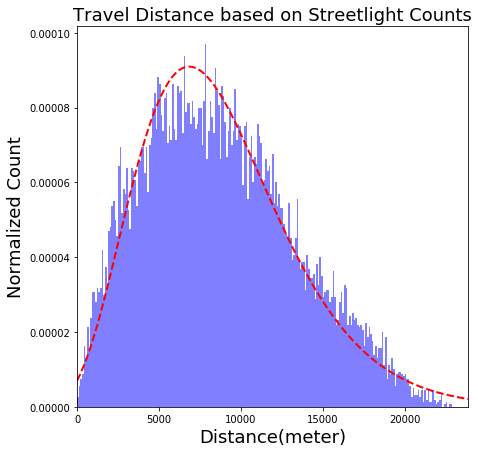

std :  4589.954715045415
mean :  8741.139166125


In [225]:
import pickle
from scipy import stats 
import matplotlib.mlab as mlab

Length_pickle_list = []
for idx in range(0,8):
    pfile = open('file'+str(idx)+'_Ensemble_SL.pkl','rb')
    lengthP = pickle.load(pfile)
    Length_pickle_list.append(lengthP)
from pandas.core.common import flatten
flatLengthList = list(flatten(Length_pickle_list))
bins = np.arange(0, 40000, 100) # fixed bin size
plt.figure(figsize=(7,7))
plt.xlim([0, max(flatLengthList)+1000])
plt.hist(flatLengthList, bins=bins, alpha=0.5, color='blue', normed=True)
plt.title('Travel Distance based on Streetlight Counts',fontsize=18)
plt.xlabel('Distance(meter)',fontsize=18)
plt.ylabel('Normalized Count',fontsize=18)

ag,bg,cg = stats.gamma.fit(Length_pickle_list)
y = stats.gamma.pdf(bins, ag, bg, cg)
plt.plot(bins, y, 'r--', linewidth=2)
# plt.plot(lnspc, pdf_g, label="Norm") # plot it
plt.show()
print("std : ", np.std(flatLengthList))
print("mean : ", np.mean(flatLengthList))

In [95]:
print(np.std(flatLengthList))
print(np.mean(flatLengthList))

4589.954715045415
8741.139166125


/Users/jblee/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:15: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  from ipykernel import kernelapp as app


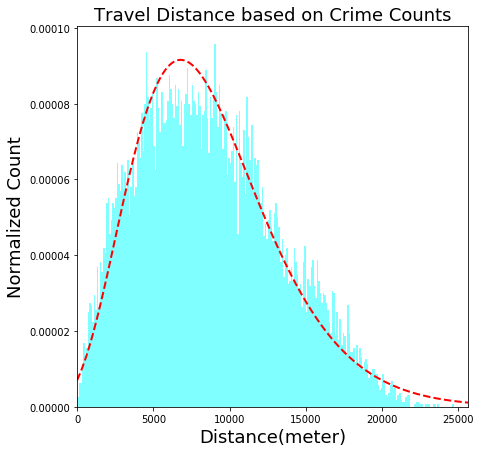

std :  4559.522565429974
mean :  8678.522331625


In [224]:
import pickle
from scipy import stats 
import matplotlib.mlab as mlab

Length_pickle_list = []
for idx in range(0,8):
    pfile = open('file'+str(idx)+'_Ensemble_Crime.pkl','rb')
    lengthP = pickle.load(pfile)
    Length_pickle_list.append(lengthP)
from pandas.core.common import flatten
flatLengthList = list(flatten(Length_pickle_list))
bins = np.arange(0, 40000, 100) # fixed bin size
plt.figure(figsize=(7,7))
plt.xlim([0, max(flatLengthList)+1000])
plt.hist(flatLengthList, bins=bins, alpha=0.5, color='cyan', normed=True)
plt.title('Travel Distance based on Crime Counts',fontsize=18)
plt.xlabel('Distance(meter)',fontsize=18)
plt.ylabel('Normalized Count',fontsize=18)

ag,bg,cg = stats.gamma.fit(Length_pickle_list)
y = stats.gamma.pdf(bins, ag, bg, cg)
plt.plot(bins, y, 'r--', linewidth=2)
# plt.plot(lnspc, pdf_g, label="Norm") # plot it
plt.show()
print("std : ", np.std(flatLengthList))
print("mean : ", np.mean(flatLengthList))

/Users/jblee/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:15: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  from ipykernel import kernelapp as app


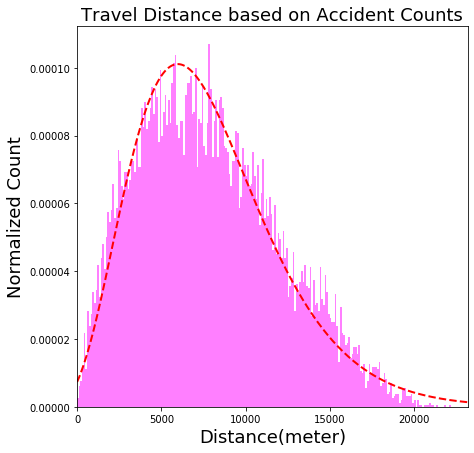

std :  4162.793325403542
mean :  7829.6899088125


In [223]:
import pickle
from scipy import stats 
import matplotlib.mlab as mlab

Length_pickle_list = []
for idx in range(0,8):
    pfile = open('file'+str(idx)+'_Ensemble_Acci.pkl','rb')
    lengthP = pickle.load(pfile)
    Length_pickle_list.append(lengthP)
from pandas.core.common import flatten
flatLengthList = list(flatten(Length_pickle_list))
bins = np.arange(0, 40000, 100) # fixed bin size
plt.figure(figsize=(7,7))
plt.xlim([0, max(flatLengthList)+1000])
plt.hist(flatLengthList, bins=bins, alpha=0.5, color='magenta', normed=True)
plt.title('Travel Distance based on Accident Counts',fontsize=18)
plt.xlabel('Distance(meter)',fontsize=18)
plt.ylabel('Normalized Count',fontsize=18)

ag,bg,cg = stats.gamma.fit(Length_pickle_list)
y = stats.gamma.pdf(bins, ag, bg, cg)
plt.plot(bins, y, 'r--', linewidth=2)
# plt.plot(lnspc, pdf_g, label="Norm") # plot it
plt.show()
print("std : ", np.std(flatLengthList))
print("mean : ", np.mean(flatLengthList))

In [156]:
np.sqrt((4162.8)**2+(4559.5)**2+(4590)**2)

7693.2466546965725

In [163]:
(4054.323219089784/10)/7693 

0.05270145871688267

In [228]:
for u, v, d in Boston_G.edges(data=True):
    optLength = 0.30198019802*(d['length_PedAcci']+d['length_Crime']+d['length_SL_density'])
    if optLength > (1.4*d['length']):
        d['length_Optimized'] = d['length']
    else:
        d['length_Optimized'] = optLength

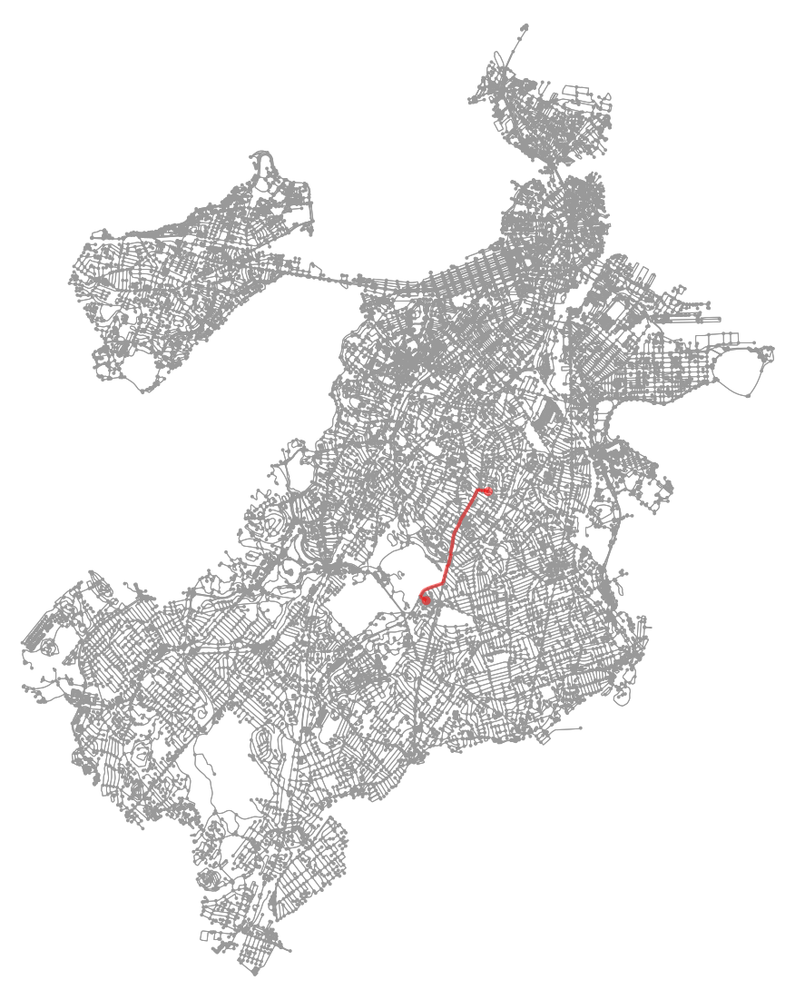

total Dist 2897.6249999999995    total Street Light Count 71    total Ped Accident Count 14    total crime 86


In [233]:
rnode1 = np.random.choice(Boston_G.nodes())
rnode2 = np.random.choice(Boston_G.nodes())

dijik_route = nx.dijkstra_path(Boston_G, rnode1, rnode2, weight='length_Optimized')
ox.plot_graph_route(Boston_G, dijik_route, fig_height=20, fig_width=20)

u = dijik_route[0]
totalDist=0
totalSL=0
totalAcci=0
totalCrim=0
for v in dijik_route[1:]:
    totalDist += Boston_G[u][v][0]['length']
    totalSL += Boston_G[u][v][0]['SL_Count']
    totalAcci += Boston_G[u][v][0]['PED_Acci']
    totalCrim += Boston_G[u][v][0]['Crime_Count']    
    u = v
print("total Dist", totalDist, "   total Street Light Count", totalSL, "   total Ped Accident Count", totalAcci, "   total crime", totalCrim)

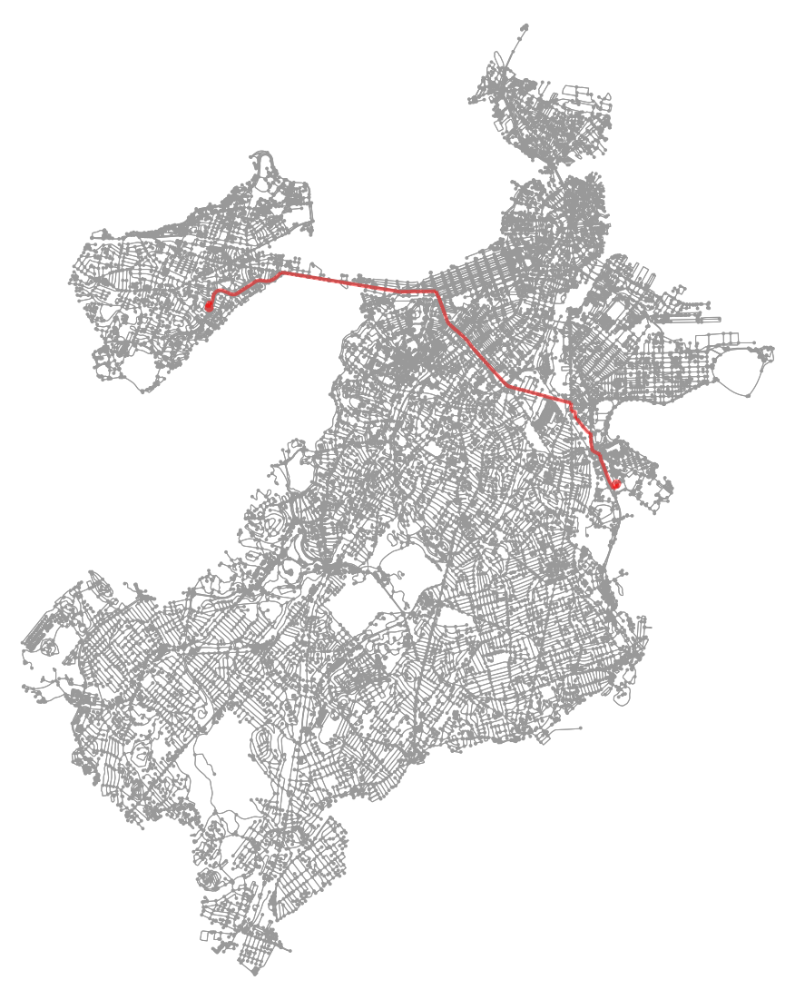

total Dist 10947.608999999999    total Street Light Count 212    total Ped Accident Count 41    total crime 458


In [232]:
dijik_route = nx.dijkstra_path(Boston_G, rnode1, rnode2, weight='length')
ox.plot_graph_route(Boston_G, dijik_route, fig_height=20, fig_width=20)

u = dijik_route[0]
totalDist=0
totalSL=0
totalAcci=0
totalCrim=0
for v in dijik_route[1:]:
    totalDist += Boston_G[u][v][0]['length']
    totalSL += Boston_G[u][v][0]['SL_Count']
    totalAcci += Boston_G[u][v][0]['PED_Acci']
    totalCrim += Boston_G[u][v][0]['Crime_Count']    
    u = v
print("total Dist", totalDist, "   total Street Light Count", totalSL, "   total Ped Accident Count", totalAcci, "   total crime", totalCrim)

In [220]:
nx.write_gpickle(Boston_G, "BostonGraph_Final.gpickle")

/Users/jblee/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:45: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.


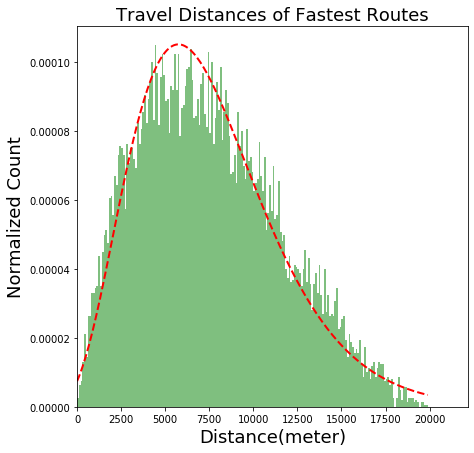

std :  3998.6949521425754
f mean len:  7530.2921665625
o mean len:  7743.349456624999
f mean SL:  173.3455625
o mean SL:  192.42225
f mean ACCI:  313.08925
o mean ACCI:  177.6160625
f mean CRIME:  24.308
omean CRIME:  14.356625


In [227]:
import pickle
from scipy import stats 
import matplotlib.mlab as mlab

pickle_list = []
for idx in range(0,8):
    pfile = open('file'+str(idx)+'_Ensemble_Validation.pkl','rb')
    lengthP = pickle.load(pfile)
    pickle_list.append(lengthP)
from pandas.core.common import flatten

f_length = []
o_length = []
f_SL_Count = []
o_SL_Count = []
f_PED_Acci = []
o_PED_Acci = []
f_Crime_Count = []
o_Crime_Count = []


for li in pickle_list:
    f_length.append(li['f_length'])
    o_length.append(li['o_length'])
    f_SL_Count.append(li['f_SL_Count'])
    o_SL_Count.append(li['o_SL_Count'])    
    f_PED_Acci.append(li['f_PED_Acci'])
    o_PED_Acci.append(li['o_PED_Acci'])    
    f_Crime_Count.append(li['f_Crime_Count'])
    o_Crime_Count.append(li['o_Crime_Count'])    
    
flat_f_length = list(flatten(f_length))
flat_o_length = list(flatten(o_length))
flat_f_SL_Count = list(flatten(f_SL_Count))
flat_o_SL_Count = list(flatten(o_SL_Count))
flat_f_PED_Acci = list(flatten(f_PED_Acci))
flat_o_PED_Acci = list(flatten(o_PED_Acci))
flat_f_Crime_Count = list(flatten(f_Crime_Count))
flat_o_Crime_Count = list(flatten(o_Crime_Count))
    

bins = np.arange(0, 20000, 100) # fixed bin size
plt.figure(figsize=(7,7))
plt.xlim([0, max(flat_f_length)+1000])
plt.hist(flat_f_length, bins=bins, alpha=0.5, color='green', normed=True)
plt.title('Travel Distances of Fastest Routes',fontsize=18)
plt.xlabel('Distance(meter)',fontsize=18)
plt.ylabel('Normalized Count',fontsize=18)

ag,bg,cg = stats.gamma.fit(flat_f_length)
y = stats.gamma.pdf(bins, ag, bg, cg)
plt.plot(bins, y, 'r--', linewidth=2)
plt.show()
print("std : ", np.std(flat_f_length))
print("f mean len: ", np.mean(flat_f_length))
print("o mean len: ", np.mean(flat_o_length))
print("f mean SL: ", np.mean(flat_f_SL_Count))
print("o mean SL: ", np.mean(flat_o_SL_Count))
print("f mean ACCI: ", np.mean(flat_f_PED_Acci))
print("o mean ACCI: ", np.mean(flat_o_PED_Acci))
print("f mean CRIME: ", np.mean(flat_f_Crime_Count))
print("omean CRIME: ", np.mean(flat_o_Crime_Count))



/Users/jblee/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:4: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  after removing the cwd from sys.path.


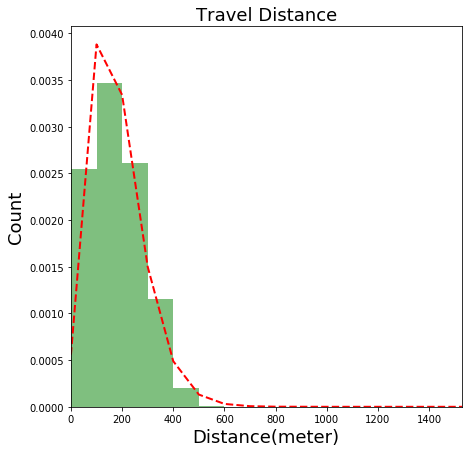

std :  101.90005930810881
mean :  179.2360625


In [199]:
bins = np.arange(0, 20000, 100) # fixed bin size
plt.figure(figsize=(7,7))
plt.xlim([0, max(flat_o_SL_Count)+1000])
plt.hist(flat_o_SL_Count, bins=bins, alpha=0.5, color='green', normed=True)
plt.title('Travel Distance',fontsize=18)
plt.xlabel('Distance(meter)',fontsize=18)
plt.ylabel('Count',fontsize=18)

ag,bg,cg = stats.gamma.fit(flat_o_SL_Count)
y = stats.gamma.pdf(bins, ag, bg, cg)
plt.plot(bins, y, 'r--', linewidth=2)
plt.show()
print("std : ", np.std(flat_o_SL_Count))
print("mean : ", np.mean(flat_o_SL_Count))